# Carregar bibliotecas e configurar ambiente

## Importar Bibliotecas

In [98]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.model_selection import cross_val_predict, train_test_split, RandomizedSearchCV

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

import time
from scipy.stats import ks_2samp

from sklearn. feature_selection import SelectKBest
from sklearn. feature_selection import f_regression

In [99]:
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

## Configurar Ambiente

In [100]:
# Configuração do ambiente

# Mostra todas as colunas na visualização
pd.set_option('display.max_columns', None)

# Configurando Para Mostrar 2 Casas Decimais
pd.set_option('display.float_format', '{:.6f}'.format)

In [101]:
# pd.reset_option('^display.', silent=True)

# Carregar Dados

Os dados (train e test) fornecidos na competição necessitavam de ajuste de cabeçalho. Os dados disponibilizados nesse repositório já estão com cabeçalho ajustado por meio da função na célula abaixo.

Além desse ajuste, devido ao tamanho do dado train.csv original, foi necessário dividi-lo em dois arquivos, train1.csv e train2.csv.

In [102]:
# # Função para corrigir colunas e índice
# def correction_columns(data):

#     # Retirar as duas primeiras linhas referentes ao cabeçalho
#     data= data.drop([0,1])

#     # Alterar o nome da coluna 1 para "id"
#     new_name_columns = list(data.columns)
#     new_name_columns[0] = 'id'
#     data.columns = new_name_columns

#     # Tornar coluna 'id' com index
#     data = data.set_index('id')

#     return data

In [103]:
# Carregar dados de treino
df1=pd.read_csv('train1.csv', index_col='id')
df2=pd.read_csv('train2.csv', index_col='id')
# Concatenar os dados de treino df1 e df2
df = pd.concat([df1, df2], axis=0, ignore_index=False)

# Carregar Dados de Teste
df_teste=pd.read_csv('test.csv', index_col='id')

# Os dados não serão utilizados no treino.
# Serão avaliados os possíveis tratamentos para evitar problemas ao submeter a solução no Kaggle.

# Análise Exploratória dos Dados (EDA)

## Formatar Dados

In [104]:
# Formatando as colunas
def trat_columns(data):

    # Formatar a coluna "Timestamp" como tipo de dado datetime com data e hora
    data['Timestamp'] = pd.to_datetime(data['Timestamp'],format='%Y-%m-%d %H:%M:%S')

    # Formatar coluna em dados tipo float
    data[df_columns_num] = data[df_columns_num].astype(float)
    

    return data

In [105]:
df.head()

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,training,target_feature
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2017-10-01 00:00:00,9.112875,9.197829,8.795919,8.749384,7.684954,1.104222,1.096619,0.999588,1.192191,1.290311,166.338806,171.097855,166.757828,167.492020,167.577591,171.462280,174.632751,164.435440,159.976288,170.339966,0.000000,0.000000,0.406891,0.000000,0.000000,-5.900865,-4.050556,1.262740,6.251606,-5.537934,1484.768311,1386.177734,1277.073242,1129.367310,850.010681,12.900000,12.950000,13.300000,12.497500,13.830000,1793.296997,1780.729370,1768.215088,1733.296875,1603.749390,0.183487,0.135490,0.001053,0.000000,0.000000,True,8.602844
1,2017-10-01 00:10:00,8.319863,9.350296,8.762059,8.652318,7.421576,1.207655,0.916610,0.956899,1.491337,1.180193,170.765564,171.526352,170.173492,167.364090,167.277069,171.462280,174.632751,164.556808,159.976288,170.339966,0.000000,0.000000,0.501263,0.000000,0.000000,-2.489722,-2.281498,4.499787,4.683475,-1.276070,1261.810547,1488.690918,1327.401611,1253.022217,810.973633,12.900000,12.934999,13.300000,12.500000,13.802500,1755.418701,1793.579346,1770.806885,1737.218262,1572.769409,0.051998,0.086999,0.095998,0.060500,0.000000,True,8.125226
2,2017-10-01 00:20:00,8.799176,8.510402,9.533566,8.166586,7.797040,1.124029,0.992841,1.343180,1.638308,1.342744,171.255630,178.154541,175.372223,172.822983,172.078690,171.462280,174.632751,177.212936,175.259628,170.339966,0.000000,0.000000,5.334985,6.923416,0.000000,3.080552,1.465534,-2.817413,-2.942854,4.030419,1386.666992,1332.805786,1403.717163,1125.091553,1032.624268,12.934999,12.920000,13.300000,12.500000,13.802500,1764.660522,1757.190918,1766.002319,1698.699219,1655.049316,0.168988,0.056997,0.087998,0.009000,0.016000,True,7.551986
3,2017-10-01 00:30:00,8.392921,8.825861,8.990985,7.877046,7.750090,1.219647,1.218454,0.970566,1.633695,0.876658,178.718704,182.122635,177.278168,174.964172,174.161850,171.462280,174.632751,179.561615,178.634888,170.339966,0.000000,0.000000,0.000000,0.000000,0.000000,7.402174,5.603941,-3.801713,-6.978256,7.388354,1205.734619,1349.208130,1370.205933,974.294189,977.885925,13.045000,12.910000,13.300000,12.500000,13.845000,1750.111084,1776.216064,1783.569824,1661.264526,1678.571777,0.084492,0.133995,0.017500,0.000000,0.000000,True,7.912114
4,2017-10-01 00:40:00,8.366286,9.238553,9.335627,8.429132,8.657709,1.448154,1.001974,1.007573,1.798111,1.367105,177.742310,178.051819,175.983154,170.079620,175.784790,171.462280,174.632751,179.561615,178.634888,170.339966,0.000000,0.000000,0.000000,0.000000,0.000000,5.735346,2.474137,-5.426433,-4.232094,5.354973,1172.053711,1449.081909,1551.367798,1246.7531

In [106]:
df_teste.head()

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016,2017-10-15 00:00:00,9.410975,8.906447,8.516111,6.889416,7.907523,0.827754,0.760050,0.453254,0.971320,0.582650,178.745422,179.390518,175.677658,172.028931,172.898300,168.169586,175.730316,179.561615,166.561676,175.827789,0.000000,0.000000,0.000000,0.000000,0.000000,9.813562,1.023784,-4.427249,9.815627,-1.874476,1504.308472,1255.058228,1082.256226,700.878479,902.565918,13.940000,13.590000,13.977500,13.155000,14.235000,1794.619385,1792.041626,1737.601440,1528.941040,1653.416992,0.007500,0.000000,0.000000,0.000000,0.000000
2017,2017-10-15 00:10:00,9.313236,9.432560,9.133708,6.192321,8.215790,1.074361,0.898349,0.532972,0.964311,0.389154,180.858505,181.232010,177.872070,179.674606,178.441376,175.088364,175.730316,179.561615,170.273499,175.827789,4.526708,0.000000,0.000000,3.752413,0.000000,3.500461,5.471499,-4.201434,11.366840,1.854400,1587.863037,1594.518921,1477.232178,565.278809,1039.823242,13.750000,13.470000,13.912499,12.990000,14.179999,1794.245117,1795.033936,1789.427734,1420.354858,1730.603027,0.000000,0.000000,0.000000,0.000000,0.000000
2018,2017-10-15 00:20:00,9.726503,9.917058,9.376414,6.014155,8.579673,0.937988,0.602810,0.519404,0.720272,0.614934,181.465973,185.406296,179.665298,187.005249,179.462784,178.047668,176.493790,179.561615,174.244629,175.827789,0.000000,2.885159,0.000000,0.000000,0.000000,5.362266,8.677570,0.023239,8.275834,3.696539,1576.585693,1593.103882,1502.943237,505.548157,1122.550903,13.485000,13.235000,13.730000,12.907499,14.007500,1796.775269,1795.225830,1789.707031,1382.760376,1764.003418,0.031500,0.000000,0.000000,0.000000,0.000000
2019,2017-10-15 00:30:00,8.560906,9.248798,8.932862,5.859115,8.805655,0.596583,0.797295,0.686779,0.861738,0.532247,183.514374,181.969666,182.748886,181.574265,180.827240,178.047668,188.901093,179.561615,174.244629,175.827789,0.000000,0.000000,0.000000,0.000000,0.000000,6.853310,-6.322511,3.070251,10.137497,4.278877,1215.635864,1376.486206,1323.369751,495.390717,1218.303589,13.227500,12.990000,13.332500,12.797501,13.822500,1776.527100,1787.640747,1790.412354,1374.962036,1789.303711,0.000000,0.000000,0.000000,0.000000,0.000000
2020,2017-10-15 00:40:00,7.590319,8.011730,8.251603,5.712709,7.929028,0.559754,0.656621,0.609038,0.825590,0.576971,188.070450,185.820969,189.125854,192.836639,185.543381,184.931595,188.901093,179.561615,174.244629,177.372955,5.829193,0.000000,0.000000,0.000000,4.006085,2.999528,-4.212601,9.962421,20.578293,7.823682,937.587585,1020.575012,1073.293457,465.387451,955.449158,13.117500,12.797501,13.142500,12.730000,13.610001,1673.56494

In [107]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 130608 entries, 0 to 195119
Data columns (total 53 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   Timestamp                                   130608 non-null  object 
 1   Wind speed (m/s)                            129454 non-null  float64
 2   Wind speed (m/s).1                          100652 non-null  float64
 3   Wind speed (m/s).2                          129444 non-null  float64
 4   Wind speed (m/s).3                          129256 non-null  float64
 5   Wind speed (m/s).4                          129366 non-null  float64
 6   Wind speed, Standard deviation (m/s)        129200 non-null  float64
 7   Wind speed, Standard deviation (m/s).1      100398 non-null  float64
 8   Wind speed, Standard deviation (m/s).2      129190 non-null  float64
 9   Wind speed, Standard deviation (m/s).3      129003 non-null  float64
 

In [108]:
df_teste.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 64512 entries, 2016 to 193535
Data columns (total 51 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   Timestamp                                   64512 non-null  object 
 1   Wind speed (m/s)                            63265 non-null  float64
 2   Wind speed (m/s).1                          48825 non-null  float64
 3   Wind speed (m/s).2                          63280 non-null  float64
 4   Wind speed (m/s).3                          63256 non-null  float64
 5   Wind speed (m/s).4                          63292 non-null  float64
 6   Wind speed, Standard deviation (m/s)        63265 non-null  float64
 7   Wind speed, Standard deviation (m/s).1      48825 non-null  float64
 8   Wind speed, Standard deviation (m/s).2      63280 non-null  float64
 9   Wind speed, Standard deviation (m/s).3      63256 non-null  float64
 10  Wind s

In [109]:
# Tratanto e Classificando as colunas

# Formatando a colinas training para categoria
df['training'] = df['training'].astype('bool')

# Coluna target
target = ['target_feature']
# Formatando a coluna de target
df['target_feature'] = df['target_feature'].astype(float)

# Colunas temporais
df_columns_temp = ['Timestamp']

# Colunas numéricas (float) do dataframe
df_columns_num = [item for item in list(df.columns) if item not in set(df_columns_temp + target + ['training'])]

list_angle = ['Wind direction (°)',
       'Wind direction (°).1', 'Wind direction (°).2', 'Wind direction (°).3',
       'Wind direction (°).4', 'Nacelle position (°)',
       'Nacelle position (°).1', 'Nacelle position (°).2',
       'Nacelle position (°).3', 'Nacelle position (°).4',
       'Nacelle position, Standard deviation (°)',
       'Nacelle position, Standard deviation (°).1',
       'Nacelle position, Standard deviation (°).2',
       'Nacelle position, Standard deviation (°).3',
       'Nacelle position, Standard deviation (°).4', 'Vane position 1+2 (°)',
       'Vane position 1+2 (°).1', 'Vane position 1+2 (°).2',
       'Vane position 1+2 (°).3', 'Vane position 1+2 (°).4', 
       'Blade angle (pitch position) A (°)',
       'Blade angle (pitch position) A (°).1',
       'Blade angle (pitch position) A (°).2',
       'Blade angle (pitch position) A (°).3',
       'Blade angle (pitch position) A (°).4']

In [110]:
df = trat_columns(df)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 130608 entries, 0 to 195119
Data columns (total 53 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   Timestamp                                   130608 non-null  datetime64[ns]
 1   Wind speed (m/s)                            129454 non-null  float64       
 2   Wind speed (m/s).1                          100652 non-null  float64       
 3   Wind speed (m/s).2                          129444 non-null  float64       
 4   Wind speed (m/s).3                          129256 non-null  float64       
 5   Wind speed (m/s).4                          129366 non-null  float64       
 6   Wind speed, Standard deviation (m/s)        129200 non-null  float64       
 7   Wind speed, Standard deviation (m/s).1      100398 non-null  float64       
 8   Wind speed, Standard deviation (m/s).2      129190 non-null  float64      

In [111]:
df_teste = trat_columns(df_teste)
df_teste.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 64512 entries, 2016 to 193535
Data columns (total 51 columns):
 #   Column                                      Non-Null Count  Dtype         
---  ------                                      --------------  -----         
 0   Timestamp                                   64512 non-null  datetime64[ns]
 1   Wind speed (m/s)                            63265 non-null  float64       
 2   Wind speed (m/s).1                          48825 non-null  float64       
 3   Wind speed (m/s).2                          63280 non-null  float64       
 4   Wind speed (m/s).3                          63256 non-null  float64       
 5   Wind speed (m/s).4                          63292 non-null  float64       
 6   Wind speed, Standard deviation (m/s)        63265 non-null  float64       
 7   Wind speed, Standard deviation (m/s).1      48825 non-null  float64       
 8   Wind speed, Standard deviation (m/s).2      63280 non-null  float64       
 9   Wi

## Detectar valores nulos

In [112]:
def nan_verification(data):
    # Detectar valores nulos com porcentagens
    # data = df
    count_nan = pd.DataFrame(data.isna().sum(),columns=['Count'])
    count_nan['Perc'] = count_nan['Count']/len(data)*100
    count_nan = count_nan.sort_values(by='Perc', ascending=False)
    return count_nan

#Função para visualização gráfica de valores ausentes
# Criando df com timestamp e quantidade de valores ausentes por linha
def nan_verification_graph(data):
    dist_ausentes_teste = pd.DataFrame({
        'Timestamp': data['Timestamp'],
        'Valores_Ausentes': data.isna().sum(axis=1)
    }, index=data.index)

    plt.figure(figsize=(15,5))
    plt.plot(dist_ausentes_teste.iloc[:,0], dist_ausentes_teste.iloc[:,1])
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel(dist_ausentes_teste.columns[0],fontsize=14)
    plt.ylabel(dist_ausentes_teste.columns[1],fontsize=14)
    plt.title('Distribuição de valores ausentes',fontsize=14)
    #plt.legend()
    plt.show()

### Dados de Treino

In [113]:
print(nan_verification(df))

                                            Count      Perc
Wind speed, Standard deviation (m/s).1      30210 23.130283
Blade angle (pitch position) A (°).1        30197 23.120330
Nacelle ambient temperature (°C).1          30196 23.119564
Vane position 1+2 (°).1                     30196 23.119564
Nacelle position, Standard deviation (°).1  30023 22.987106
Wind speed (m/s).1                          29956 22.935808
Power (kW).1                                29770 22.793397
Nacelle position (°).1                      29769 22.792631
Wind direction (°).1                        29769 22.792631
Generator RPM (RPM).1                       29769 22.792631
Vane position 1+2 (°).4                      1673  1.280932
Nacelle ambient temperature (°C).4           1673  1.280932
Blade angle (pitch position) A (°).4         1672  1.280167
Wind speed, Standard deviation (m/s).3       1605  1.228868
Blade angle (pitch position) A (°).3         1597  1.222743
Vane position 1+2 (°).3                 

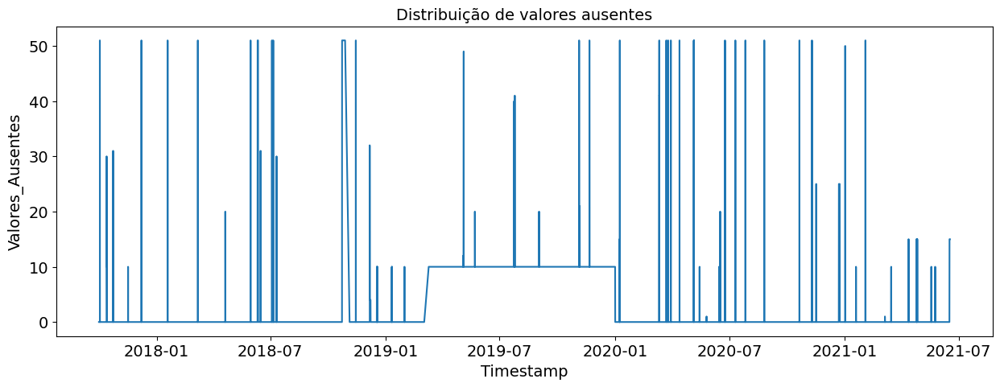

In [114]:
nan_verification_graph(df)

### Dados de Teste

In [115]:
nan_verification(df_teste)

,Count,Perc
Power (kW).1,15688,24.317956
Vane position 1+2 (°).1,15688,24.317956
Nacelle ambient temperature (°C).1,15688,24.317956
Blade angle (pitch position) A (°).1,15688,24.317956
Generator RPM (RPM).1,15688,24.317956
Wind direction (°).1,15687,24.316406
Wind speed (m/s).1,15687,24.316406
Nacelle position (°).1,15687,24.316406
"Wind speed, Standard deviation (m/s).1",15687,24.316406
"Nacelle position, Standard deviation (°).1",15687,24.316406


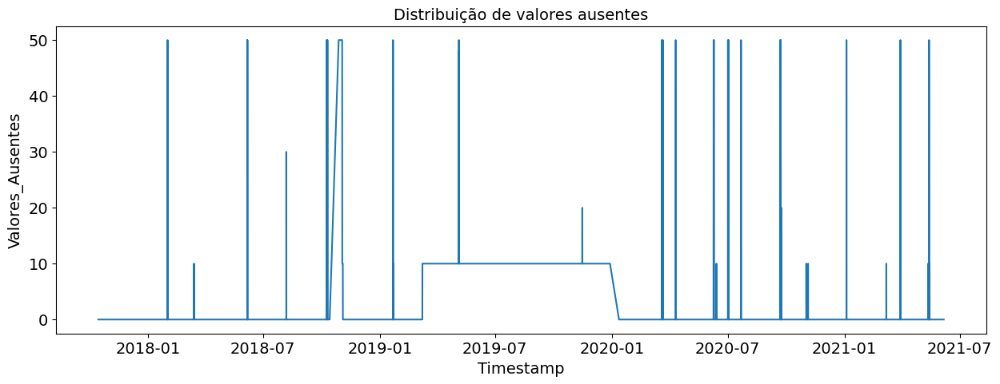

In [116]:
nan_verification_graph(df_teste)

### Dados Target

In [117]:
# Valores ausentes na coluna de target

df['target_feature'].isna().sum()

1195

In [118]:
# Retirando valores ausentes da coluna de target
df = df.dropna(subset=['target_feature'])

In [119]:
len(df)

129413

## Analisar variáveis lógicas e categóricas

In [120]:
# Variáveis categóricas
# df[df_columns_cat].value_counts()

# Não há variáveis categóricas

In [121]:
df['training'].value_counts()

True    129413
Name: training, dtype: int64

In [122]:
# Como essa coluna não tem informação útil, será removida.
df.drop('training', axis=1, inplace=True)

## Analisar variáveis temporais - Visualizações temporais

In [257]:
# Função para criar novas colunas com mês, dia e hora
def tempo_fun(data):
    data['mês'] = data['Timestamp'].dt.month
    data['dia'] = data['Timestamp'].dt.day
    data['hora'] = data['Timestamp'].dt.hour
    return data

In [124]:
# Verificar a duração da pesquisa
print(df['Timestamp'].min())
print(df['Timestamp'].max())
print(df['Timestamp'].max() - df['Timestamp'].min())

2017-10-01 00:00:00
2021-06-16 23:50:00
1354 days 23:50:00


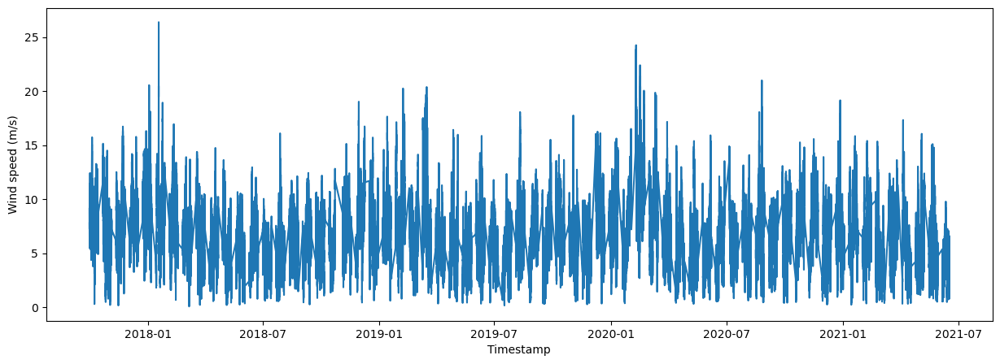

In [125]:
plt.figure(figsize=(15,5))
plt.plot(df.iloc[:,0], df.iloc[:,1])
plt.xlabel(df.columns[0])
plt.ylabel(df.columns[1])
#plt.title('XXXXX')
#plt.legend()
plt.show()

In [ ]:
list_time = ['mês', 'dia', 'hora']
df = tempo_fun(df)

In [127]:
df['mês'].value_counts()

5     12293
12    12232
3     12176
10    11807
1     11496
4     11086
11    11018
2     10761
6      9810
7      9207
9      8784
8      8743
Name: mês, dtype: int64

In [128]:
df['dia'].value_counts()

6     4896
4     4721
27    4608
14    4601
25    4547
16    4464
12    4462
8     4459
17    4320
15    4319
2     4279
10    4248
5     4232
23    4184
1     4176
13    4176
22    4175
26    4175
9     4175
21    4175
3     4172
7     4166
24    4032
28    4032
19    4032
18    4015
11    3932
20    3880
29    3876
30    3436
31    2448
Name: dia, dtype: int64

In [129]:
df['hora'].value_counts()

0     5408
17    5406
22    5406
21    5406
19    5406
18    5406
20    5405
23    5405
1     5399
2     5398
16    5396
7     5396
6     5394
5     5394
3     5394
4     5393
8     5390
9     5381
10    5381
15    5378
13    5370
14    5369
11    5366
12    5366
Name: hora, dtype: int64

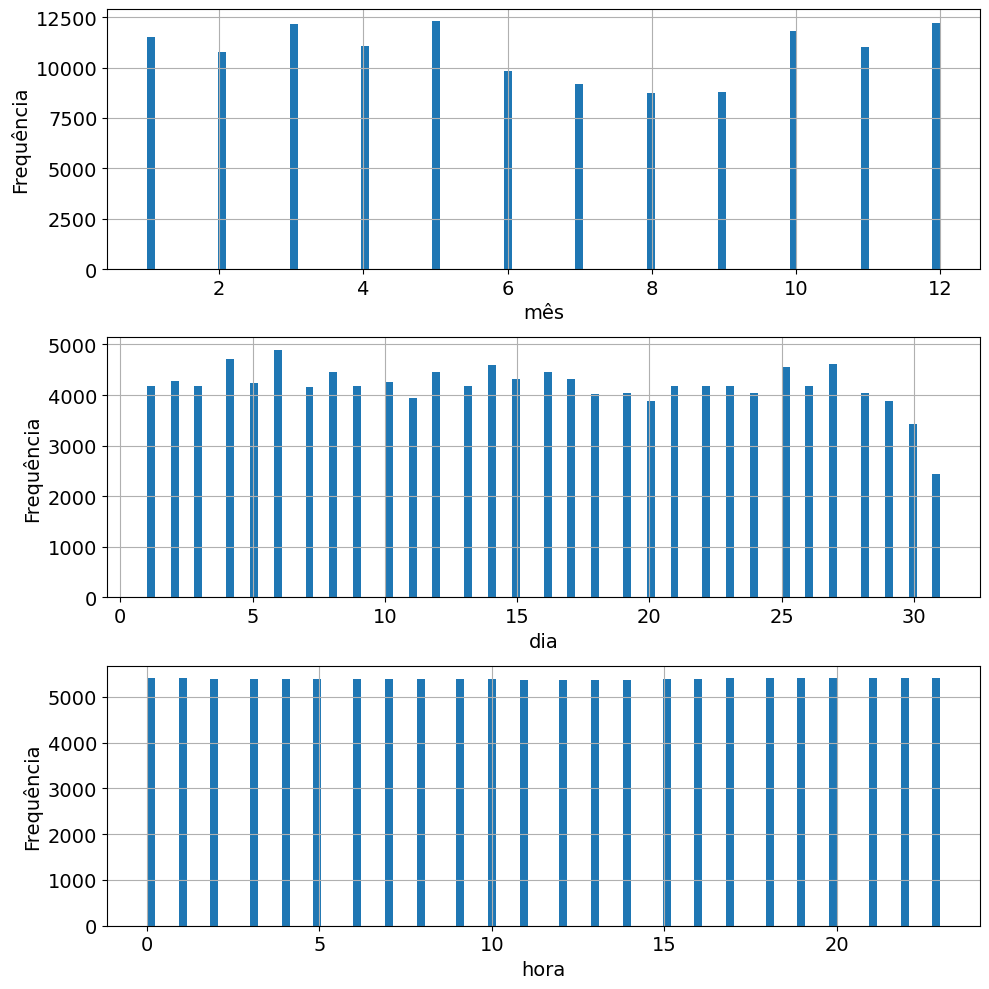

In [130]:
#definição do dataframe e lista de colunas para os gráficos
data = df
lista = list_time


# Controlar a quantidade de colunas para a figura geral
num_colunas = 1  # Defina o número desejado de colunas
num_linhas = -(-len(lista) // num_colunas)  # Calcula o número de linhas necessário


# Gerar histogramas
axes = data[lista].hist(
    bins=100,
    figsize=(10, 10),
    layout=(num_linhas, num_colunas),
    sharex=False,
    sharey=False,
)

# Adicionar rótulo no eixo Y para cada subplot
for ax in axes.flatten():
    #ax.set_ylabel("Frequência")
    ax.set_ylabel("Frequência", fontsize=14)
    ax.set_xlabel(ax.get_title(), fontsize=14)  # Coloca o título como label no eixo X, se quiser
    ax.set_title("")  # Remove o título do gráfico para não ficar duplicado

    ax.tick_params(axis='x', labelsize=14)
    ax.tick_params(axis='y', labelsize=14)

# Exibir o gráfico
plt.tight_layout()  # Ajusta o espaçamento
plt.show()

## Analisar variáveis numéricas

In [123]:
# Função para verificar a distribuição dos dados
def graph_hist(data, lista):
    df_graphic = data[lista].describe()
    for i in lista:

        media = df_graphic.loc['mean',i]
        desvio_padrao = df_graphic.loc['std',i]
        mediana = df_graphic.loc['50%',i]

        # Criar figura e subplots
        fig, axs = plt.subplots(1, 2, figsize=(20, 5))  # 1 linha, 2 colunas

        # Gerar histograma
        axs[0].hist(data[i],bins=50)
        axs[0].axvline(x=media, color='r', linestyle='-', label=f'Média: {media:.2f}')
        axs[0].axvline(x=media + desvio_padrao, color='g', linestyle='--', label=f'Média + Desvio Padrão: {media + desvio_padrao:.2f}')
        axs[0].axvline(x=media - desvio_padrao, color='g', linestyle='--', label=f'Média - Desvio Padrão: {media - desvio_padrao:.2f}')
        axs[0].axvline(x=mediana, color='c', linestyle='-', label=f'Mediana: {mediana:.2f}')

        axs[0].set_xlabel(i, fontsize=16)
        axs[0].set_ylabel('Frequência', fontsize=16)
        axs[0].set_title("Histograma", fontsize=16)
        axs[0].legend(fontsize=14)
        axs[0].tick_params(axis='x', labelsize=16)
        axs[0].tick_params(axis='y', labelsize=16)



        # Gere um boxplot das variáveis do dataset
        axs[1].boxplot(
            data[i].dropna().values , # dataset apenas com as variáveis
            labels = [i],
            whis = 1.5, # lim_inf = Q1 - whis*IQR, lim_sup = Q3 + whis*IQR ou percentis [5,95]
            meanline = True,
            showmeans = True
        )
        #axs[1].set_xlabel(i)
        axs[1].set_title("Box Plot", fontsize=16)
        axs[1].tick_params(axis='x', labelsize=16)
        axs[1].tick_params(axis='y', labelsize=16)


        plt.show()

    return df_graphic

### Target

In [124]:
df[target].describe()

,target_feature
count,129413.000000
mean,6.326829
std,2.856556
min,0.134232
25%,4.288056
50%,6.042259
75%,7.970540
max,23.964783


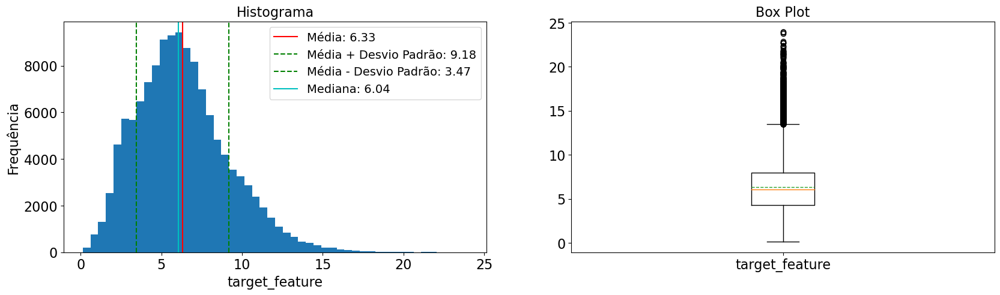

,target_feature
count,129413.000000
mean,6.326829
std,2.856556
min,0.134232
25%,4.288056
50%,6.042259
75%,7.970540
max,23.964783


In [125]:
graph_hist(df, target)

### Features

In [126]:
df_columns_num

['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4',
 'Wind direction (°)',
 'Wind direction (°).1',
 'Wind direction (°).2',
 'Wind direction (°).3',
 'Wind direction (°).4',
 'Nacelle position (°)',
 'Nacelle position (°).1',
 'Nacelle position (°).2',
 'Nacelle position (°).3',
 'Nacelle position (°).4',
 'Nacelle position, Standard deviation (°)',
 'Nacelle position, Standard deviation (°).1',
 'Nacelle position, Standard deviation (°).2',
 'Nacelle position, Standard deviation (°).3',
 'Nacelle position, Standard deviation (°).4',
 'Vane position 1+2 (°)',
 'Vane position 1+2 (°).1',
 'Vane position 1+2 (°).2',
 'Vane position 1+2 (°).3',
 'Vane position 1+2 (°).4',
 'Power (kW)',
 'Power (kW).1',
 'Power (kW).2'

In [127]:
# Analisar estatística básica
df[df_columns_num].describe()

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
count,129382.000000,100616.000000,129376.000000,129193.000000,129302.000000,129128.000000,100362.000000,129122.000000,128940.000000,129048.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,129128.000000,100549.000000,129122.000000,129123.000000,129048.000000,128954.000000,100376.000000,128946.000000,128948.000000,128869.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,128954.000000,100376.000000,128947.000000,128948.000000,128871.000000,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000,128954.000000,100376.000000,128947.000000,128948.000000,128872.000000
mean,6.608867,6.296371,6.474510,6.155607,5.839344,0.899939,0.927601,0.913751,0.946913,0.920016,200.891883,204.339306,200.218570,198.842408,200.943745,201.462011,204.598422,201.385552,199.126978,201.231640,1.531132,1.507561,1.487237,1.675091,1.530398,-0.162059,-0.265637,-0.250251,-0.243005,-0.258501,738.067369,648.686780,678.562457,626.409834,538.522675,10.952922,10.252642,11.123973,10.325013,11.377855,1307.204388,1260.142740,1267.734067,1234.919525,1178.827867,5.627064,6.922372,5.884974,6.166152,9.081670
std,2.900590,2.802894,2.862391,2.829052,2.658436,0.465440,0.473020,0.468463,0.477273,0.461155,91.334672,92.066338,92.113164,91.460799,92.420753,91.570383,92.334797,92.157578,91.629140,92.466120,4.103899,4.185227,4.167695,4.226577,4.257921,13.468707,13.602763,13.711800,14.174983,14.720646,670.141151,647.051602,650.613433,636.718984,596.767972,6.055887,6.082436,6.144751,5.973862,5.973209,483.311888,493.820649,483.827241,484.232705,516.243925,15.713939,17.635964,16.418859,17.020474,21.529018
min,0.061219,0.153413,0.130069,0.129863,0.141900,0.000000,0.000000,0.000000,0.000000,0.000000,0.008851,0.004821,0.008691,0.005421,0.010919,0.013193,0.117982,0.012661,0.075836,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-176.037859,-174.035986,-175.803400,-173.619288,-172.900357,-17.083929,-16.573292,-18.454697,-17.280342,-16.873207,-6.677500,-6.982500,-6.925000,-6.800000,-5.985000,-145.258738,-589.246216,-581.759663,-578.886414,-583.419685,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.566530,4.282855,4.455878,4.117782,3.939976,0.562682,0.577470,0.578617,0.604527,0.583917,146.512433,154.757057,141.838632,144.131506,145.048229,148.412292,154.874634,142.623009,144.610382,146.190857,0.000000,0.000000,0.000000,0.000000,0.000000,-5.062359,-5.343828,-5.207340,-5.201648,-5.660774,169.010899,121.708477,142.168906,117.585521,77.207870,6.567500,5.887500,6.675000,5.965000,7.025000,1027.016144,

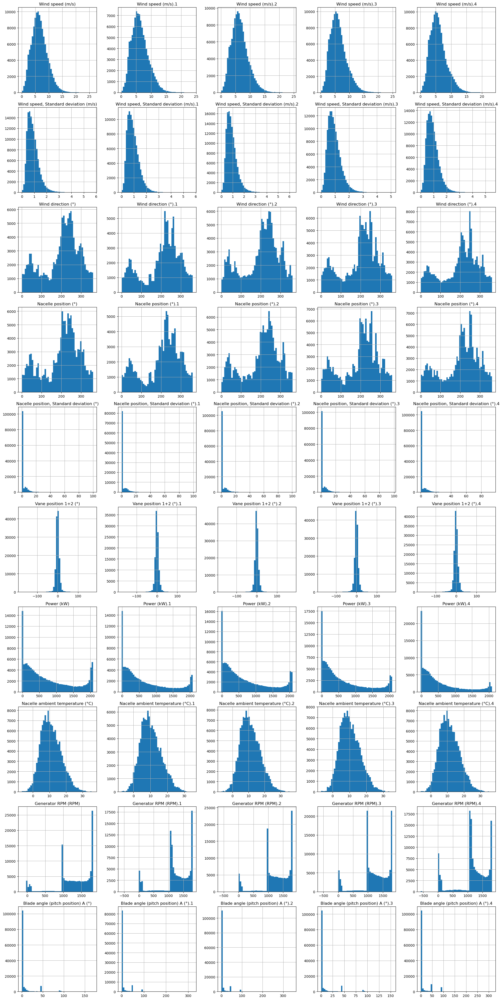

In [128]:
# Controlar a quantidade de colunas para a figura geral
num_colunas = 5  # Defina o número desejado de colunas
num_linhas = -(-len(df_columns_num) // num_colunas)  # Calcula o número de linhas necessário


# Gerar histograma
df[df_columns_num].hist(
    bins=50,
    figsize=(20,40),
    layout=(num_linhas, num_colunas),
    sharex=False,  # Ajuste para compartilhar ou não o eixo x
    sharey=False   # Ajuste para compartilhar ou não o eixo y
)

# Exibir o gráfico
plt.tight_layout()  # Ajusta o espaçamento
plt.show()

#### Wind speed

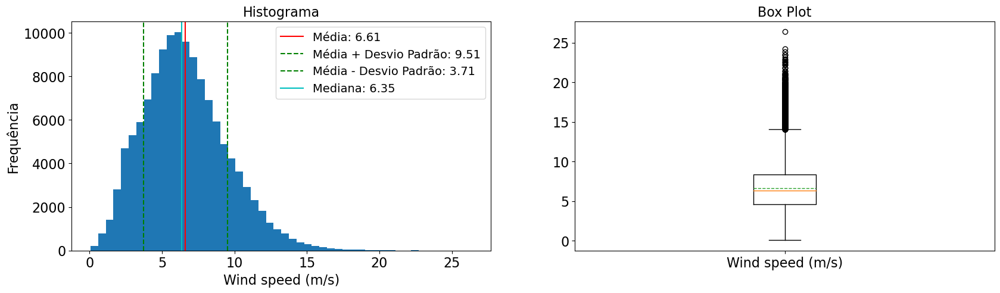

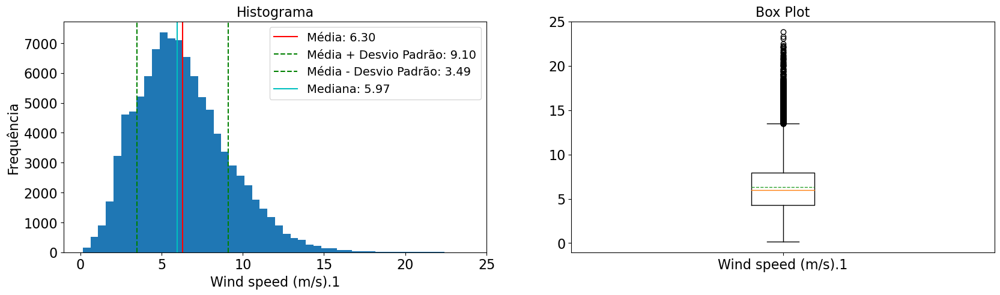

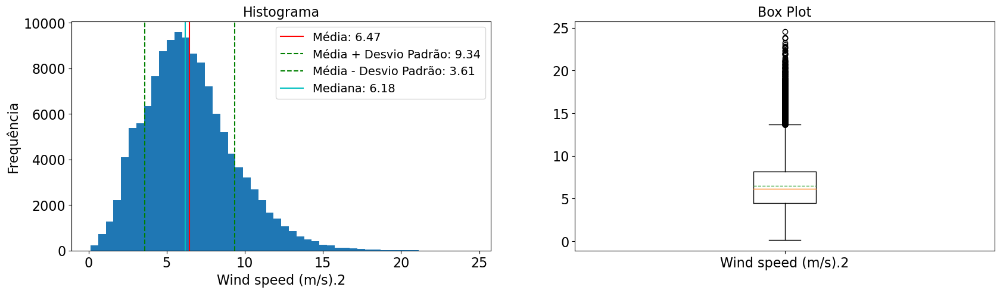

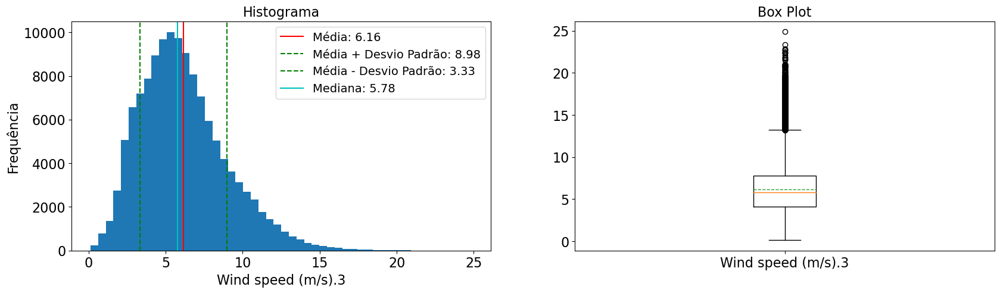

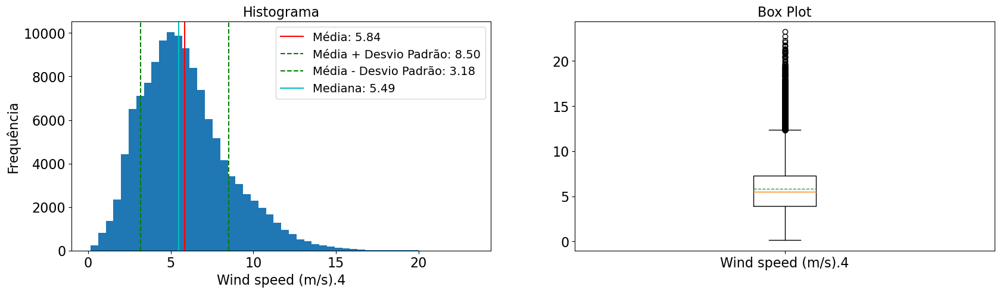

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4
count,129382.000000,100616.000000,129376.000000,129193.000000,129302.000000
mean,6.608867,6.296371,6.474510,6.155607,5.839344
std,2.900590,2.802894,2.862391,2.829052,2.658436
min,0.061219,0.153413,0.130069,0.129863,0.141900
25%,4.566530,4.282855,4.455878,4.117782,3.939976
50%,6.346071,5.971344,6.175519,5.782040,5.489077
75%,8.363530,7.972339,8.137524,7.753229,7.303572
max,26.389881,23.826238,24.538780,24.884069,23.241919


In [129]:
graph_hist(df, df_columns_num[:5])

#### Wind speed, Standard deviation

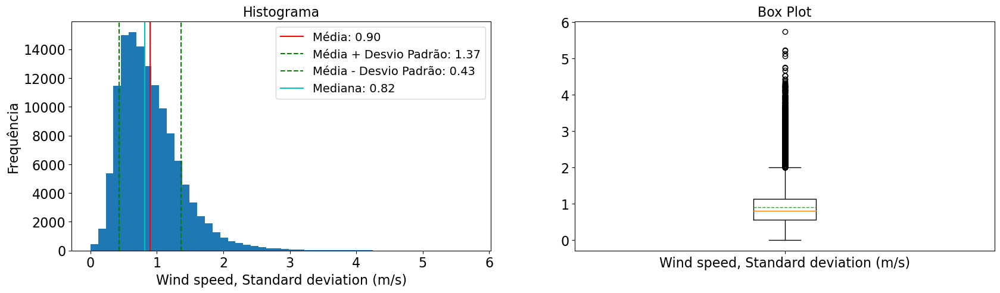

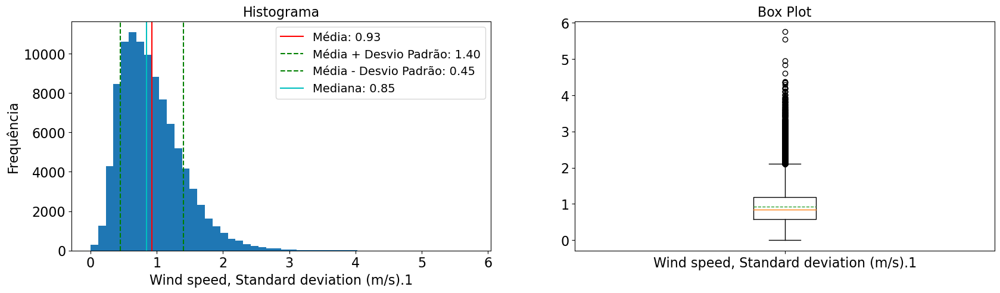

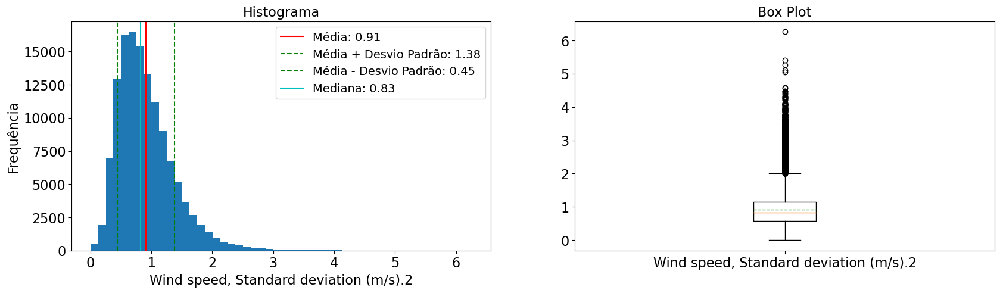

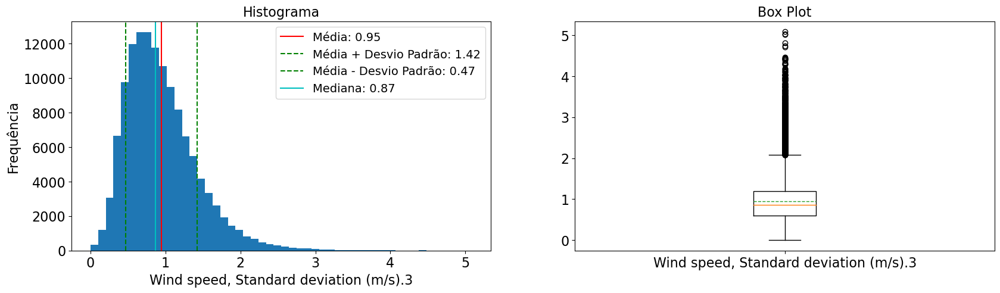

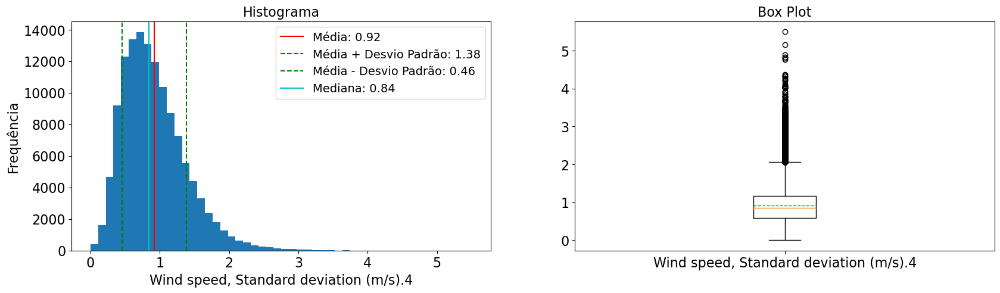

,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4"
count,129128.000000,100362.000000,129122.000000,128940.000000,129048.000000
mean,0.899939,0.927601,0.913751,0.946913,0.920016
std,0.465440,0.473020,0.468463,0.477273,0.461155
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.562682,0.577470,0.578617,0.604527,0.583917
50%,0.815213,0.846295,0.826940,0.866461,0.844984
75%,1.140917,1.187828,1.151579,1.197894,1.173326
max,5.740880,5.757439,6.262961,5.087964,5.503653


In [130]:
graph_hist(df, df_columns_num[5:10])

#### Wind direction

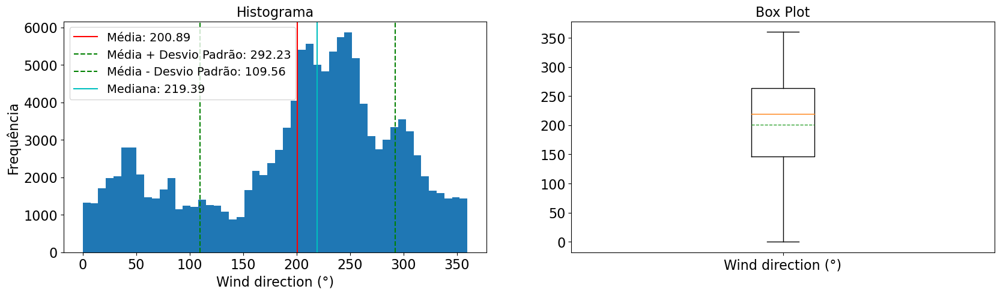

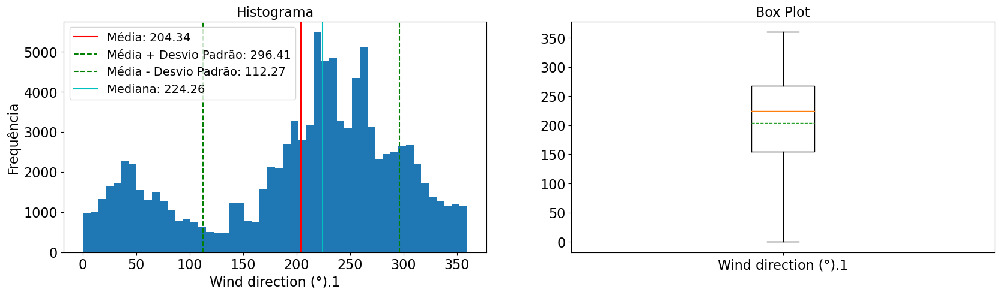

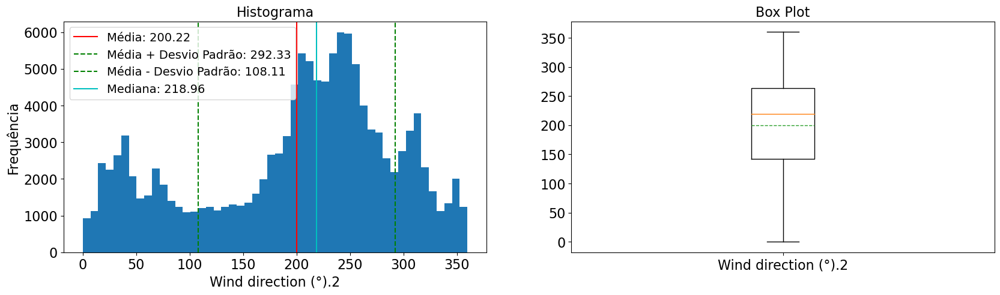

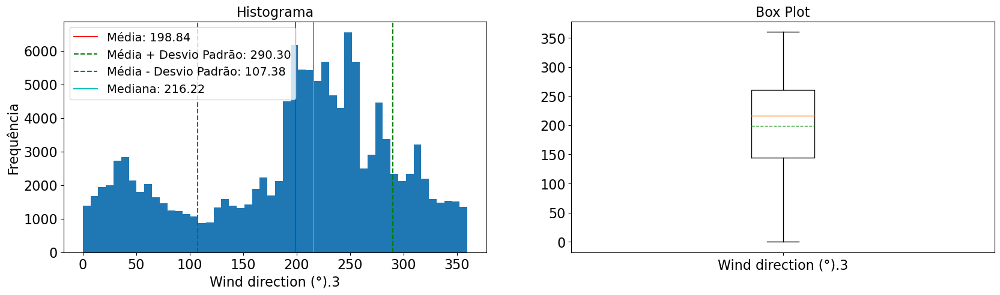

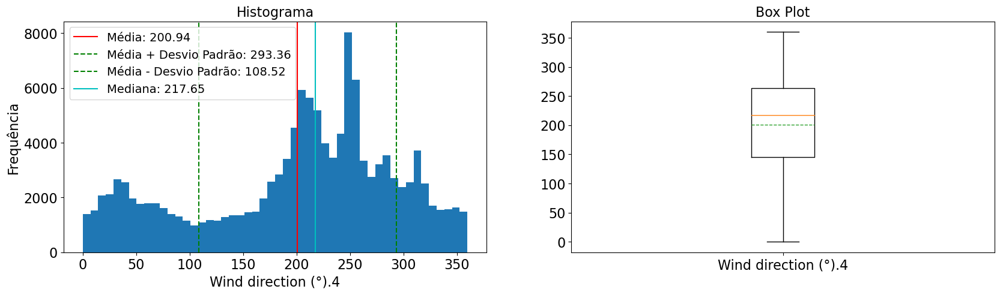

,Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4
count,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000
mean,200.891883,204.339306,200.218570,198.842408,200.943745
std,91.334672,92.066338,92.113164,91.460799,92.420753
min,0.008851,0.004821,0.008691,0.005421,0.010919
25%,146.512433,154.757057,141.838632,144.131506,145.048229
50%,219.386665,224.261734,218.957187,216.219452,217.650032
75%,264.030469,267.452401,263.597778,260.485229,263.829818
max,359.987427,359.991333,359.999420,359.998169,359.995692


In [131]:
graph_hist(df, df_columns_num[10:15])

#### Nacelle position

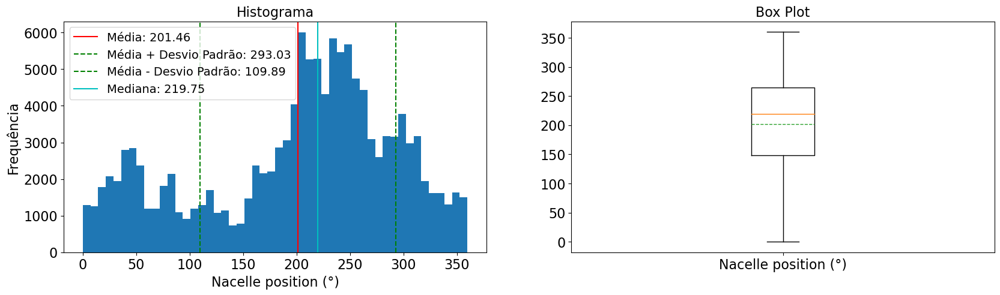

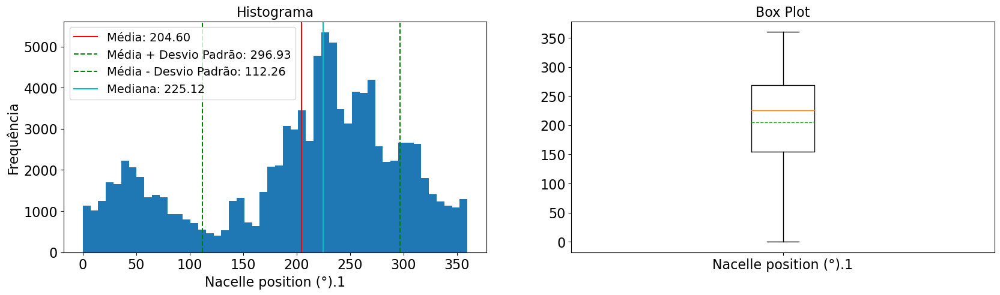

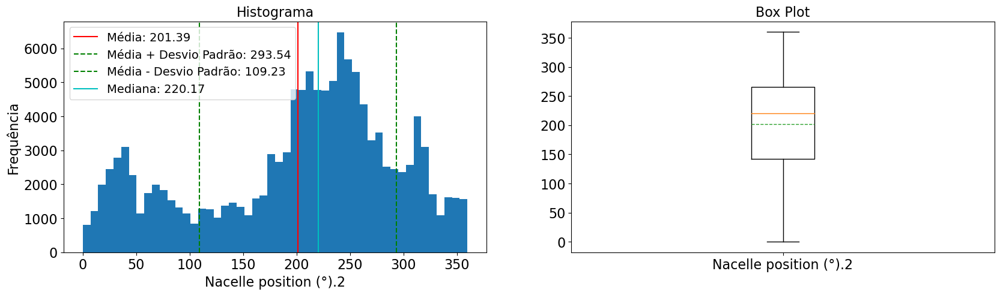

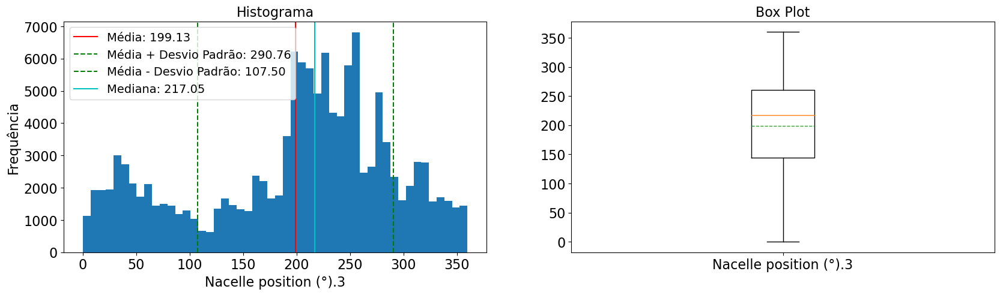

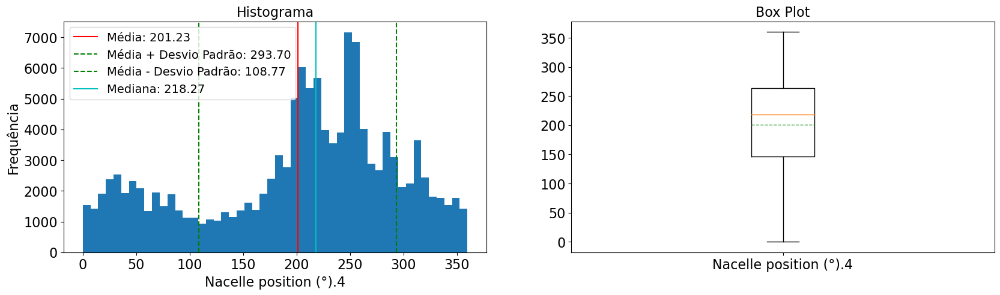

,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4
count,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000
mean,201.462011,204.598422,201.385552,199.126978,201.231640
std,91.570383,92.334797,92.157578,91.629140,92.466120
min,0.013193,0.117982,0.012661,0.075836,0.000000
25%,148.412292,154.874634,142.623009,144.610382,146.190857
50%,219.753021,225.120026,220.171509,217.049103,218.274904
75%,264.753662,269.020874,265.171661,260.038727,263.632355
max,359.968444,359.975311,359.963805,359.980591,359.978851


In [132]:
graph_hist(df, df_columns_num[15:20])

#### Nacelle position, Standard deviation [TESTAR SE FAZ FALTA NO MODELO]

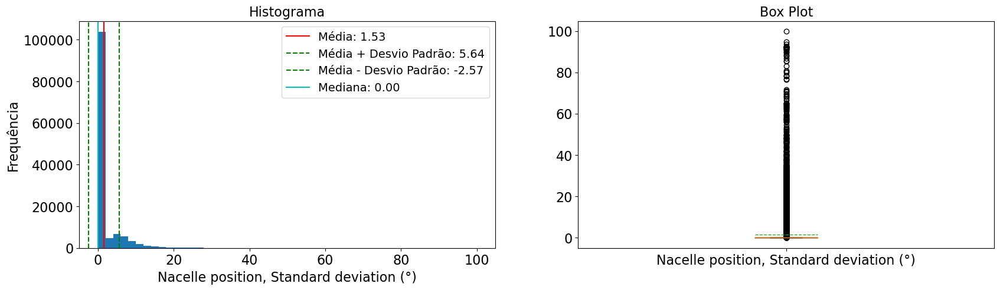

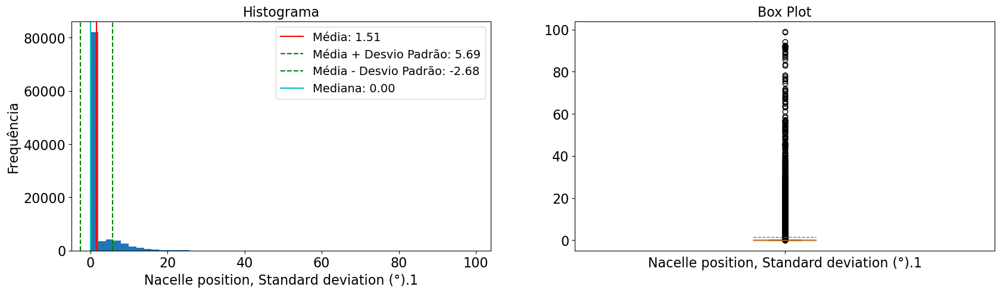

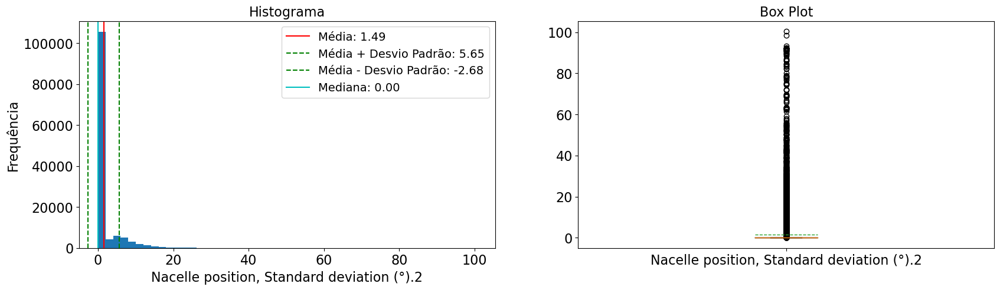

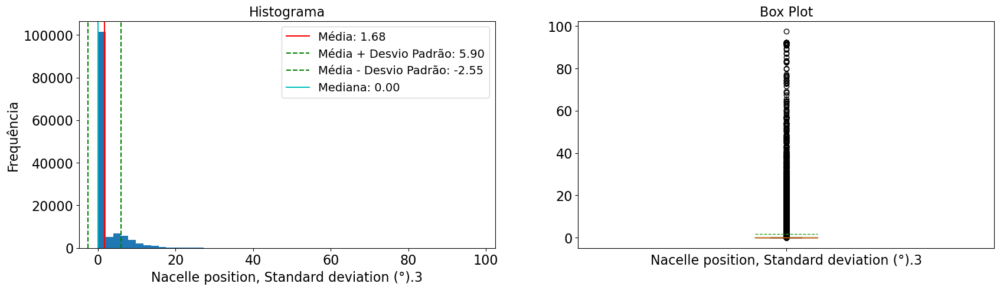

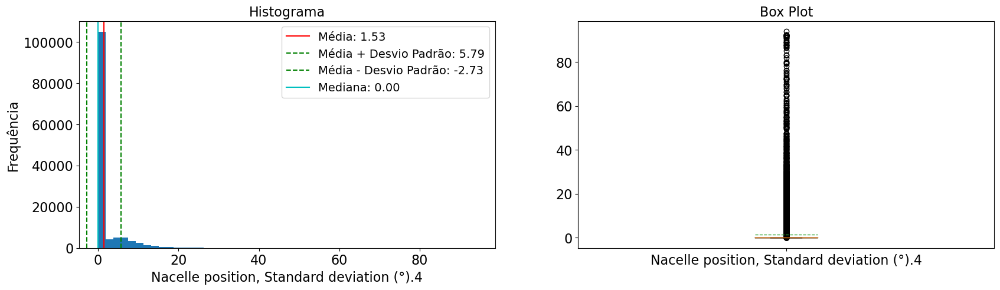

,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4"
count,129128.000000,100549.000000,129122.000000,129123.000000,129048.000000
mean,1.531132,1.507561,1.487237,1.675091,1.530398
std,4.103899,4.185227,4.167695,4.226577,4.257921
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000
max,99.836960,98.999739,100.449900,97.476817,94.020569


In [133]:
graph_hist(df, df_columns_num[20:25])

#### Vane position

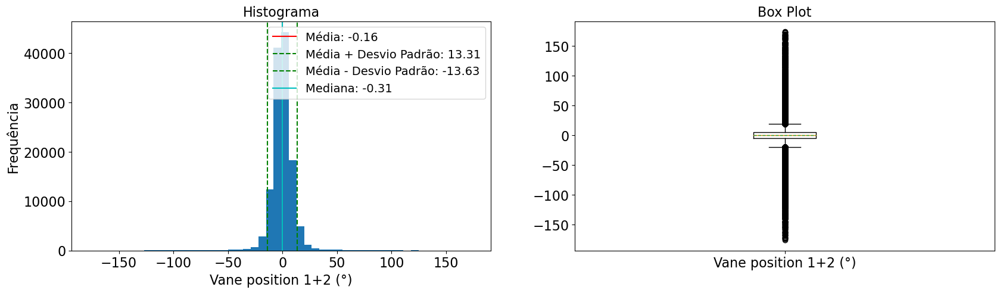

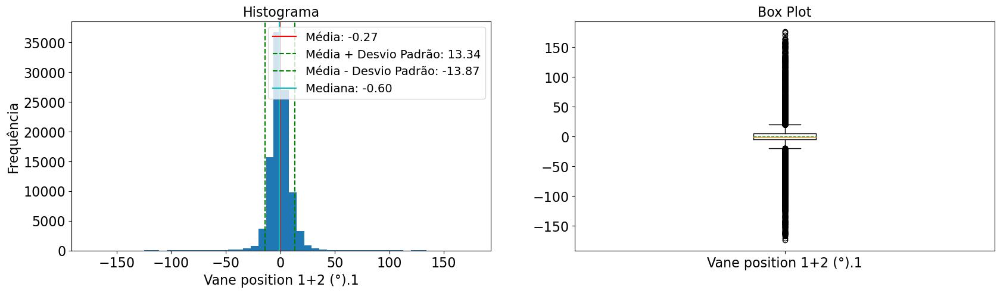

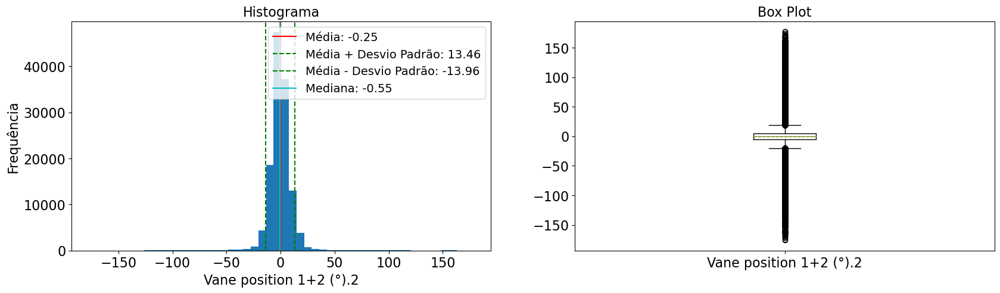

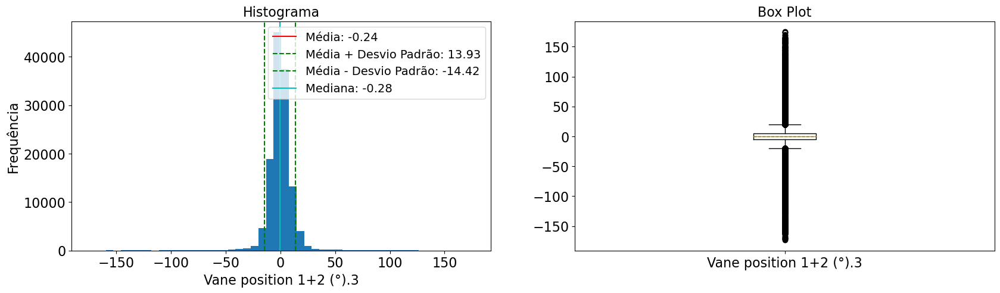

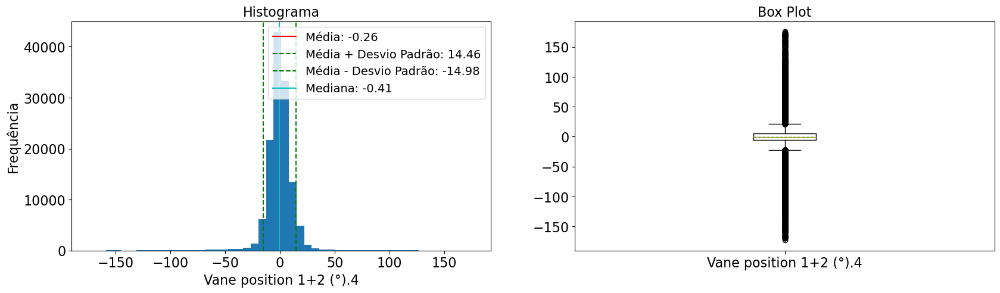

,Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4
count,128954.000000,100376.000000,128946.000000,128948.000000,128869.000000
mean,-0.162059,-0.265637,-0.250251,-0.243005,-0.258501
std,13.468707,13.602763,13.711800,14.174983,14.720646
min,-176.037859,-174.035986,-175.803400,-173.619288,-172.900357
25%,-5.062359,-5.343828,-5.207340,-5.201648,-5.660774
50%,-0.309387,-0.604193,-0.551470,-0.283902,-0.412540
75%,4.636306,4.653078,4.567628,4.799649,5.292134
max,173.811273,175.823624,177.087411,175.053297,175.302655


In [134]:
graph_hist(df, df_columns_num[25:30])

#### Power

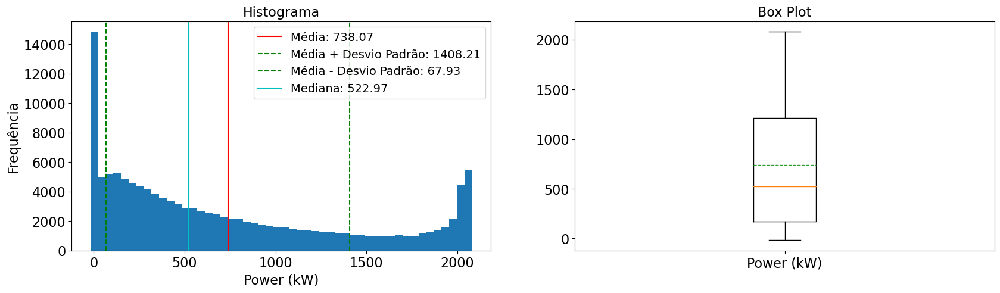

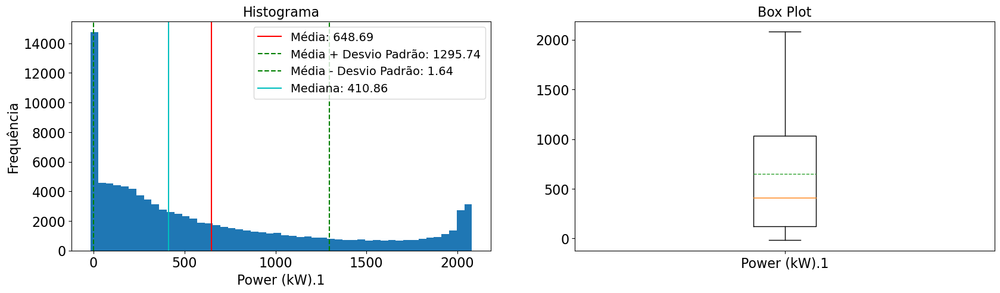

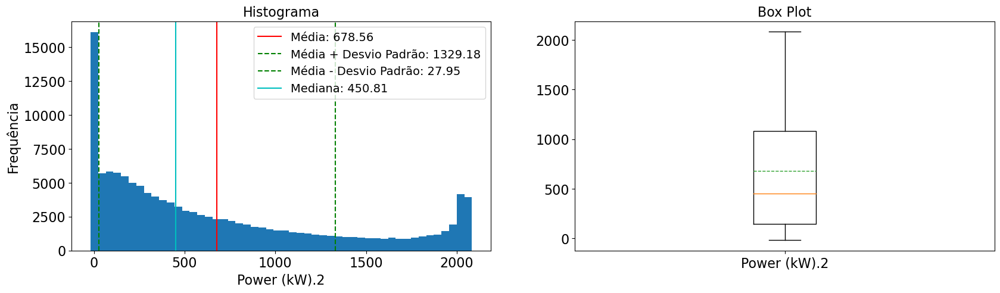

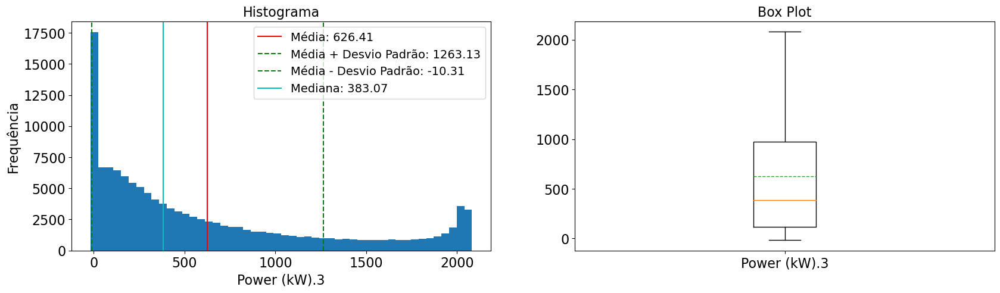

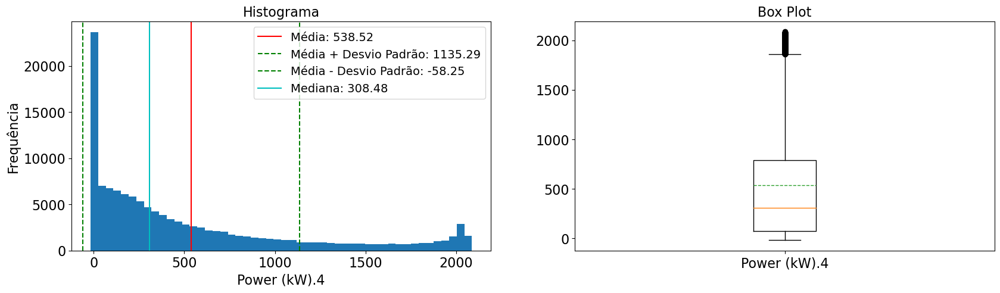

,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4
count,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000
mean,738.067369,648.686780,678.562457,626.409834,538.522675
std,670.141151,647.051602,650.613433,636.718984,596.767972
min,-17.083929,-16.573292,-18.454697,-17.280342,-16.873207
25%,169.010899,121.708477,142.168906,117.585521,77.207870
50%,522.968280,410.855545,450.805361,383.070744,308.484328
75%,1210.498455,1030.276802,1079.066146,974.694284,791.426328
max,2080.385461,2079.870593,2083.431885,2081.809985,2086.926514


In [135]:
graph_hist(df, df_columns_num[30:35])

#### Nacelle ambient temperature

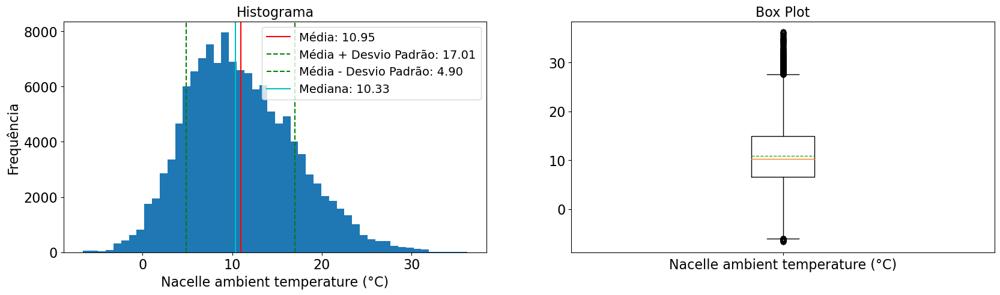

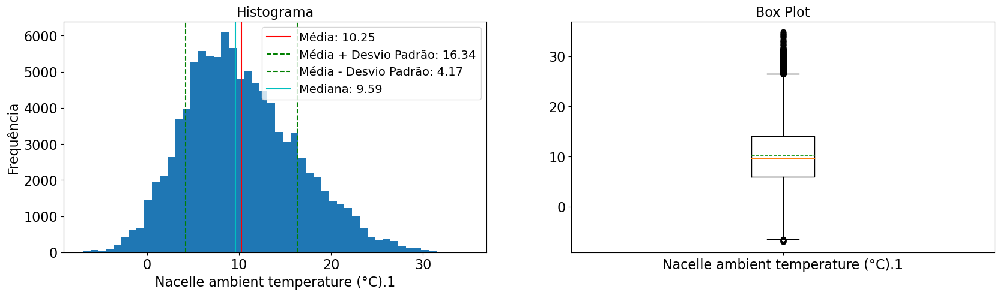

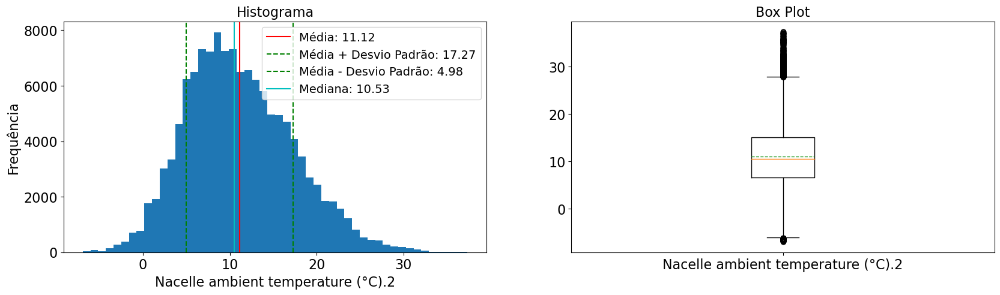

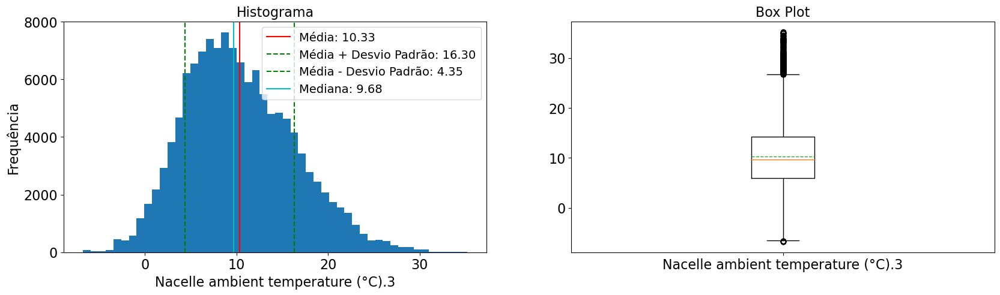

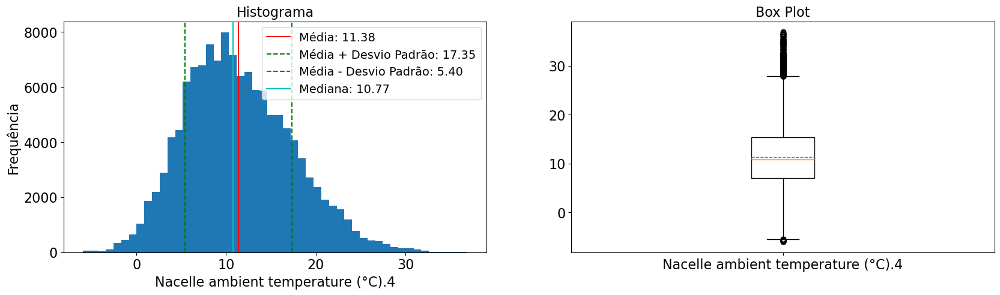

,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4
count,128954.000000,100376.000000,128947.000000,128948.000000,128871.000000
mean,10.952922,10.252642,11.123973,10.325013,11.377855
std,6.055887,6.082436,6.144751,5.973862,5.973209
min,-6.677500,-6.982500,-6.925000,-6.800000,-5.985000
25%,6.567500,5.887500,6.675000,5.965000,7.025000
50%,10.332500,9.592500,10.525000,9.684999,10.775000
75%,14.954375,14.110625,15.165000,14.287007,15.345000
max,36.259999,34.831580,37.365000,35.225000,36.914999


In [136]:
graph_hist(df, df_columns_num[35:40])

#### Generator RPM

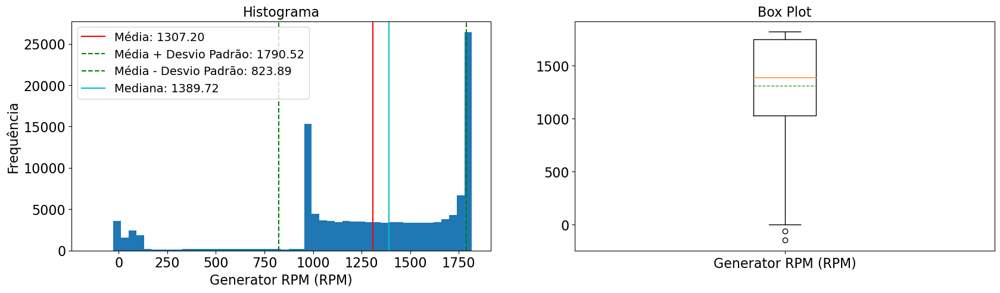

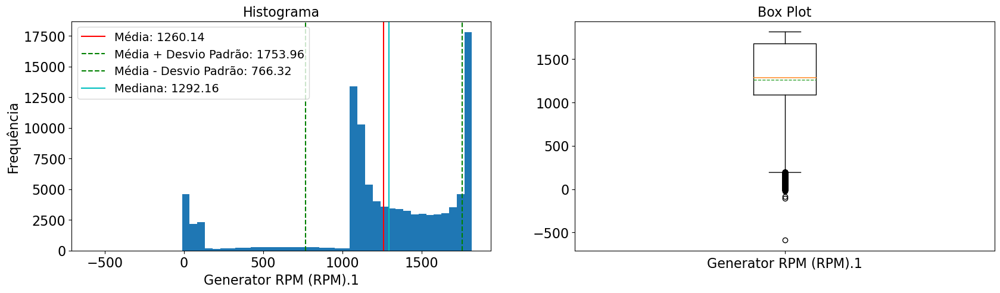

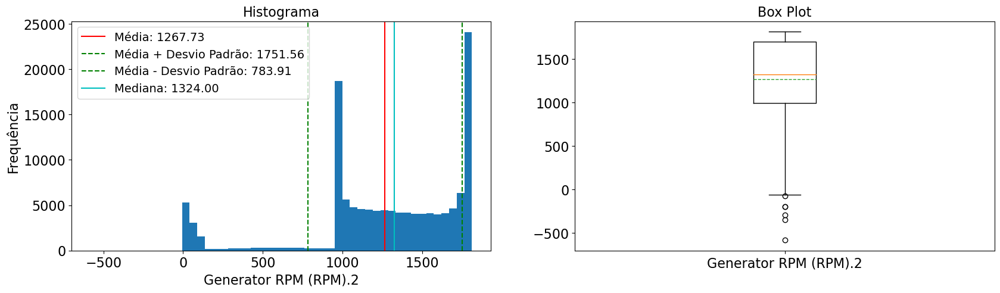

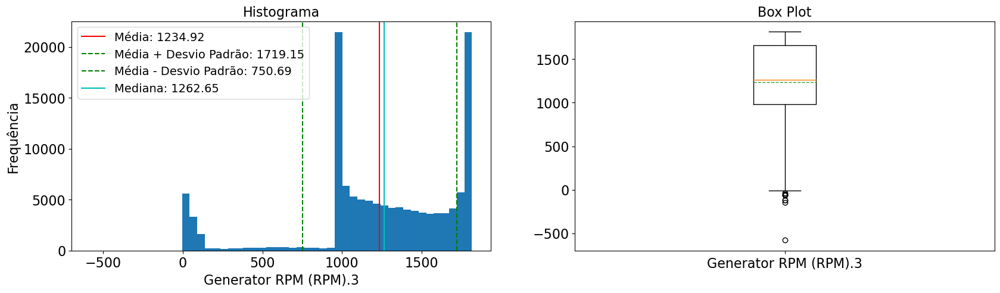

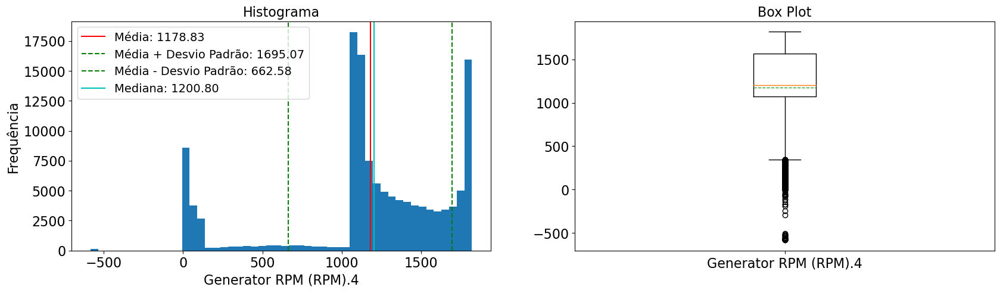

,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4
count,129382.000000,100803.000000,129376.000000,129377.000000,129302.000000
mean,1307.204388,1260.142740,1267.734067,1234.919525,1178.827867
std,483.311888,493.820649,483.827241,484.232705,516.243925
min,-145.258738,-589.246216,-581.759663,-578.886414,-583.419685
25%,1027.016144,1088.114476,995.431588,981.593201,1075.887413
50%,1389.723018,1292.159058,1323.996019,1262.650789,1200.796285
75%,1745.549744,1682.176214,1699.653888,1658.299644,1564.292603
max,1818.170546,1816.804064,1813.573883,1815.573286,1819.328390


In [137]:
graph_hist(df, df_columns_num[40:45])

#### Blade angle (pitch position)

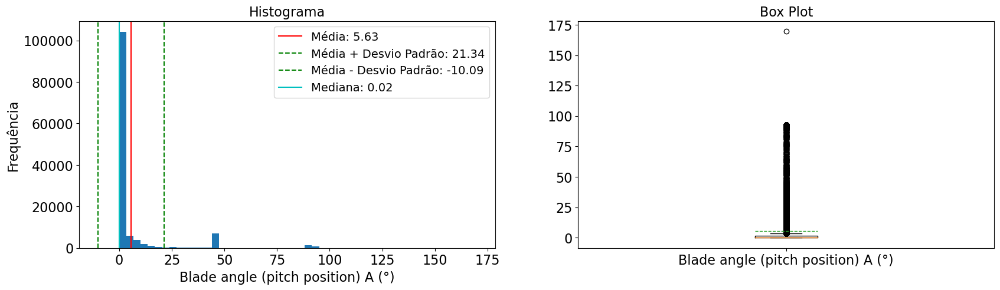

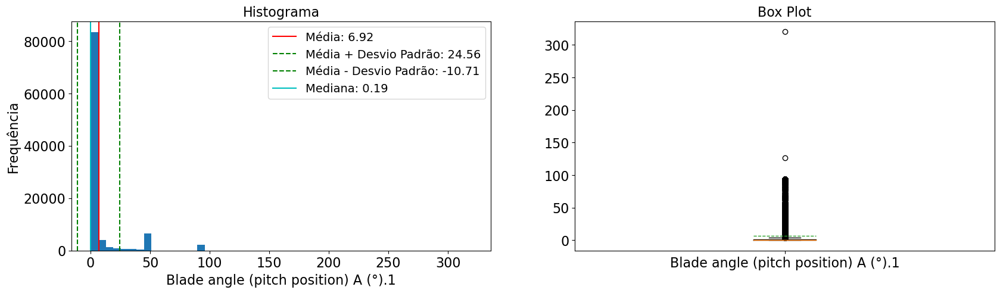

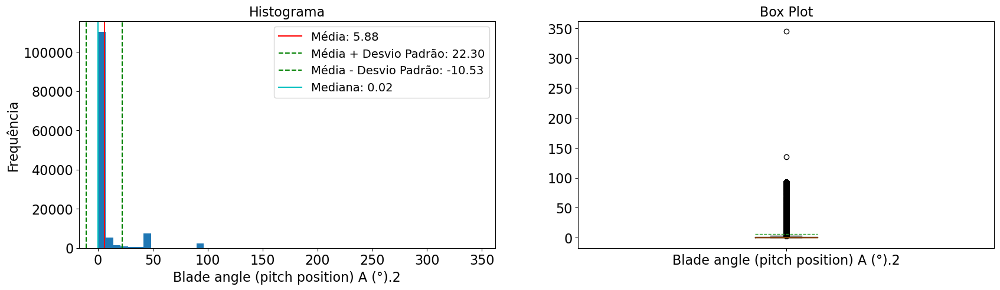

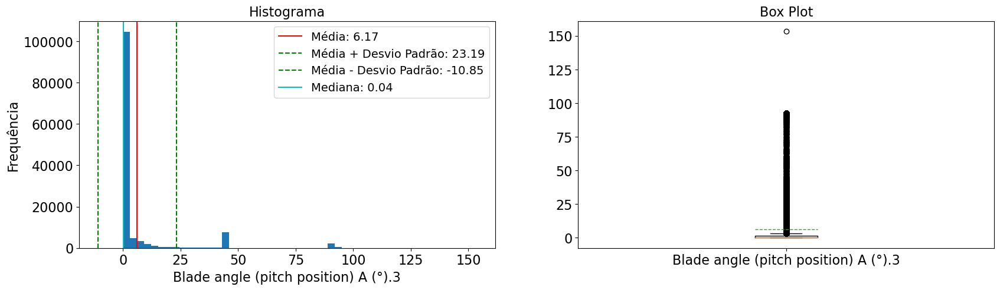

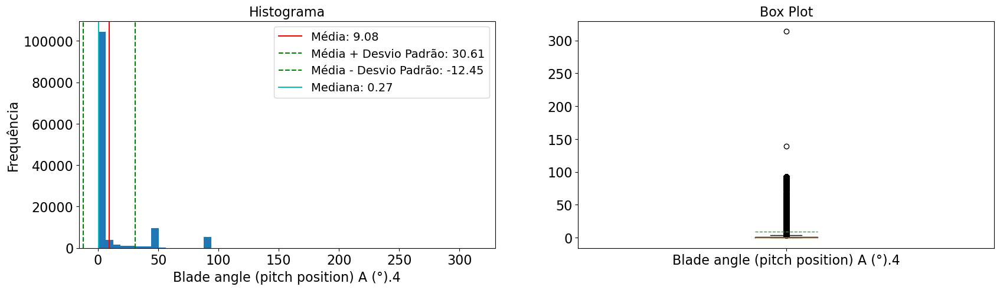

,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4
count,128954.000000,100376.000000,128947.000000,128948.000000,128872.000000
mean,5.627064,6.922372,5.884974,6.166152,9.081670
std,15.713939,17.635964,16.418859,17.020474,21.529018
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.024500,0.186842,0.024500,0.039999,0.271000
75%,1.360466,1.490000,1.288001,1.265500,1.490000
max,169.591537,320.168671,344.752686,153.358612,313.794769


In [138]:
graph_hist(df, df_columns_num[45:50])

## Analisar correlação

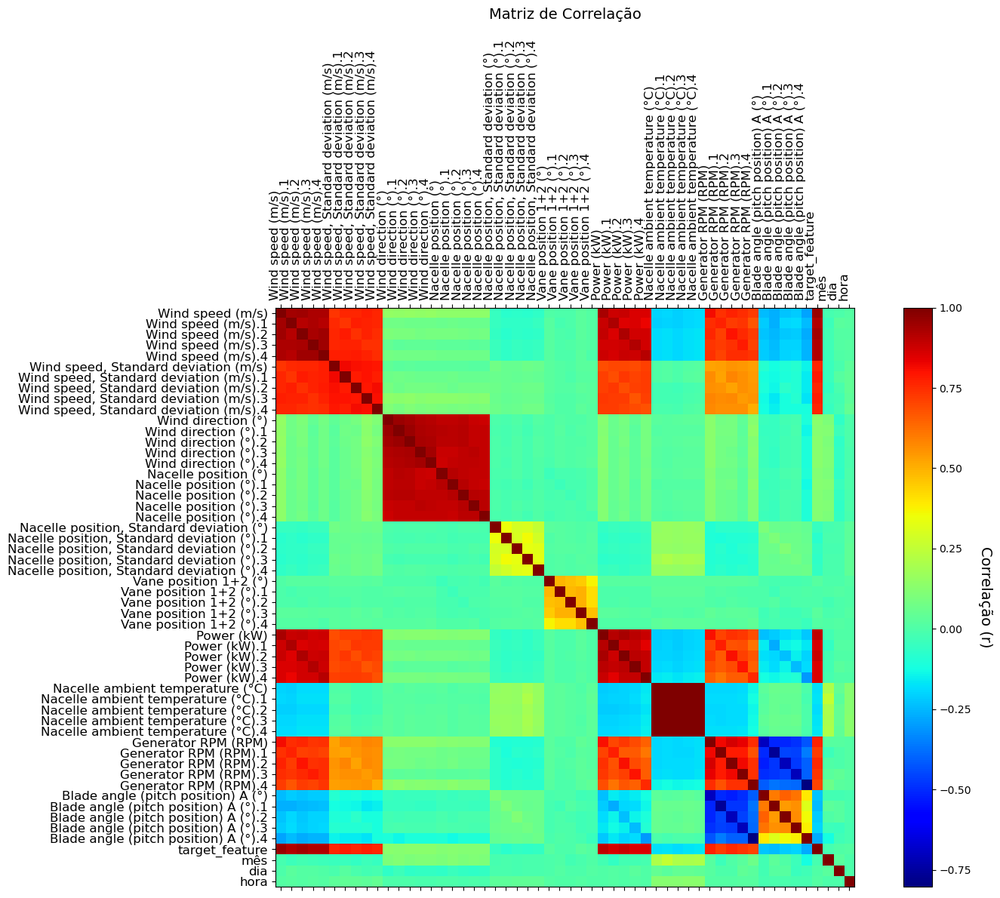

In [147]:
# Calculando a matriz de correlação
corr_matrix = df[df_columns_num + target + list_time].corr()

# Definindo as colunas
columns = list(corr_matrix.columns)

# Criando um mapa de cores
cm = plt.get_cmap('jet')  # Você pode escolher outro cmap, como 'viridis', 'inferno', 'plasma'

# Criando a figura e o eixo
fig, ax = plt.subplots(figsize=(16, 12))

# Exibindo a matriz de correlação
cax = ax.matshow(corr_matrix, cmap=cm)

# Adicionando a barra de cores
cbar = fig.colorbar(cax)
cbar.ax.set_ylabel('Correlação (r)', rotation=270, labelpad=20, fontsize=14)

# Configurando os ticks
ax.set_xticks(range(len(columns)))
ax.set_yticks(range(len(columns)))
ax.set_xticklabels(columns, rotation=90, ha="left", rotation_mode="anchor", fontsize=12)
ax.set_yticklabels(columns, fontsize=12)

# Adicionando título e rótulos, se necessário
plt.title('Matriz de Correlação', pad=20, fontsize=14)
plt.tight_layout()  # Para ajustar os elementos na figura

# Exibindo o gráfico
plt.show()

<Figure size 2000x1500 with 0 Axes>

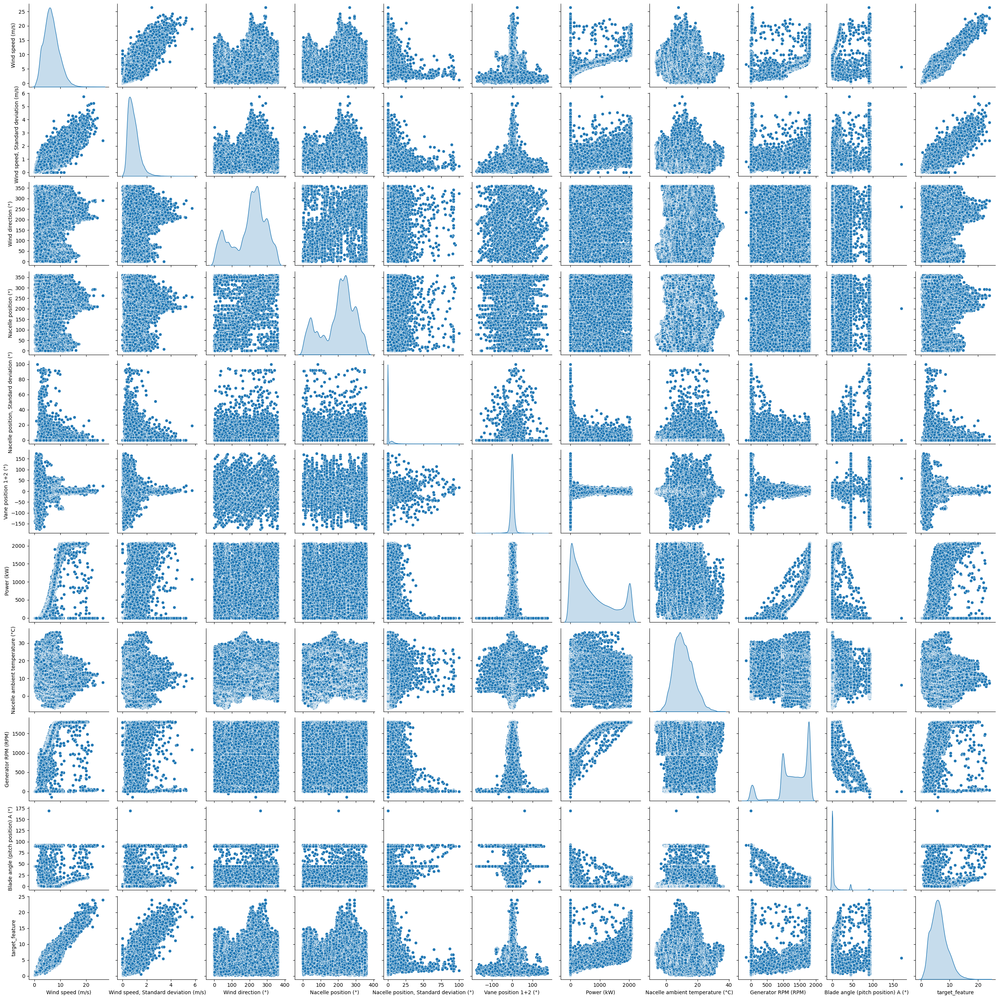

In [425]:
# Gerar o pairplot
plt.figure(figsize=(20,15))
sns.pairplot(df[df_columns_num[0::5] + target], diag_kind='kde')  # `diag_kind='kde'` para usar densidade no lugar de histogramas
plt.show()

In [435]:
corr_matrix['target_feature']# [(corr_matrix['target_feature']>0.3) | (corr_matrix['target_feature']<-0.3)]

Wind speed (m/s)                              0.952405
Wind speed (m/s).1                            0.917161
Wind speed (m/s).2                            0.937855
Wind speed (m/s).3                            0.921349
Wind speed (m/s).4                            0.920922
Wind speed, Standard deviation (m/s)          0.762794
Wind speed, Standard deviation (m/s).1        0.781951
Wind speed, Standard deviation (m/s).2        0.765966
Wind speed, Standard deviation (m/s).3        0.781478
Wind speed, Standard deviation (m/s).4        0.766193
Wind direction (°)                            0.132834
Wind direction (°).1                          0.125184
Wind direction (°).2                          0.128203
Wind direction (°).3                          0.126865
Wind direction (°).4                          0.127716
Nacelle position (°)                          0.118664
Nacelle position (°).1                        0.120706
Nacelle position (°).2                        0.119369
Nacelle po

## Analisar por Redução de Dimensionalidade

In [57]:
features = df_columns_num

scaler=StandardScaler()
dfscaler = scaler.fit_transform(df[features+target].dropna())
dfscaler = pd.DataFrame(dfscaler, columns=[features+target])

dfscaler

,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,target_feature
0,0.824832,1.033321,0.778044,0.878815,0.656092,0.440206,0.357441,0.173525,0.505270,0.785625,-0.406050,-0.361542,-0.390027,-0.368352,-0.387262,-0.352855,-0.325164,-0.424069,-0.453920,-0.364908,-0.375393,-0.360936,-0.256606,-0.403266,-0.359556,-0.427981,-0.277770,0.102970,0.455621,-0.365174,1.056524,1.135754,0.872325,0.741405,0.484577,0.392082,0.444149,0.425386,0.432581,0.482282,0.978786,1.053702,1.011535,1.005416,0.804113,-0.350618,-0.384125,-0.361575,-0.365673,-0.430000,0.761473
1,0.554750,1.087717,0.766377,0.845030,0.558651,0.662266,-0.023021,0.082559,1.130080,0.547763,-0.357731,-0.356891,-0.353032,-0.369747,-0.390506,-0.352855,-0.325164,-0.422756,-0.453920,-0.364908,-0.375393,-0.360936,-0.233708,-0.403266,-0.359556,-0.174261,-0.147915,0.343806,0.344562,-0.070224,0.730556,1.294124,0.948045,0.931295,0.420678,0.392082,0.441685,0.425386,0.432997,0.477707,0.901384,1.079870,1.016818,1.013450,0.745566,-0.358775,-0.386936,-0.355996,-0.362079,-0.430000,0.596645
2,0.717993,0.788066,1.032210,0.675962,0.697561,0.482729,0.138097,0.905693,1.437052,0.898885,-0.352381,-0.284944,-0.296723,-0.310221,-0.338663,-0.352855,-0.325164,-0.285860,-0.287467,-0.364908,-0.375393,-0.360936,0.939155,1.251735,-0.359556,0.240055,0.127130,-0.200593,-0.195555,0.297022,0.913098,1.053301,1.062863,0.734839,0.783490,0.397814,0.439222,0.425386,0.432997,0.477707,0.920269,1.005766,1.007024,0.934527,0.901062,-0.351517,-0.388676,-0.356466,-0.365138,-0.429297,0.398819
3,0.579632,0.900613,0.845256,0.575183,0.680191,0.688011,0.614949,0.111683,1.427417,-0.107898,-0.270919,-0.241872,-0.276080,-0.286872,-0.316171,-0.352855,-0.325164,-0.260456,-0.250706,-0.364908,-0.375393,-0.360936,-0.355335,-0.403266,-0.359556,0.561496,0.430904,-0.273825,-0.481353,0.529415,0.648572,1.078640,1.012445,0.503267,0.693891,0.415827,0.437579,0.425386,0.432997,0.484777,0.890538,1.044510,1.042834,0.857826,0.945516,-0.356759,-0.384212,-0.360608,-0.365673,-0.430000,0.523100
4,0.570561,1.047850,0.964007,0.767346,1.015981,1.178590,0.157402,0.190541,1.770824,0.951507,-0.281577,-0.286059,-0.290106,-0.340136,-0.298648,-0.352855,-0.325164,-0.260456,-0.250706,-0.364908,-0.375393,-0.360936,-0.355335,-0.403266,-0.359556,0.437518,0.201165,-0.394704,-0.286863,0.388691,0.599330,1.232933,1.285005,0.921668,0.842182,0.424015,0.436758,0.425386,0.434657,0.492263,0.824811,1.063470,1.049044,1.001912,0.978919,-0.358123,-0.380183,-0.341335,-0.354654,-0.430000,0.476408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [60]:
tsne = TSNE(n_components=2)

X_tsne = tsne.fit_transform(dfscaler.drop(columns=target))

X_tsne

C:\Users\terce\AppData\Local\Temp\ipykernel_27540\153606206.py:3: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  X_tsne = tsne.fit_transform(dfscaler.drop(columns=target))
c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\terce\anaconda3\envs\unifor\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


array([[ 30.07941  , -28.063578 ],
       [ 29.963305 , -28.069313 ],
       [ 28.70989  , -27.261742 ],
       ...,
       [  6.239008 ,   4.765695 ],
       [  1.1360819,  11.040586 ],
       [ -1.3066871,  11.108589 ]], dtype=float32)

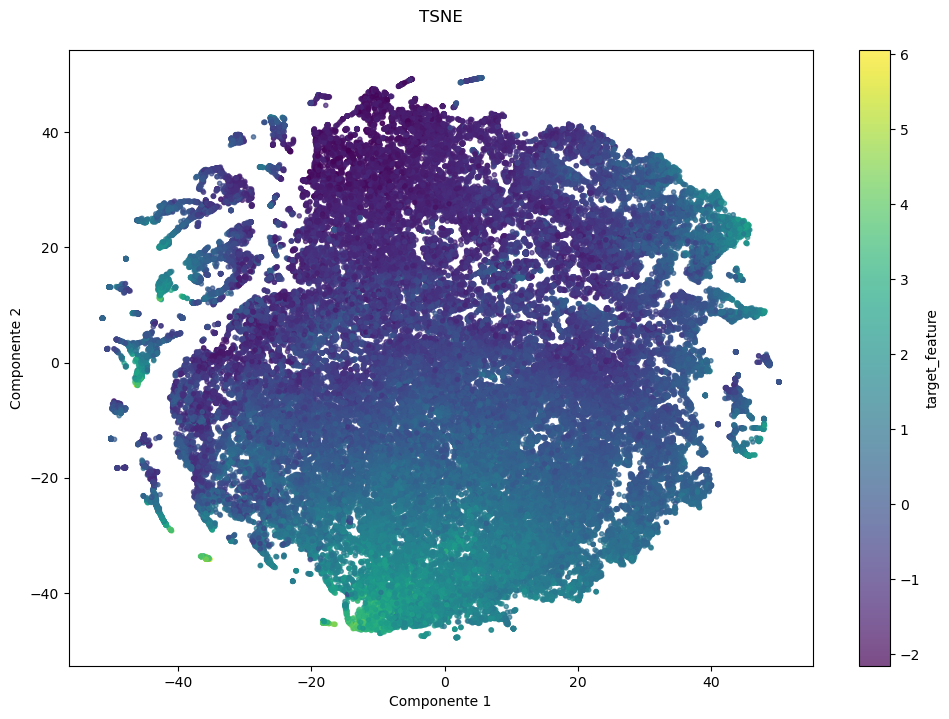

In [61]:
colors = dfscaler[target].values

plt.figure(figsize=(12, 8))
plt.scatter(X_tsne[:,0], X_tsne[:, 1], marker='.', cmap='viridis', alpha=0.7, c=colors)
plt.colorbar(label=target[0])
plt.title('TSNE', pad=20)
plt.xlabel('Componente 1')
plt.ylabel('Componente 2')
plt.show()

# Pré-processamento dos Dados e Comparação de Resultados

## Funções

In [131]:
# Função para treinar e avaliar os modelos
def avaliar_modelos(X_train, X_test, y_train, y_test, nome_df):

    tempo_inicio = time.time()

    # Linear Regression
    
    # Treina o modelo
    nome = 'Linear Regression'
    modelo = LinearRegression()
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)
    
    # Calcula as métricas
    mae_lr = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = time.time() - tempo_inicio
    print(f"FIM LR: {tempo}")

    # Random Forest
    
    # Treina o modelo
    nome = 'Random Forest'
    modelo = RandomForestRegressor(random_state=42)
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)
    
    # Calculando os erros absolutos
    erro_rf = np.abs(y_test.flatten() - y_pred.flatten())

    # Calcula as métricas
    mae_rf = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM RF: {tempo}")


    # XGBoost 
    
    # Treina o modelo
    nome = 'XGBoost'
    modelo = XGBRegressor(tree_method='hist', random_state=42)
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)
    
    # Calculando os erros absolutos
    erro_xgb = np.abs(y_test.flatten() - y_pred.flatten())

    # Calcula as métricas
    mae_xgb = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM XGB: {tempo}")


    # LightGBM
    
    # Treina o modelo
    nome = 'LightGBM'
    modelo = LGBMRegressor(random_state=42, verbose=-1)
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)

    # Calculando os erros absolutos
    erro_lgbm = np.abs(y_test.flatten() - y_pred.flatten())
    
    # Calcula as métricas
    mae_lgbm = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM LGBM: {tempo}")


    # Teste de K-S
    statisticKS23, p_valueKS23 = ks_2samp(erro_rf, erro_xgb)

    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM KS23: {tempo}")
    
    statisticKS24, p_valueKS24 = ks_2samp(erro_rf, erro_lgbm)

    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM KS24: {tempo}")
    
    statisticKS34, p_valueKS34 = ks_2samp(erro_xgb, erro_lgbm)

    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM KS34: {tempo}")

    print(f"Teste de K-S entre RF e XGB. statistic: {statisticKS23}, p-value: {p_valueKS23}")
    print(f"Teste de K-S entre RF e LGBM. statistic: {statisticKS24}, p-value: {p_valueKS24}")
    print(f"Teste de K-S entre XGB e LGBM. statistic: {statisticKS34}, p-value: {p_valueKS34}")

    if p_valueKS23 < 0.05:
        ks23 = 'Diferente'
    else:
        ks23 = 'NÃO'

    if p_valueKS24 < 0.05:
        ks24 = 'Diferente'
    else:
        ks24 = 'NÃO'

    if p_valueKS34 < 0.05:
        ks34 = 'Diferente'
    else:
        ks34 = 'NÃO'

    # Tempo de execução total
    tempo_total = time.time() - tempo_inicio

    # Criar novo registro como DataFrame
    novo_registro = pd.DataFrame([{'nome_df': nome_df, 'MAE_LR':mae_lr, 'MAE_RF':mae_rf, 'MAE_XGB':mae_xgb, 'MAE_LGBM':mae_lgbm, 
                                   'KS23':ks23, 'KS24':ks24, 'KS34':ks34, 'Tempo': tempo_total}])


    return novo_registro

In [132]:
# Função para treinar e avaliar os modelos
def avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df):

    tempo_inicio = time.time()

    # Linear Regression
    
    # Treina o modelo
    nome = 'Linear Regression'
    modelo = LinearRegression()
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)
    
    # Calcula as métricas
    mae_lr = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = time.time() - tempo_inicio
    print(f"FIM LR: {tempo}")

    # Random Forest
    
    # # Treina o modelo
    # nome = 'Random Forest'
    # modelo = RandomForestRegressor(random_state=42)
    # modelo.fit(X_train, y_train)
    
    # # Faz previsões no conjunto de teste
    # y_pred = modelo.predict(X_test)
    
    # # Calculando os erros absolutos
    # erro_rf = np.abs(y_test.flatten() - y_pred.flatten())

    # # Calcula as métricas
    # mae_rf = mean_absolute_error(y_test, y_pred)

    # del modelo  # Remove qualquer versão anterior do modelo da memória



    # XGBoost 
    
    # Treina o modelo
    nome = 'XGBoost'
    modelo = XGBRegressor(tree_method='hist', random_state=42)
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)
    
    # Calculando os erros absolutos
    erro_xgb = np.abs(y_test.flatten() - y_pred.flatten())

    # Calcula as métricas
    mae_xgb = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM XGB: {tempo}")


    # LightGBM
    
    # Treina o modelo
    nome = 'LightGBM'
    modelo = LGBMRegressor(random_state=42, verbose=-1)
    modelo.fit(X_train, y_train)
    
    # Faz previsões no conjunto de teste
    y_pred = modelo.predict(X_test)

    # Calculando os erros absolutos
    erro_lgbm = np.abs(y_test.flatten() - y_pred.flatten())
    
    # Calcula as métricas
    mae_lgbm = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM LGBM: {tempo}")


    # Teste de K-S
    # statisticKS23, p_valueKS23 = ks_2samp(erro_rf, erro_xgb)
    # tempo = (time.time() - tempo_inicio) - tempo
    # print(f"FIM KS23: {tempo}")
    # statisticKS24, p_valueKS24 = ks_2samp(erro_rf, erro_lgbm)
    # tempo = (time.time() - tempo_inicio) - tempo
    # print(f"FIM KS24: {tempo}")
    statisticKS34, p_valueKS34 = ks_2samp(erro_xgb, erro_lgbm)
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM KS34: {tempo}")

    # print(f"Teste de K-S entre RF e XGB: {statisticKS23}, p-value: {p_valueKS23}")
    # print(f"Teste de K-S entre RF e LGBM: {statisticKS24}, p-value: {p_valueKS24}")
    print(f"Teste de K-S entre XGB e LGBM. statistic: {statisticKS34}, p-value: {p_valueKS34}")


    if p_valueKS34 < 0.05:
        ks34 = 'Diferente'
    else:
        ks34 = 'NÃO'
    
    # Tempo de execução total
    tempo_total = time.time() - tempo_inicio

    # Criar novo registro como DataFrame
    novo_registro = pd.DataFrame([{'nome_df': nome_df, 'MAE_LR':mae_lr, 'MAE_RF':'', 'MAE_XGB':mae_xgb, 'MAE_LGBM':mae_lgbm, 
                                   'KS23':'', 'KS24':'', 'KS34':ks34, 'Tempo': tempo_total}])


    return novo_registro

In [133]:
# Função para treinar e avaliar os modelos
def avaliar_modelos2_scaler(X_train, X_test, y_train, y_test, nome_df, model_scaler):

    tempo_inicio = time.time()

    # Criar o scaler
    scaler_x = model_scaler()
    scaler_y = model_scaler()

    # Ajustar o scaler nos dados de treino e transformar
    X_train_scaled = scaler_x.fit_transform(X_train)
    y_train_scaled = scaler_y.fit_transform(y_train)

    # Apenas transformar os dados de teste
    X_test_scaled = scaler_x.transform(X_test)
    y_test_scaled = scaler_y.transform(y_test)




    # Linear Regression
    
    # Treina o modelo
    nome = 'Linear Regression'
    modelo = LinearRegression()
    modelo.fit(X_train_scaled, y_train_scaled)
    # Faz previsões no conjunto de teste
    y_pred_scaled = modelo.predict(X_test_scaled)
    # Inverte a transformação para obter os valores reais
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).flatten()
    
    # Calcula as métricas
    mae_lr = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = time.time() - tempo_inicio
    print(f"FIM LR: {tempo}")

    # Random Forest
    
    # # Treina o modelo
    # nome = 'Random Forest'
    # modelo = RandomForestRegressor(random_state=42)
    # modelo.fit(X_train, y_train)
    
    # # Faz previsões no conjunto de teste
    # y_pred = modelo.predict(X_test)
    
    # # Calculando os erros absolutos
    # erro_rf = np.abs(y_test.flatten() - y_pred.flatten())

    # # Calcula as métricas
    # mae_rf = mean_absolute_error(y_test, y_pred)

    # del modelo  # Remove qualquer versão anterior do modelo da memória



    # XGBoost 
    
    # Treina o modelo
    nome = 'XGBoost'
    modelo = XGBRegressor(tree_method='hist', random_state=42)
    modelo.fit(X_train_scaled, y_train_scaled)
    
    # Faz previsões no conjunto de teste
    y_pred_scaled = modelo.predict(X_test_scaled)
    # Inverte a transformação para obter os valores reais
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).flatten()
    
    # Calculando os erros absolutos
    erro_xgb = np.abs(y_test.flatten() - y_pred.flatten())

    # Calcula as métricas
    mae_xgb = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM XGB: {tempo}")


    # LightGBM
    
    # Treina o modelo
    nome = 'LightGBM'
    modelo = LGBMRegressor(random_state=42, verbose=-1)
    modelo.fit(X_train_scaled, y_train_scaled)
    
    # Faz previsões no conjunto de teste
    y_pred_scaled = modelo.predict(X_test_scaled)
    # Inverte a transformação para obter os valores reais
    y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).flatten()

    # Calculando os erros absolutos
    erro_lgbm = np.abs(y_test.flatten() - y_pred.flatten())
    
    # Calcula as métricas
    mae_lgbm = mean_absolute_error(y_test, y_pred)

    del modelo  # Remove qualquer versão anterior do modelo da memória
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM LGBM: {tempo}")


    # Teste de K-S
    # statisticKS23, p_valueKS23 = ks_2samp(erro_rf, erro_xgb)
    # tempo = (time.time() - tempo_inicio) - tempo
    # print(f"FIM KS23: {tempo}")
    # statisticKS24, p_valueKS24 = ks_2samp(erro_rf, erro_lgbm)
    # tempo = (time.time() - tempo_inicio) - tempo
    # print(f"FIM KS24: {tempo}")
    statisticKS34, p_valueKS34 = ks_2samp(erro_xgb, erro_lgbm)
    tempo = (time.time() - tempo_inicio) - tempo
    print(f"FIM KS34: {tempo}")

    # print(f"Teste de K-S entre RF e XGB: {statisticKS23}, p-value: {p_valueKS23}")
    # print(f"Teste de K-S entre RF e LGBM: {statisticKS24}, p-value: {p_valueKS24}")
    print(f"Teste de K-S entre XGB e LGBM. statistic: {statisticKS34}, p-value: {p_valueKS34}")


    if p_valueKS34 < 0.05:
        ks34 = 'Diferente'
    else:
        ks34 = 'NÃO'
    
    # Tempo de execução total
    tempo_total = time.time() - tempo_inicio

    # Criar novo registro como DataFrame
    novo_registro = pd.DataFrame([{'nome_df': nome_df, 'MAE_LR':mae_lr, 'MAE_RF':'', 'MAE_XGB':mae_xgb, 'MAE_LGBM':mae_lgbm, 
                                   'KS23':'', 'KS24':'', 'KS34':ks34, 'Tempo': tempo_total}])


    return novo_registro

In [134]:
# # Função para treinar e avaliar os modelos
# def avaliar_modelos(X_train, X_test, y_train, y_test, nome_df):
#     # Criando um dicionário com os modelos
#     modelos = {
#         "Linear Regression": LinearRegression(),
#         "Random Forest": RandomForestRegressor(random_state=42),
#         "XGBoost": XGBRegressor(tree_method='hist', random_state=42),
#         "LightGBM": LGBMRegressor(random_state=42)
#     }
    
#     # Criar DF par armazenar performance dos métodos desenvolvidos
#     df_comparacao = pd.DataFrame(columns=['nome_df', 'modelo', 'MAE', 'MSE', 'RMSE', 'R2', 'Tempo'])
    
#     for nome, modelo in modelos.items():
#         tempo_inicio = time.time()
#         # Treina o modelo
#         modelo.fit(X_train, y_train)
        
#         # Faz previsões no conjunto de teste
#         y_pred = modelo.predict(X_test)
        
#         # Calcula as métricas
#         mae = mean_absolute_error(y_test, y_pred)
#         mse = mean_squared_error(y_test, y_pred)
#         rmse = np.sqrt(mse)
#         r2 = r2_score(y_test, y_pred)
        
#         # Tempo de execução de cada modelo
#         tempo_total = time.time() - tempo_inicio
        
#         # Criar novo registro como DataFrame
#         novo_registro = pd.DataFrame([{'nome_df': nome_df, 'modelo': nome, 'MAE': mae, 'MSE': mse, 
#                                     'RMSE': rmse, 'R2': r2, 'Tempo': tempo_total}])

#         # Se df_comparacao está vazio, atribuir diretamente
#         if df_comparacao.empty:
#             df_comparacao = novo_registro
#         else:
#             df_comparacao = pd.concat([df_comparacao, novo_registro], ignore_index=True)

#         del modelo  # Remove qualquer versão anterior do modelo da memória

#     return df_comparacao

In [135]:
# # Função para treinar e avaliar os modelos
# def avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df):
#     # Criando um dicionário com os modelos
#     modelos = {
#         "Linear Regression": LinearRegression(),
#         #"Random Forest": RandomForestRegressor(random_state=42),
#         "XGBoost": XGBRegressor(tree_method='hist', random_state=42),
#         "LightGBM": LGBMRegressor(random_state=42)
#     }
    
#     # Criar DF par armazenar performance dos métodos desenvolvidos
#     df_comparacao = pd.DataFrame(columns=['nome_df', 'modelo', 'MAE', 'MSE', 'RMSE', 'R2', 'Tempo'])
    
#     for nome, modelo in modelos.items():
#         tempo_inicio = time.time()
#         # Treina o modelo
#         modelo.fit(X_train, y_train)
        
#         # Faz previsões no conjunto de teste
#         y_pred = modelo.predict(X_test)
        
#         # Calcula as métricas
#         mae = mean_absolute_error(y_test, y_pred)
#         mse = mean_squared_error(y_test, y_pred)
#         rmse = np.sqrt(mse)
#         r2 = r2_score(y_test, y_pred)
        
#         # Tempo de execução de cada modelo
#         tempo_total = time.time() - tempo_inicio
        
#         # Criar novo registro como DataFrame
#         novo_registro = pd.DataFrame([{'nome_df': nome_df, 'modelo': nome, 'MAE': mae, 'MSE': mse, 
#                                     'RMSE': rmse, 'R2': r2, 'Tempo': tempo_total}])

#         # Se df_comparacao está vazio, atribuir diretamente
#         if df_comparacao.empty:
#             df_comparacao = novo_registro
#         else:
#             df_comparacao = pd.concat([df_comparacao, novo_registro], ignore_index=True)

#         del modelo  # Remove qualquer versão anterior do modelo da memória

#     return df_comparacao

In [136]:
# # Função para treinar e avaliar os modelos
# def avaliar_modelos_scaler(X_train, X_test, y_train, y_test, nome_df, model_scaler):
#     # Criando um dicionário com os modelos
#     modelos = {
#         "Linear Regression": LinearRegression(),
#         #"Random Forest": RandomForestRegressor(random_state=42),
#         "XGBoost": XGBRegressor(tree_method='hist', random_state=42),
#         "LightGBM": LGBMRegressor(random_state=42)
#         #"Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
#         #"XGBoost": XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42),
#         #"LightGBM": LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
#     }
    
#     # Criar DF par armazenar performance dos métodos desenvolvidos
#     df_comparacao = pd.DataFrame(columns=['nome_df', 'modelo', 'MAE', 'MSE', 'RMSE', 'R2', 'Tempo'])
    
#     # Criar o scaler
#     scaler_x = model_scaler
#     scaler_y = model_scaler.__class__()

#     # Ajustar o scaler nos dados de treino e transformar
#     X_train_scaled = scaler_x.fit_transform(X_train)
#     y_train_scaled = scaler_y.fit_transform(y_train)

#     # Apenas transformar os dados de teste
#     X_test_scaled = scaler_x.transform(X_test)
#     y_test_scaled = scaler_y.transform(y_test)



#     for nome, modelo in modelos.items():
#         tempo_inicio = time.time()
#         # Treina o modelo
#         modelo.fit(X_train_scaled, y_train_scaled)
        
#         # Faz previsões no conjunto de teste
#         y_pred_scaled = modelo.predict(X_test_scaled)
#         # Inverte a transformação para obter os valores reais
#         y_pred = scaler_y.inverse_transform(y_pred_scaled.reshape(-1, 1)).flatten()
        
#         # Calcula as métricas
#         mae = mean_absolute_error(y_test, y_pred)
#         mse = mean_squared_error(y_test, y_pred)
#         rmse = np.sqrt(mse)
#         r2 = r2_score(y_test, y_pred)
        
#         # Tempo de execução de cada modelo
#         tempo_total = time.time() - tempo_inicio
        
#         # Criar novo registro como DataFrame
#         novo_registro = pd.DataFrame([{'nome_df': nome_df, 'modelo': nome, 'MAE': mae, 'MSE': mse, 
#                                     'RMSE': rmse, 'R2': r2, 'Tempo': tempo_total}])

#         # Se df_comparacao está vazio, atribuir diretamente
#         if df_comparacao.empty:
#             df_comparacao = novo_registro
#         else:
#             df_comparacao = pd.concat([df_comparacao, novo_registro], ignore_index=True)

#         del modelo  # Remove qualquer versão anterior do modelo da memória

#     return df_comparacao

In [137]:
# Função de identificação dos outliers
def outliers(data, feature):
    Q1 = np.percentile(data[feature].dropna(),25)
    Q3 = np.percentile(data[feature].dropna(),75)

    #print('Q1: %.2f' %Q1)
    #print('Q3: %.2f' %Q3)

    C = 1.5
    IIQ = Q3 - Q1
    LI = Q1 - C*IIQ
    LS = Q1 + C*IIQ

    #print('IIQ: %.2f' %IIQ)
    #print('Limites:')
    #print(' Inferior: %.2f' %LI)
    #print(' Superior: %.2f' %LS)

    return LI, LS

# Função para visualizar outliers com scatter plot
def graph_outliers(df_analise01, df_analise02, lista_out):
    # Criar uma figura com 21 subplots (7 linhas x 3 colunas)
    fig, axes = plt.subplots(7, 3, figsize=(20, 30))
    axes = axes.flatten()  # Achatar a matriz de eixos para facilitar o acesso
    idx = -1
    for i in range(len(lista_out)):
        for j in range(i+1,len(lista_out)):
            if i != j:
                idx += 1
                data = df_analise01[[lista_out[i],lista_out[j]]]
                data2 = df_analise02[[lista_out[i],lista_out[j]]]

                ax = axes[idx]
                ax.scatter(data2.iloc[:, 0], data2.iloc[:, 1], label='Normal', alpha=0.5)
                ax.scatter(data.iloc[:, 0], data.iloc[:, 1], c='r', label='Outlier', alpha=0.7)
                ax.set_xlabel(data.columns[0])
                ax.set_ylabel(data.columns[1])
                ax.grid(True)
                ax.legend()
                ax.set_title(f'Gráfico {idx + 1}')

    # Ajustar espaçamento entre os subplots
    plt.tight_layout()
    plt.show()


# Função para visualizar outliers com scatter plot
def graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out):
    # Criar uma figura com 21 subplots (7 linhas x 3 colunas)
    fig, axes = plt.subplots(7, 3, figsize=(20, 30))
    axes = axes.flatten()  # Achatar a matriz de eixos para facilitar o acesso
    idx = -1
    for i in range(len(lista_out)):
        for j in range(i+1,len(lista_out)):
            if i != j:
                idx += 1
                data = df_analise01[[lista_out[i],lista_out[j]]]
                data2 = df_analise02[[lista_out[i],lista_out[j]]]
                data3 = df_analise03[[lista_out[i],lista_out[j]]]

                ax = axes[idx]
                ax.scatter(data2.iloc[:, 0], data2.iloc[:, 1], label='Normal', alpha=0.5)
                ax.scatter(data.iloc[:, 0], data.iloc[:, 1], c='r', label='Lim_inf', alpha=0.5)
                ax.scatter(data3.iloc[:, 0], data3.iloc[:, 1], c='g', label='Lim_sup', alpha=0.5)
                ax.set_xlabel(data.columns[0])
                ax.set_ylabel(data.columns[1])
                ax.grid(True)
                ax.legend()
                ax.set_title(f'Gráfico {idx + 1}')

    # Ajustar espaçamento entre os subplots
    plt.tight_layout()
    plt.show()


# Função para visualizar outliers com scatter plot
def graph_outliers3(df_analise01, df_analise02, df_analise03, lista_out):
    # Criar uma figura com 21 subplots (7 linhas x 3 colunas)
    fig, axes = plt.subplots(2, 3, figsize=(16, 8))
    axes = axes.flatten()  # Achatar a matriz de eixos para facilitar o acesso
    idx = -1
    for i in range(len(lista_out)):
        for j in range(i+1,len(lista_out)):
            if i != j:
                idx += 1
                data = df_analise01[[lista_out[i],lista_out[j]]]
                data2 = df_analise02[[lista_out[i],lista_out[j]]]
                data3 = df_analise03[[lista_out[i],lista_out[j]]]

                ax = axes[idx]
                ax.scatter(data2.iloc[:, 0], data2.iloc[:, 1], label='Normal', alpha=0.5)
                ax.scatter(data.iloc[:, 0], data.iloc[:, 1], c='r', label='Lim_inf', alpha=0.5)
                ax.scatter(data3.iloc[:, 0], data3.iloc[:, 1], c='g', label='Lim_sup', alpha=0.5)
                ax.set_xlabel(data.columns[0], fontsize=16)
                ax.set_ylabel(data.columns[1], fontsize=16)
                ax.grid(True)
                if (idx == 0):
                    ax.legend(fontsize=10, loc='upper left')
                elif (idx == 3) :
                    ax.legend(fontsize=10, loc='lower right')
                else:
                    ax.legend(fontsize=10, loc='upper right')

                ax.set_title(f'Gráfico {idx + 1}', fontsize=16)
                ax.tick_params(axis='x', labelsize=14)
                ax.tick_params(axis='y', labelsize=14)

    # Ajustar espaçamento entre os subplots
    plt.tight_layout()
    plt.show()

## Treino e Teste

In [138]:
## Separação dos dados entre treino e teste

# Dividindo os dados em treino (80%) e teste (20%)
df_train, dft = train_test_split(df, test_size=0.2, random_state=42)

# Versão bde trabalho
df_bkup = df.copy()

df = df_train.copy()

In [42]:
# df_comparacao_final = pd.DataFrame(columns=['nome_df', 'modelo', 'MAE', 'MSE', 'RMSE', 'R2', 'Tempo'])

In [182]:
df_comparacao_final = pd.DataFrame(columns=['nome_df', 'MAE_LR', 'MAE_RF', 'MAE_XGB', 'MAE_LGBM', 'KS23', 'KS24', 'KS34', 'Tempo'])

## Versão 1 - Apagando linhas com valores ausentes.

In [139]:
# todas as linhas contendo valores ausentes removidas

df_01 = df.copy()
df_01.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)

df_01t = dft.copy()
df_01t.dropna(axis=0,how='any',subset=df_columns_num+target,inplace=True)

In [140]:
print('Quantidade de linhas inicialmente:', len(df))
print('Quantidade de linhas apagadas:', len(df)-len(df_01))
print('Porcentagem de linhas apagadas:', ((len(df)-len(df_01))/len(df))*100)

Quantidade de linhas inicialmente: 103530
Quantidade de linhas apagadas: 23534
Porcentagem de linhas apagadas: 22.7315753887762


In [141]:
nan_verification(df_01)

,Count,Perc
Timestamp,0,0.000000
Generator RPM (RPM),0,0.000000
Vane position 1+2 (°).4,0,0.000000
Power (kW),0,0.000000
Power (kW).1,0,0.000000
Power (kW).2,0,0.000000
Power (kW).3,0,0.000000
Power (kW).4,0,0.000000
Nacelle ambient temperature (°C),0,0.000000
Nacelle ambient temperature (°C).1,0,0.000000


Criando algumas listas para teste.

In [142]:
list_natural = ['Wind speed (m/s)',
                'Wind speed (m/s).1',
                'Wind speed (m/s).2',
                'Wind speed (m/s).3',
                'Wind speed (m/s).4',
                'Wind speed, Standard deviation (m/s)',
                'Wind speed, Standard deviation (m/s).1',
                'Wind speed, Standard deviation (m/s).2',
                'Wind speed, Standard deviation (m/s).3',
                'Wind speed, Standard deviation (m/s).4',
                'Wind direction (°)',
                'Wind direction (°).1',
                'Wind direction (°).2',
                'Wind direction (°).3',
                'Wind direction (°).4',
                'Nacelle ambient temperature (°C)',
                'Nacelle ambient temperature (°C).1',
                'Nacelle ambient temperature (°C).2',
                'Nacelle ambient temperature (°C).3',
                'Nacelle ambient temperature (°C).4']


In [143]:
list_artificial =['Nacelle position (°)',
                    'Nacelle position (°).1',
                    'Nacelle position (°).2',
                    'Nacelle position (°).3',
                    'Nacelle position (°).4',
                    'Nacelle position, Standard deviation (°)',
                    'Nacelle position, Standard deviation (°).1',
                    'Nacelle position, Standard deviation (°).2',
                    'Nacelle position, Standard deviation (°).3',
                    'Nacelle position, Standard deviation (°).4',
                    'Vane position 1+2 (°)',
                    'Vane position 1+2 (°).1',
                    'Vane position 1+2 (°).2',
                    'Vane position 1+2 (°).3',
                    'Vane position 1+2 (°).4',
                    'Power (kW)',
                    'Power (kW).1',
                    'Power (kW).2',
                    'Power (kW).3',
                    'Power (kW).4',
                    'Generator RPM (RPM)',
                    'Generator RPM (RPM).1',
                    'Generator RPM (RPM).2',
                    'Generator RPM (RPM).3',
                    'Generator RPM (RPM).4',
                    'Blade angle (pitch position) A (°)',
                    'Blade angle (pitch position) A (°).1',
                    'Blade angle (pitch position) A (°).2',
                    'Blade angle (pitch position) A (°).3',
                    'Blade angle (pitch position) A (°).4']


In [144]:
# Calculando a matriz de correlação
corr_matrix = df_01[df_columns_num + list_time + target].corr()
# Exportar DF com correlação para xlsx
corr_matrix['target_feature']#.to_excel('corr_matrix_2.xlsx')

Wind speed (m/s)                              0.953455
Wind speed (m/s).1                            0.916948
Wind speed (m/s).2                            0.938422
Wind speed (m/s).3                            0.920525
Wind speed (m/s).4                            0.920912
Wind speed, Standard deviation (m/s)          0.762175
Wind speed, Standard deviation (m/s).1        0.783382
Wind speed, Standard deviation (m/s).2        0.764866
Wind speed, Standard deviation (m/s).3        0.780985
Wind speed, Standard deviation (m/s).4        0.765181
Wind direction (°)                            0.117393
Wind direction (°).1                          0.122857
Wind direction (°).2                          0.113611
Wind direction (°).3                          0.114204
Wind direction (°).4                          0.114670
Nacelle position (°)                          0.106023
Nacelle position (°).1                        0.117999
Nacelle position (°).2                        0.106267
Nacelle po

In [145]:
list_corr = corr_matrix['target_feature'][(corr_matrix['target_feature']>0.1) | (corr_matrix['target_feature']<-0.1)].index

# Retirando a variável target da lista
list_corr = list(list_corr)
list_corr.remove('target_feature')

list_corr

['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4',
 'Wind direction (°)',
 'Wind direction (°).1',
 'Wind direction (°).2',
 'Wind direction (°).3',
 'Wind direction (°).4',
 'Nacelle position (°)',
 'Nacelle position (°).1',
 'Nacelle position (°).2',
 'Nacelle position (°).3',
 'Nacelle position (°).4',
 'Power (kW)',
 'Power (kW).1',
 'Power (kW).2',
 'Power (kW).3',
 'Power (kW).4',
 'Nacelle ambient temperature (°C)',
 'Nacelle ambient temperature (°C).1',
 'Nacelle ambient temperature (°C).2',
 'Nacelle ambient temperature (°C).3',
 'Nacelle ambient temperature (°C).4',
 'Generator RPM (RPM)',
 'Generator RPM (RPM).1',
 'Generator RPM (RPM).2',
 'Generator RPM (RPM).3',
 'Generator RPM (RPM).4',
 'Blade angle 

## Teste

In [196]:
X_train = df_01[df_columns_num].values
y_train = df_01[target].values
X_test = df_01t[df_columns_num].values
y_test = df_01t[target].values
nome_df = 'df_01_df_columns_num'   

df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = df_comparacao
df_comparacao

FIM LR: 0.6249866485595703
FIM RF: 313.8028345108032
FIM XGB: 2.504504919052124
FIM LGBM: 315.2113091945648
FIM KS23: 2.5234880447387695
FIM KS24: 315.21683502197266
FIM KS34: 2.5396571159362793
Teste de K-S entre RF e XGB. statistic: 0.0095956819431256, p-value: 0.31366355303582516
Teste de K-S entre RF e LGBM. statistic: 0.014793342995651937, p-value: 0.024836426387256805
Teste de K-S entre XGB e LGBM. statistic: 0.01299415263131598, p-value: 0.06761556323505069


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492


In [197]:
X_train = df_01[list_natural].values
y_train = df_01[target].values
X_test = df_01t[list_natural].values
y_test = df_01t[target].values
nome_df = 'df_01_list_natural'   

df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.08246898651123047
FIM RF: 133.11089372634888
FIM XGB: 0.9387757778167725
FIM LGBM: 133.7716805934906
FIM KS23: 0.9553864002227783
FIM KS24: 133.80602145195007
FIM KS34: 0.9673910140991211
Teste de K-S entre RF e XGB. statistic: 0.012444400019991031, p-value: 0.08947666534034848
Teste de K-S entre RF e LGBM. statistic: 0.016792443400469814, p-value: 0.0070111333980354225
Teste de K-S entre XGB e LGBM. statistic: 0.01239442250987055, p-value: 0.09172940476952263


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416


In [199]:
X_train = df_01[list_artificial].values
y_train = df_01[target].values
X_test = df_01t[list_artificial].values
y_test = df_01t[target].values
nome_df = 'df_01_list_artificial'   

df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.21744894981384277
FIM RF: 166.5613489151001
FIM XGB: 1.4411587715148926
FIM LGBM: 167.6010365486145
FIM KS23: 1.4742498397827148
FIM KS24: 167.64552092552185
FIM KS34: 1.5068225860595703
Teste de K-S entre RF e XGB. statistic: 0.017692038582637792, p-value: 0.0037664824404290763
Teste de K-S entre RF e LGBM. statistic: 0.03898245789394772, p-value: 1.2048501726248248e-13
Teste de K-S entre XGB e LGBM. statistic: 0.024538957469138922, p-value: 1.1506642914515904e-05


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304


In [200]:
X_train = df_01[list_corr].values
y_train = df_01[target].values
X_test = df_01t[list_corr].values
y_test = df_01t[target].values
nome_df = 'df_01_df_list_corr'

df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.2205650806427002
FIM RF: 246.87940979003906
FIM XGB: 1.6195392608642578
FIM LGBM: 247.94309163093567
FIM KS23: 1.6259510517120361
FIM KS24: 247.9901008605957
FIM KS34: 1.6329567432403564
Teste de K-S entre RF e XGB. statistic: 0.013393972712279434, p-value: 0.05473391963802754
Teste de K-S entre RF e LGBM. statistic: 0.021490329351791737, p-value: 0.00019117817560828433
Teste de K-S entre XGB e LGBM. statistic: 0.012044579939027522, p-value: 0.10886226740652183


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058


In [201]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058


## Versão 2 - Corrigindo outliers em df_01

In [167]:
df_02 = df_01.copy()
df_02t = df_01t.copy()

Wind speed (m/s)
-1.2974015474319458 10.500736832618713
Quantidade de outliers: 8501


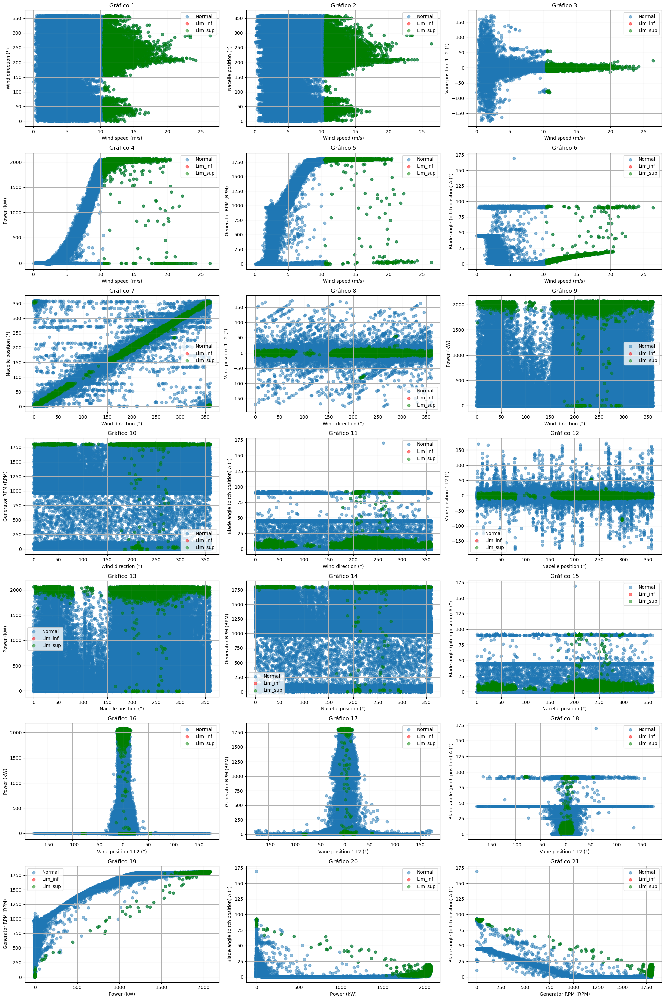

In [147]:
feat = 0
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
data = df_02
a, b = outliers(data, feature)
print(a,b)

# a=limite_inferior
# b=limite_superior

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[0::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

In [148]:
df_columns_num[feat]

'Wind speed (m/s)'

In [149]:
lista_out

['Wind speed (m/s)',
 'Wind direction (°)',
 'Nacelle position (°)',
 'Vane position 1+2 (°)',
 'Power (kW)',
 'Generator RPM (RPM)',
 'Blade angle (pitch position) A (°)']

Power (kW)
-1493.8057929992679 1838.0683509826663
Média: 764.63
Desvio padrão: 684.93
Quantidade de outliers: 18845


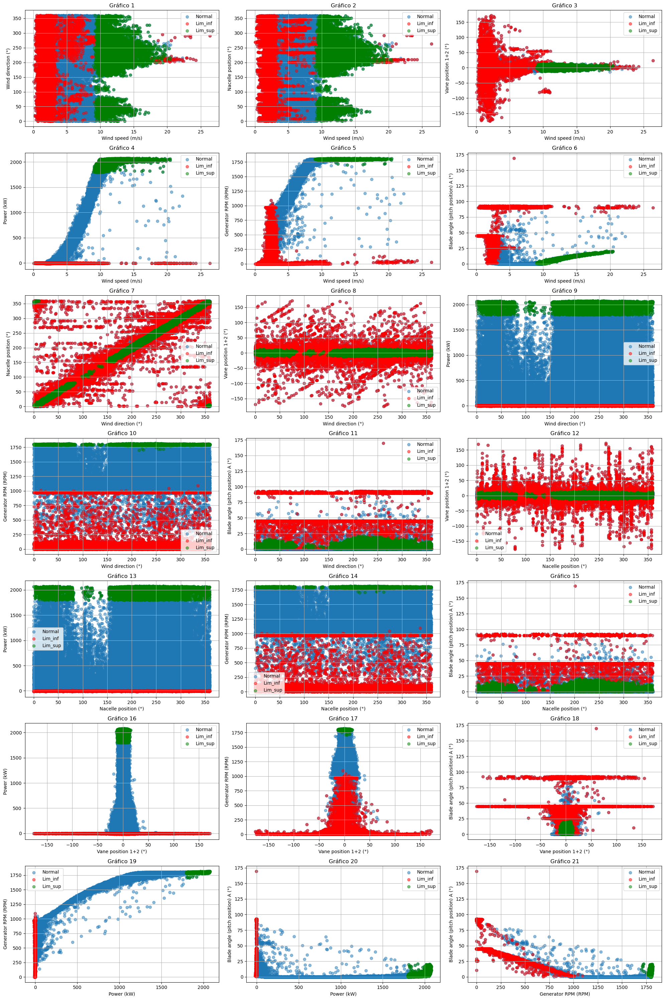

In [150]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02[((df_02[feature]>=a) & (df_02[feature]<b))]



feat = 30
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=2
b=1800

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[feat1::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

Wind speed (m/s)
-1.2974015474319458 10.500736832618713
Média: 6.70
Desvio padrão: 2.94
Quantidade de outliers: 14720


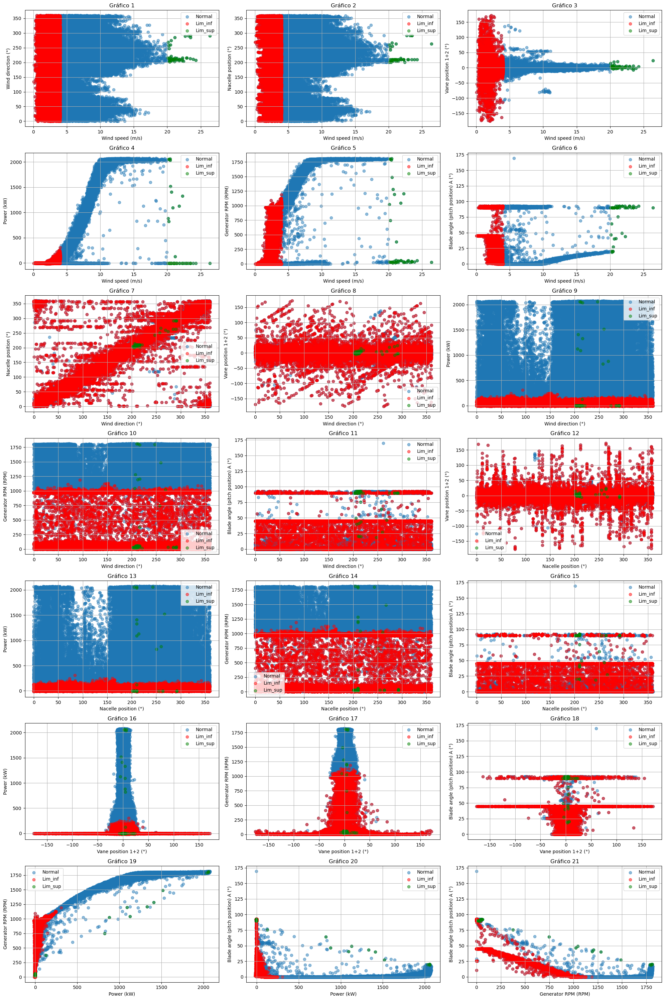

In [151]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02[((df_02[feature]>=a) & (df_02[feature]<b))]



feat = 0
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=4
b=20

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[feat1::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

Wind speed (m/s)
-1.2974015474319458 10.500736832618713
Média: 6.70
Desvio padrão: 2.94
Quantidade de outliers: 14720


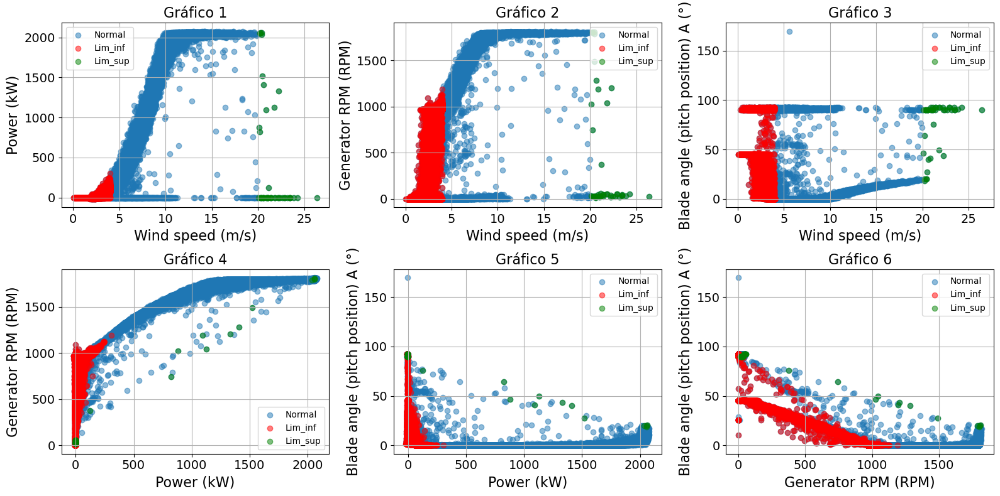

In [152]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02[((df_02[feature]>=a) & (df_02[feature]<b))]



feat = 0
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=4
b=20

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

# lista_out = df_columns_num[feat1::5]
# # Drop em dois elementos distintos da lista lista_out
# lista_out.pop(1)
# lista_out.pop(3)
# lista_out.pop(5)

lista_out = ['Wind speed (m/s)','Power (kW)', 'Generator RPM (RPM)', 'Blade angle (pitch position) A (°)']
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers3(df_analise01, df_analise02, df_analise03, lista_out)

In [153]:
def corrigir_outliers(df_corrigir, df_columns_num):
    """
    Corrige outliers em uma coluna com base em intervalos da velocidade do vento,
    sem usar groupby.

    Parâmetros:
    df (pd.DataFrame): DataFrame contendo os dados.
    coluna_ref (str): Nome da coluna de velocidade do vento usada para definir os intervalos.
    coluna_outlier (str): Nome da coluna para filtrar os outliers
    coluna_corrigir (str): Nome da coluna onde os outliers serão corrigidos.

    Retorna:
    pd.DataFrame: DataFrame com os outliers corrigidos.
    """

    u=0
    for j in list(range(0,5,1)):
        coluna_ref = df_columns_num[j::5][0]
        coluna_outlier = df_columns_num[j::5][9]
        coluna_corrigir1 = df_columns_num[j::5][5]
        coluna_corrigir2 = df_columns_num[j::5][6]
        coluna_corrigir3 = df_columns_num[j::5][8]
        coluna_corrigir4 = df_columns_num[j::5][9]

        if (u == 0):
            df = df_corrigir
            u=1

        # Determina os limites de velocidade do vento
        # minimo = np.floor(df[coluna_ref].min())
        # maximo = np.ceil(df[coluna_ref].max())

        minimo = 4
        maximo = 20

        # Define os intervalos de 0.25
        bins = np.arange(minimo, maximo + 0.5, 0.5)
        
        # Percorre cada faixa de vento e corrige os outliers
        for i in range(len(bins) - 1):
            v_min, v_max = bins[i], bins[i + 1]
            
            # Filtra os dados dentro do intervalo de velocidade
            mask = (df[coluna_ref] >= v_min) & (df[coluna_ref] < v_max)
            dados_intervalo = df.loc[mask, coluna_outlier]

            if len(dados_intervalo) >= 3:  # Precisa de pelo menos 3 valores para calcular desvio
                media = dados_intervalo.mean()
                desvio = dados_intervalo.std()
                mediana = dados_intervalo.median()
                
                # Define limites para considerar outlier (média ± 2 desvios padrão)
                limite_inferior = mediana - 0.5 * desvio
                limite_superior = mediana + 0.5 * desvio

                limite_inferior = 0
                limite_superior = 25
                
                # Corrige os outliers para a média do intervalo
                mediana_coluna_corrigir1 = df.loc[mask & ((df[coluna_outlier] >= limite_inferior) & (df[coluna_outlier] <= limite_superior)), coluna_corrigir1].median()
                df.loc[mask & ((df[coluna_outlier] < limite_inferior) | (df[coluna_outlier] > limite_superior)), coluna_corrigir1] = mediana_coluna_corrigir1

                mediana_coluna_corrigir2 = df.loc[mask & ((df[coluna_outlier] >= limite_inferior) & (df[coluna_outlier] <= limite_superior)), coluna_corrigir2].median()
                df.loc[mask & ((df[coluna_outlier] < limite_inferior) | (df[coluna_outlier] > limite_superior)), coluna_corrigir2] = mediana_coluna_corrigir2

                mediana_coluna_corrigir3 = df.loc[mask & ((df[coluna_outlier] >= limite_inferior) & (df[coluna_outlier] <= limite_superior)), coluna_corrigir3].median()
                df.loc[mask & ((df[coluna_outlier] < limite_inferior) | (df[coluna_outlier] > limite_superior)), coluna_corrigir3] = mediana_coluna_corrigir3

                mediana_coluna_corrigir4 = df.loc[mask & ((df[coluna_outlier] >= limite_inferior) & (df[coluna_outlier] <= limite_superior)), coluna_corrigir4].median()
                df.loc[mask & ((df[coluna_outlier] < limite_inferior) | (df[coluna_outlier] > limite_superior)), coluna_corrigir4] = mediana_coluna_corrigir4

                # if nan_verification(df)['Count'].sum() > 0:
                #     print('Ainda existem valores nulos')
                #     print(f'Turbina: {j}, VELMIN: {v_min}, VELMAX: {v_max}, Qnt intervalo: {len(dados_intervalo)}')
                #     print(f'Mediana pitch: {mediana}, Limites: {limite_inferior} a {limite_superior}')
                #     print(mediana_coluna_corrigir1)
                #     print(mediana_coluna_corrigir2)
                #     print(mediana_coluna_corrigir3)
                #     print(mediana_coluna_corrigir4)
                #     print(nan_verification(df))
            else:
                print('Ainda existem valores nulos')
                print(f'Turbina: {j}, VELMIN: {v_min}, VELMAX: {v_max}, Qnt intervalo: {len(dados_intervalo)}')
                print(f'Mediana pitch: {mediana}, Limites: {limite_inferior} a {limite_superior}')
                print(mediana_coluna_corrigir1)
                print(mediana_coluna_corrigir2)
                print(mediana_coluna_corrigir3)
                print(mediana_coluna_corrigir4)


    return df

In [154]:
def corrigir_outliers_sem_groupby(df, coluna_velocidade, coluna_pitch, coluna_corrigir):
    """
    Corrige outliers em uma coluna com base em intervalos da velocidade do vento,
    sem usar groupby.

    Parâmetros:
    df (pd.DataFrame): DataFrame contendo os dados.
    coluna_velocidade (str): Nome da coluna de velocidade do vento usada para definir os intervalos.
    coluna_corrigir (str): Nome da coluna onde os outliers serão corrigidos.

    Retorna:
    pd.DataFrame: DataFrame com os outliers corrigidos.
    """
    
    # Determina os limites de velocidade do vento
    minimo = np.floor(df[coluna_velocidade].min())
    maximo = np.ceil(df[coluna_velocidade].max())

    minimo = 4
    maximo = 20

    # Define os intervalos de 0.25
    bins = np.arange(minimo, maximo + 0.25, 0.25)
    
    # Percorre cada faixa de vento e corrige os outliers
    for i in range(len(bins) - 1):
        v_min, v_max = bins[i], bins[i + 1]
        
        # Filtra os dados dentro do intervalo de velocidade
        mask = (df[coluna_velocidade] >= v_min) & (df[coluna_velocidade] < v_max)
        dados_intervalo = df.loc[mask, coluna_pitch]
        
        if len(dados_intervalo) >= 3:  # Precisa de pelo menos 3 valores para calcular desvio
            media = dados_intervalo.mean()
            desvio = dados_intervalo.std()
            mediana = dados_intervalo.median()
            
            # Define limites para considerar outlier (média ± 2 desvios padrão)
            limite_inferior = mediana - 0.5 * desvio
            limite_superior = mediana + 0.5 * desvio

            limite_inferior = 0
            limite_superior = 25
            
            # Corrige os outliers para a média do intervalo
            mediana_corrigir = df.loc[mask & ((df[coluna_pitch] >= limite_inferior) & (df[coluna_pitch] <= limite_superior)), coluna_corrigir].median()
            df.loc[mask & ((df[coluna_pitch] < limite_inferior) | (df[coluna_pitch] > limite_superior)), coluna_corrigir] = mediana_corrigir
            print(len(dados_intervalo))
            print(v_min)
            print(mediana_corrigir)
            print(nan_verification(df))

    return df

In [155]:
df_02_corrigido = df_01.copy()

df_02_corrigido = corrigir_outliers(df_02_corrigido, df_columns_num)

In [156]:
df_02_tcorrigido = df_01t.copy()

df_02_tcorrigido = corrigir_outliers(df_02_tcorrigido, df_columns_num)

Ainda existem valores nulos
Turbina: 1, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 1
Mediana pitch: 18.6505515273045, Limites: 0 a 25
-0.360121813416477
2045.6134765625
1795.48289108276
18.6505515273045
Ainda existem valores nulos
Turbina: 3, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 2
Mediana pitch: 17.673343140921, Limites: 0 a 25
3.65787850618362
2037.21833496094
1799.08678556744
17.6108282148348
Ainda existem valores nulos
Turbina: 4, VELMIN: 18.0, VELMAX: 18.5, Qnt intervalo: 1
Mediana pitch: 16.80886930476245, Limites: 0 a 25
2.8228744912892516
2042.43601379395
1793.809311866759
16.80886930476245
Ainda existem valores nulos
Turbina: 4, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 1
Mediana pitch: 18.8179922897806, Limites: 0 a 25
1.48476157411933
2035.0425720214848
1793.306385040285
18.4984889610393


In [157]:
nan_verification(df_02_corrigido)['Count'].sum()

0

In [158]:
nan_verification(df_02_tcorrigido)['Count'].sum()

0

Power (kW)
-1472.5159540828909 1843.81431844109
Média: 773.20
Desvio padrão: 682.57
Quantidade de outliers: 17977


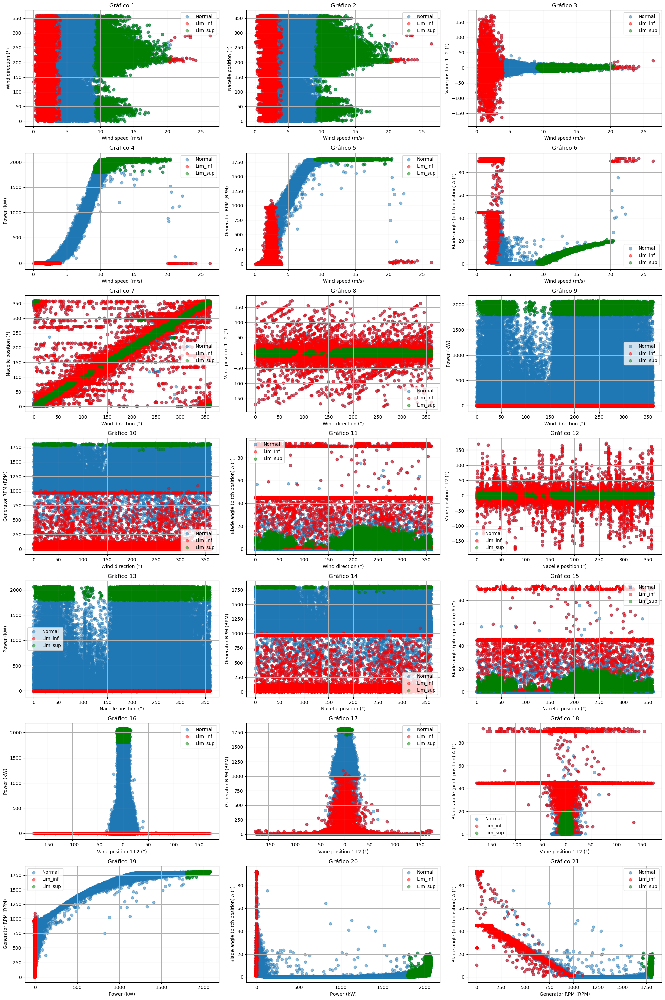

In [159]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02_corrigido[((df_02_corrigido[feature]>=a) & (df_02_corrigido[feature]<b))]



feat = 30
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=2
b=1800

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[feat1::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

Wind speed (m/s)
-1.2974015474319458 10.500736832618713
Média: 6.70
Desvio padrão: 2.94
Quantidade de outliers: 14720


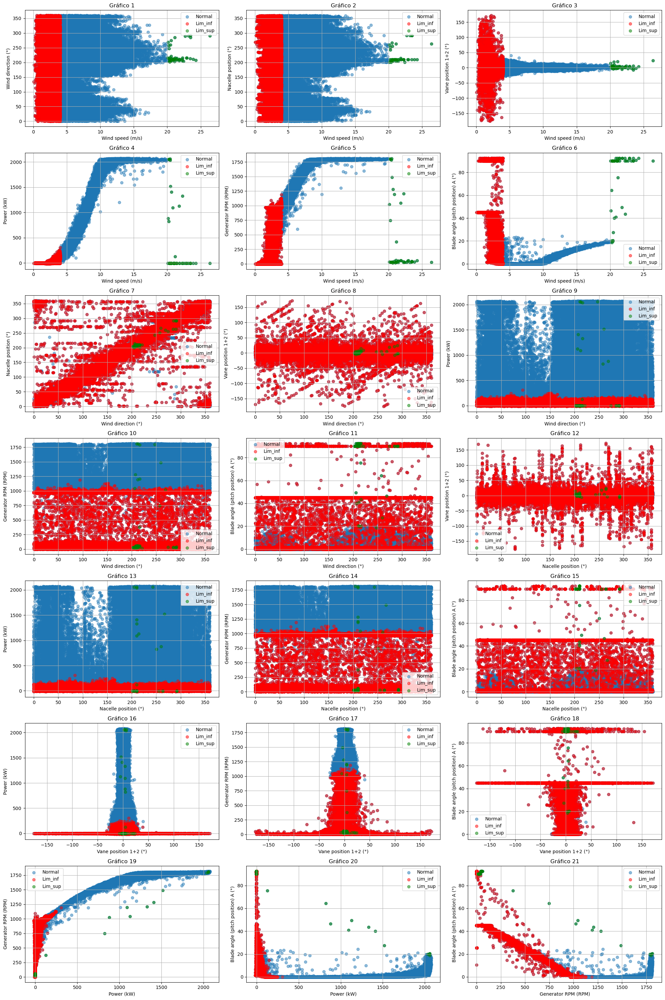

In [160]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02_corrigido[((df_02_corrigido[feature]>=a) & (df_02_corrigido[feature]<b))]



feat = 0
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=4
b=20

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[feat1::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

Wind speed (m/s)
-1.2974015474319458 10.500736832618713
Média: 6.70
Desvio padrão: 2.94
Quantidade de outliers: 14720


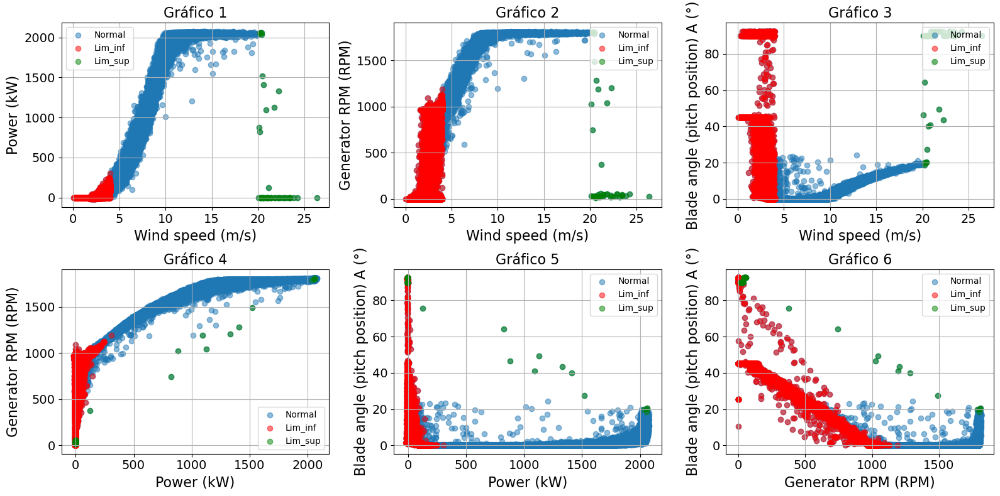

In [161]:
# Escolhendo uma faixa de velocidade
feat1 = 0
list_feat = df_columns_num[feat1:feat1+5]
feature = df_columns_num[feat1]

a=0
b=27

df_analise =  df_02_corrigido[((df_02_corrigido[feature]>=a) & (df_02_corrigido[feature]<b))]



feat = 0
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = media - 2 * desvio
limite_superior = media + 2 * desvio
(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=4
b=20

df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

# lista_out = df_columns_num[feat1::5]
# # Drop em dois elementos distintos da lista lista_out
# lista_out.pop(1)
# lista_out.pop(3)
# lista_out.pop(5)

lista_out = ['Wind speed (m/s)','Power (kW)', 'Generator RPM (RPM)', 'Blade angle (pitch position) A (°)']
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers3(df_analise01, df_analise02, df_analise03, lista_out)

Blade angle (pitch position) A (°)
-2.0318560180338947 2.0318560180338947
Média: 4.68
Desvio padrão: 13.01
Mediana: 0.02
-6.479790077779968 6.528789569858987
Quantidade de outliers: 5800


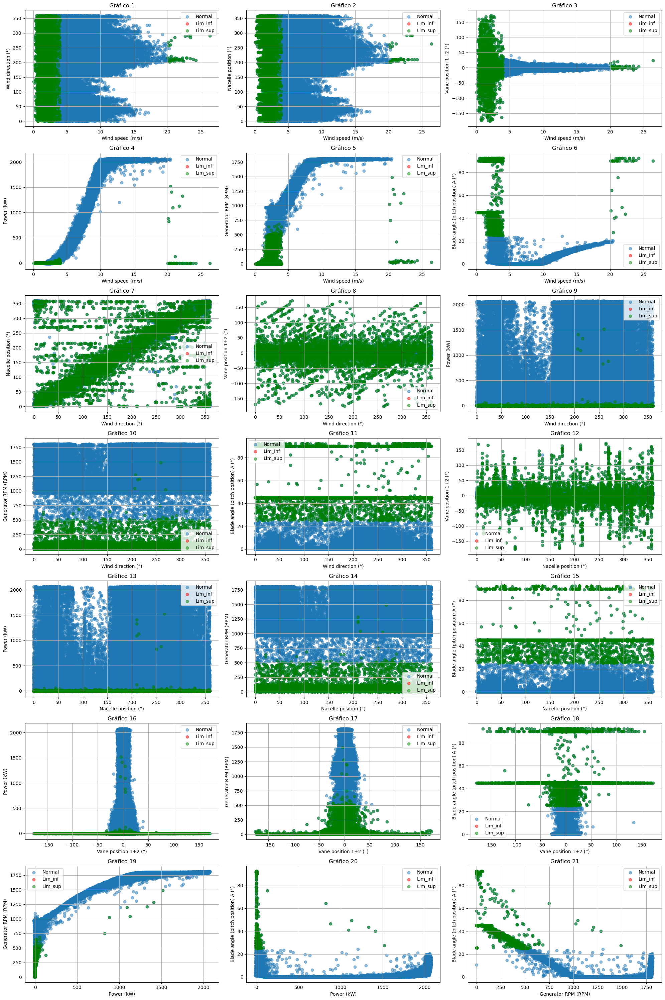

In [162]:
feat = 45
list_feat = df_columns_num[feat:feat+5]
feature = df_columns_num[feat]
print(feature)
# data = df_02
data = df_analise
a, b = outliers(data, feature)
print(a,b)



media = df_analise[feature].mean()  # Média do intervalo
desvio = df_analise[feature].std()  # Desvio padrão
mediana = df_analise[feature].median()  # Mediana
print(f'Média: {media:.2f}')
print(f'Desvio padrão: {desvio:.2f}')
print(f'Mediana: {mediana:.2f}')

# Define limites de outlier (média ± 2 desvios padrão)
limite_inferior = mediana - 0.5 * desvio
limite_superior = mediana + 0.5 * desvio
print(limite_inferior, limite_superior)




a=limite_inferior
b=limite_superior

a=-0.1
b=25


df_outliers = data[(data[feature]<a) | (data[feature]>b)].reset_index()
print('Quantidade de outliers:', len(df_outliers))

lista_out = df_columns_num[feat1::5]
# Drop em dois elementos distintos da lista lista_out
lista_out.pop(1)
lista_out.pop(3)
lista_out.pop(5)
lista_out

df_analise02 =  data
df_analise01 =  df_analise02[((df_analise02[feature]<a))]
df_analise03 =  df_analise02[((df_analise02[feature]>b))]

# Resultado da primeira análise e segunda análise
# df_analise01 =  df_analise02[(df_analise02[feature]<-30) | (df_analise02[feature]>30)]

graph_outliers2(df_analise01, df_analise02, df_analise03, lista_out)

In [163]:
def identificacao_outliers(df_corrigir, df_columns_num):
    """
    Corrige outliers em uma coluna com base em intervalos da velocidade do vento,
    sem usar groupby.

    Parâmetros:
    df (pd.DataFrame): DataFrame contendo os dados.
    coluna_ref (str): Nome da coluna de velocidade do vento usada para definir os intervalos.
    coluna_outlier (str): Nome da coluna para filtrar os outliers
    coluna_corrigir (str): Nome da coluna onde os outliers serão corrigidos.

    Retorna:
    pd.DataFrame: DataFrame com os outliers corrigidos.
    """
    df_columns_num = df_columns_num + ['Outlier', 'Outlier.1', 'Outlier.2', 'Outlier.3', 'Outlier.4']

    df_corrigir['Outlier'] = 0
    df_corrigir['Outlier.1'] = 0
    df_corrigir['Outlier.2'] = 0
    df_corrigir['Outlier.3'] = 0
    df_corrigir['Outlier.4'] = 0

    u=0
    for j in list(range(0,5,1)):
        coluna_ref = df_columns_num[j::5][0]
        coluna_outlier = df_columns_num[j::5][9]

        coluna_corrigir1 = df_columns_num[j::5][5]
        coluna_corrigir2 = df_columns_num[j::5][6]
        coluna_corrigir3 = df_columns_num[j::5][8]
        coluna_corrigir4 = df_columns_num[j::5][9]
        coluna_ident_out = df_columns_num[j::5][10]

        if (u == 0):
            df = df_corrigir
            u=1

        # Determina os limites de velocidade do vento
        # minimo = np.floor(df[coluna_ref].min())
        # maximo = np.ceil(df[coluna_ref].max())

        minimo = 4
        maximo = 20

        # Define os intervalos de 0.25
        bins = np.arange(minimo, maximo + 0.5, 0.5)
        
        # Percorre cada faixa de vento e corrige os outliers
        for i in range(len(bins) - 1):
            v_min, v_max = bins[i], bins[i + 1]
            
            # Filtra os dados dentro do intervalo de velocidade
            mask = (df[coluna_ref] >= v_min) & (df[coluna_ref] < v_max)
            dados_intervalo = df.loc[mask, coluna_outlier]
            
            if len(dados_intervalo) >= 3:  # Precisa de pelo menos 3 valores para calcular desvio
                media = dados_intervalo.mean()
                desvio = dados_intervalo.std()
                mediana = dados_intervalo.median()
                
                # Define limites para considerar outlier (média ± 2 desvios padrão)
                limite_inferior = mediana - 0.5 * desvio
                limite_superior = mediana + 0.5 * desvio

                limite_inferior = 0
                limite_superior = 25
                
                # Realizar a identificação dos outliers
                df.loc[mask & ((df[coluna_outlier] < limite_inferior) | 
                               (df[coluna_outlier] > limite_superior)) & 
                               (df[coluna_ident_out] == 0), coluna_ident_out] = 1

            else:
                print('Ainda existem valores nulos')
                print(f'Turbina: {j}, VELMIN: {v_min}, VELMAX: {v_max}, Qnt intervalo: {len(dados_intervalo)}')
                print(f'Mediana pitch: {mediana}, Limites: {limite_inferior} a {limite_superior}')


    return df, df_columns_num

In [164]:
df_02_corrigido2 = df_01.copy()


df_columns_num_2 = df_columns_num.copy()

df_02_corrigido2, df_columns_num_2 = identificacao_outliers(df_02_corrigido2, df_columns_num_2)

In [165]:
df_02_tcorrigido2 = df_01t.copy()

df_columns_num_2 = df_columns_num.copy()

df_02_tcorrigido2, df_columns_num_2 = identificacao_outliers(df_02_tcorrigido2, df_columns_num_2)

Ainda existem valores nulos
Turbina: 1, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 1
Mediana pitch: 18.6505515273045, Limites: 0 a 25
Ainda existem valores nulos
Turbina: 3, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 2
Mediana pitch: 17.673343140921, Limites: 0 a 25
Ainda existem valores nulos
Turbina: 4, VELMIN: 18.0, VELMAX: 18.5, Qnt intervalo: 1
Mediana pitch: 16.80886930476245, Limites: 0 a 25
Ainda existem valores nulos
Turbina: 4, VELMIN: 19.5, VELMAX: 20.0, Qnt intervalo: 1
Mediana pitch: 18.8179922897806, Limites: 0 a 25


In [166]:
df_02_corrigido2.head()

,Timestamp,Wind speed (m/s),Wind speed (m/s).1,Wind speed (m/s).2,Wind speed (m/s).3,Wind speed (m/s).4,"Wind speed, Standard deviation (m/s)","Wind speed, Standard deviation (m/s).1","Wind speed, Standard deviation (m/s).2","Wind speed, Standard deviation (m/s).3","Wind speed, Standard deviation (m/s).4",Wind direction (°),Wind direction (°).1,Wind direction (°).2,Wind direction (°).3,Wind direction (°).4,Nacelle position (°),Nacelle position (°).1,Nacelle position (°).2,Nacelle position (°).3,Nacelle position (°).4,"Nacelle position, Standard deviation (°)","Nacelle position, Standard deviation (°).1","Nacelle position, Standard deviation (°).2","Nacelle position, Standard deviation (°).3","Nacelle position, Standard deviation (°).4",Vane position 1+2 (°),Vane position 1+2 (°).1,Vane position 1+2 (°).2,Vane position 1+2 (°).3,Vane position 1+2 (°).4,Power (kW),Power (kW).1,Power (kW).2,Power (kW).3,Power (kW).4,Nacelle ambient temperature (°C),Nacelle ambient temperature (°C).1,Nacelle ambient temperature (°C).2,Nacelle ambient temperature (°C).3,Nacelle ambient temperature (°C).4,Generator RPM (RPM),Generator RPM (RPM).1,Generator RPM (RPM).2,Generator RPM (RPM).3,Generator RPM (RPM).4,Blade angle (pitch position) A (°),Blade angle (pitch position) A (°).1,Blade angle (pitch position) A (°).2,Blade angle (pitch position) A (°).3,Blade angle (pitch position) A (°).4,target_feature,mês,dia,hora,Outlier,Outlier.1,Outlier.2,Outlier.3,Outlier.4
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
163321,2020-11-08 04:10:00,3.927720,3.664913,3.226671,3.425790,3.132243,0.608735,0.345092,0.678411,0.469404,0.445127,97.783188,93.681766,86.890968,87.206769,93.578660,111.093750,105.848948,98.341522,93.639260,100.969143,0.000000,16.919757,0.000000,15.662936,12.683243,-14.263317,-12.067427,-9.600908,-9.254161,-9.677602,102.316301,48.138595,33.175789,31.737232,32.813428,9.887500,9.592500,10.200000,8.957500,10.200000,978.638002,1073.413450,965.098783,966.096519,1069.722937,0.344500,1.315000,1.139500,1.212500,1.415000,3.290674,11,8,4,0,0,0,0,0
160480,2020-10-19 10:40:00,6.225795,7.039111,6.724625,5.391021,6.642078,0.946054,1.203038,1.030015,0.919955,0.981680,174.369676,178.596296,173.679432,176.590578,177.828322,181.338318,179.020294,169.683014,169.854370,174.727173,0.000000,0.000000,0.000000,0.000000,0.000000,-4.894380,-2.513735,3.539405,6.802102,-0.284752,513.754388,759.283351,643.982465,369.042505,652.908498,11.070000,11.022500,11.620000,10.530000,11.635000,1379.232519,1553.641394,1478.523920,1255.451523,1477.768238,0.000000,0.000000,0.000000,0.000000,0.000000,6.034174,10,19,10,0,0,0,0,0
130549,2020-03-25 14:10:00,2.975279,2.983613,3.189230,2.833432,3.434939,1.058778,0.625439,0.652945,0.923831,0.825278,135.860971,128.430711,135.362105,110.579044,125.291989,126.461060,137.313950,130.184502,117.179284,133.513672,0.000000,0.000000,18.390088,8.544046,2.155274,7.859487,-12.044405,8.706620,-6.226095,-9.105625,46.477956,9.098861,27.695860,-4.016771,27.042203,15.237500,14.400000,14.680000,14.787500,15.395000,970.168081,1067.391071,963.844826,497.831827,741.002985,0.917505,2.139029,1.140001,24.842225,16.780516,2.929406,3,25,14,0,0,0,0,0
177254,2021-02-12 22:20:00,9.457693,9.955336,9.538719,9.048743,8.184713,1.345555,2.055283,1.146529,1.330878,1.540771,111.026914,109.733430,109.134608,101.245358,115.502472,111.873821,110.971268,103.829842,101.805542,94.605568,5.526765,0.000000,0.000000,0.000000,0.000000,-0.621270,-4.235995,3.629187,0.864063,20.909503,1941.727014,1764.015543,1762.509369,1691.908502,-6.240350,-2.400000,-2.510000,-2.600000,-2.725000,-1.517500,1797.936144,1794.937403,1794.186453,1793.313189,5.063133,2.192000,2.667500,0.927000,1.260000,91.949997,7.919011,2,12,22,0,0,0,0,1
72996,2019-02-19 22:00:00,8.740287,6.627789,8.264002,8.499175,7.552344,1.004934,1.369186,0.987997,1.235915,1.299940,205.966826,215.447355,207.902755,203.989289,207.273701,207.681091,217.436188,209.196381,208.269684,205.460999,0.000000,0.000000,0.000000,0.000

## Teste

In [225]:
X_train = df_02_corrigido[df_columns_num].values
y_train = df_02_corrigido[target].values
X_test = df_02_tcorrigido[df_columns_num].values
y_test = df_02_tcorrigido[target].values
nome_df = 'df_02_corrigido_df_columns_num'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.39368271827697754
FIM XGB: 1.841069221496582
FIM LGBM: 1.7895808219909668
FIM KS34: 1.8480420112609863
Teste de K-S entre XGB e LGBM. statistic: 0.010795142186016293, p-value: 0.19270605500632298


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623


In [226]:
X_train = df_02_corrigido2[df_columns_num_2].values
y_train = df_02_corrigido2[target].values
X_test = df_02_tcorrigido2[df_columns_num_2].values
y_test = df_02_tcorrigido2[target].values
nome_df = 'df_02_corrigido2_df_columns_num_2'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.4504508972167969
FIM XGB: 1.785353660583496
FIM LGBM: 2.1720733642578125
FIM KS34: 1.794072151184082
Teste de K-S entre XGB e LGBM. statistic: 0.01284422010095454, p-value: 0.07307185723256804


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146


In [227]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146


## Versão 3 - Trantando valores ausentes

In [168]:
# Retirando do df as linhas com valores ausentes em qualquer coluna fora as colunas que possuem mais de 2000 registros ausentes.
df_nan = nan_verification(df[df_columns_num])

list_base_nan = list(df_nan[df_nan['Count'] > 2000].index)
list_base_compl = list(df_nan[df_nan['Count'] <= 2000].index)

In [169]:
df_03  = df[~df[list_base_compl+target].isna().any(axis=1)].copy()
nan_verification(df_03)


,Count,Perc
"Wind speed, Standard deviation (m/s).1",22873,22.235076
Wind speed (m/s).1,22873,22.235076
Vane position 1+2 (°).1,22871,22.233131
Generator RPM (RPM).1,22871,22.233131
Wind direction (°).1,22871,22.233131
"Nacelle position, Standard deviation (°).1",22871,22.233131
Blade angle (pitch position) A (°).1,22871,22.233131
Nacelle ambient temperature (°C).1,22871,22.233131
Power (kW).1,22871,22.233131
Nacelle position (°).1,22871,22.233131


In [170]:
print('Quantidade de linhas inicialmente:', len(df))
print('Quantidade de linhas apagadas:', len(df)-len(df_03))
print('Porcentagem de linhas apagadas:', ((len(df)-len(df_03))/len(df_03))*100)

Quantidade de linhas inicialmente: 103530
Quantidade de linhas apagadas: 661
Porcentagem de linhas apagadas: 0.6425648154448862


In [171]:
df_03t  = dft[~dft[list_base_compl+target].isna().any(axis=1)].copy()
nan_verification(df_03t)

,Count,Perc
Vane position 1+2 (°).1,5720,22.231723
"Wind speed, Standard deviation (m/s).1",5720,22.231723
Generator RPM (RPM).1,5720,22.231723
Wind direction (°).1,5720,22.231723
"Nacelle position, Standard deviation (°).1",5720,22.231723
Blade angle (pitch position) A (°).1,5720,22.231723
Nacelle ambient temperature (°C).1,5720,22.231723
Power (kW).1,5720,22.231723
Wind speed (m/s).1,5720,22.231723
Nacelle position (°).1,5720,22.231723


In [172]:
# Avaliação do melhor método para preenchimento de valores faltantes
data = df_03 # Mudar para  Dataset de referência

for i in list_base_nan:
    # Preenchimento por modelo linear
    mask_null = data[i].isna()
    X_fill = data[list_base_compl][~mask_null].values
    y_fill = data[i][~mask_null].values

    X_train_fill, X_test_fill, y_train_fill, y_test_fill = train_test_split(X_fill, y_fill, test_size=0.3)

    lr_fill = LinearRegression()
    lr_fill.fit(X_train_fill, y_train_fill)

    y_pred_lr_fill = lr_fill.predict(X_test_fill)

    # Preenchimento pela média
    media = data[i].mean()
    print('Valor média = ', media)

    # Comparação dos erros
    mae_lr_fill = mean_absolute_error(y_test_fill, y_pred_lr_fill)
    mae_mean_fill = np.mean(np.abs(y_test_fill - media))

    print(i)
    print('MAE(Linear) =', mae_lr_fill)
    print('MAE(Média) =', mae_mean_fill)
    print("")

Valor média =  0.9290795684545332
Wind speed, Standard deviation (m/s).1
MAE(Linear) = 0.17287186149484637
MAE(Média) = 0.37033613949201166

Valor média =  -0.2636892757024641
Vane position 1+2 (°).1
MAE(Linear) = 6.433293707771162
MAE(Média) = 7.506011269657017

Valor média =  6.769085284342239
Blade angle (pitch position) A (°).1
MAE(Linear) = 5.132314918564618
MAE(Média) = 10.446597840386113

Valor média =  10.250925117931871
Nacelle ambient temperature (°C).1
MAE(Linear) = 0.10910563255862811
MAE(Média) = 4.923789037937827

Valor média =  1.5058595365685972
Nacelle position, Standard deviation (°).1
MAE(Linear) = 1.8994659331672183
MAE(Média) = 2.417933226637315

Valor média =  6.307164539722596
Wind speed (m/s).1
MAE(Linear) = 0.6319859531303691
MAE(Média) = 2.234687316544745

Valor média =  204.55656316467133
Nacelle position (°).1
MAE(Linear) = 10.555014891174013
MAE(Média) = 74.0934658520211

Valor média =  652.1068843616155
Power (kW).1
MAE(Linear) = 143.51270859509614
MAE(Méd

In [173]:
# Aplicando o preenchimento

def linear_inputnan(data,list_base_nan,list_base_compl):
    for i in list_base_nan:
        mask_null = data[i].isna()
        X_fill = data[list_base_compl][~mask_null].values
        y_fill = data[i][~mask_null].values

        lr_fill = LinearRegression()
        lr_fill.fit(X_fill, y_fill)

        X_fill2 = data[mask_null][list_base_compl].values
        X_fill2
        y_pred_fill2 = lr_fill.predict(X_fill2)

        data.loc[data[mask_null].index, i] = y_pred_fill2

        data[mask_null]
    return data

In [174]:
df_03_linear = linear_inputnan(df_03,list_base_nan,list_base_compl).copy()
df_03t_linear = linear_inputnan(df_03t,list_base_nan,list_base_compl).copy()

In [175]:
nan_verification(df_03_linear)['Count'].sum()

0

In [176]:
nan_verification(df_03t_linear)['Count'].sum()

0

In [177]:
from sklearn.impute import SimpleImputer

# Aplicando o preenchimento SimpleImputer com Média
def linear_inputmean(data,list_base_nan):
    imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
    imputer = imputer.fit(data[list_base_nan])
    data[list_base_nan] = imputer.transform(data[list_base_nan])
    return data

In [178]:
df_03_mean = linear_inputmean(df_03,list_base_nan)
df_03t_mean = linear_inputmean(df_03t,list_base_nan)

In [179]:
nan_verification(df_03_mean)['Count'].sum()

0

In [180]:
nan_verification(df_03t_mean)['Count'].sum()

0

In [181]:
df_03_outros  = df[df[list_base_compl+target].isna().any(axis=1)].copy()
nan_verification(df_03_outros)

,Count,Perc
Vane position 1+2 (°).4,449,67.927383
Nacelle ambient temperature (°C).4,447,67.624811
Blade angle (pitch position) A (°).4,446,67.473525
"Wind speed, Standard deviation (m/s).3",390,59.001513
Vane position 1+2 (°).2,387,58.547655
Blade angle (pitch position) A (°).2,386,58.396369
Nacelle ambient temperature (°C).2,386,58.396369
Blade angle (pitch position) A (°).3,385,58.245083
Nacelle ambient temperature (°C).3,385,58.245083
Vane position 1+2 (°).3,385,58.245083


In [182]:
df_03t_outros  = dft[dft[list_base_compl+target].isna().any(axis=1)].copy()
nan_verification(df_03t_outros)

,Count,Perc
Blade angle (pitch position) A (°).4,95,61.688312
Nacelle ambient temperature (°C).4,95,61.688312
Vane position 1+2 (°).4,95,61.688312
Vane position 1+2 (°),83,53.896104
Blade angle (pitch position) A (°),83,53.896104
"Wind speed, Standard deviation (m/s).3",83,53.896104
Nacelle ambient temperature (°C),83,53.896104
"Wind speed, Standard deviation (m/s).1",82,53.246753
Vane position 1+2 (°).2,80,51.948052
Blade angle (pitch position) A (°).3,80,51.948052


In [183]:
df_nan = nan_verification(df_03_outros[df_columns_num])

list_base_nan_outros = list(df_nan[df_nan['Count'] > 0].index)
list_base_nan_outros

['Vane position 1+2 (°).4',
 'Nacelle ambient temperature (°C).4',
 'Blade angle (pitch position) A (°).4',
 'Wind speed, Standard deviation (m/s).3',
 'Vane position 1+2 (°).2',
 'Blade angle (pitch position) A (°).2',
 'Nacelle ambient temperature (°C).2',
 'Blade angle (pitch position) A (°).3',
 'Nacelle ambient temperature (°C).3',
 'Vane position 1+2 (°).3',
 'Blade angle (pitch position) A (°)',
 'Nacelle ambient temperature (°C)',
 'Vane position 1+2 (°)',
 'Wind speed, Standard deviation (m/s).1',
 'Nacelle ambient temperature (°C).1',
 'Vane position 1+2 (°).1',
 'Blade angle (pitch position) A (°).1',
 'Wind speed, Standard deviation (m/s).4',
 'Nacelle position, Standard deviation (°).4',
 'Nacelle position, Standard deviation (°).2',
 'Wind speed, Standard deviation (m/s).2',
 'Nacelle position, Standard deviation (°).3',
 'Wind speed, Standard deviation (m/s)',
 'Nacelle position, Standard deviation (°)',
 'Nacelle position, Standard deviation (°).1',
 'Wind speed (m/s).3

In [184]:
df_03_outros = linear_inputmean(df_03_outros,list_base_nan_outros)
df_03t_outros = linear_inputmean(df_03t_outros,list_base_nan_outros)

In [185]:
nan_verification(df_03_outros)['Count'].sum()

0

In [186]:
nan_verification(df_03t_outros)['Count'].sum()

0

In [187]:
print(df_03_mean.shape, df_03_outros.shape)
print((df_03_mean.columns == df_03_outros.columns).sum())

(102869, 55) (661, 55)
55


In [188]:
len(df_03_mean), len(df_03t_mean)

(102869, 25729)

In [189]:
# Junta os dois dataframes, um embaixo do outro (por linhas)
df_03_mean_outros = pd.concat([df_03_mean, df_03_outros], ignore_index=False)
df_03t_mean_outros = pd.concat([df_03t_mean, df_03t_outros], ignore_index=False)

In [190]:
len(df_03_mean_outros), len(df_03t_mean_outros)

(103530, 25883)

In [191]:
len(df_03_linear), len(df_03t_linear)

(102869, 25729)

In [192]:
# Junta os dois dataframes, um embaixo do outro (por linhas)
df_03_linear_outros = pd.concat([df_03_linear, df_03_outros], ignore_index=False)
df_03t_linear_outros = pd.concat([df_03t_linear, df_03t_outros], ignore_index=False)

In [193]:
len(df_03_linear_outros), len(df_03t_linear_outros)

(103530, 25883)

In [194]:
len(df), len(dft)

(103530, 25883)

## Teste

In [ ]:
# X_train = df_03_linear[df_columns_num].values
# y_train = df_03_linear[target].values
# X_test = df_03t_linear[df_columns_num].values
# y_test = df_03t_linear[target].values
# nome_df = 'df_03_linear_df_columns_num'   

# df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
# df_comparacao

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025698 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Number of data points in the train set: 102869, number of used features: 50
[LightGBM] [Info] Start training from score 6.337071


,nome_df,modelo,MAE,MSE,RMSE,R2,Tempo
0,df_03_linear_df_columns_num,Linear Regression,0.534713,0.581169,0.762344,0.927507,0.510448
1,df_03_linear_df_columns_num,XGBoost,0.327015,0.187631,0.433164,0.976596,2.563809
2,df_03_linear_df_columns_num,LightGBM,0.332508,0.195342,0.441976,0.975634,2.188720


In [ ]:
# X_train = df_03_linear[list_corr].values
# y_train = df_03_linear[target].values
# X_test = df_03t_linear[list_corr].values
# y_test = df_03t_linear[target].values
# nome_df = 'df_03_linear_list_corr'   

# df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
# df_comparacao

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021606 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10200
[LightGBM] [Info] Number of data points in the train set: 102869, number of used features: 40
[LightGBM] [Info] Start training from score 6.337071


,nome_df,modelo,MAE,MSE,RMSE,R2,Tempo
0,df_03_linear_list_corr,Linear Regression,0.535300,0.583417,0.763817,0.927227,0.434334
1,df_03_linear_list_corr,XGBoost,0.324704,0.185606,0.430820,0.976848,2.067831
2,df_03_linear_list_corr,LightGBM,0.331969,0.194484,0.441004,0.975741,1.470177


In [255]:
X_train = df_03_linear_outros[list_corr].values
y_train = df_03_linear_outros[target].values
X_test = df_03t_linear_outros[list_corr].values
y_test = df_03t_linear_outros[target].values
nome_df = 'df_03_linear_outros_list_corr'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.4201698303222656
FIM XGB: 1.8591444492340088
FIM LGBM: 1.8041813373565674
FIM KS34: 1.9117457866668701
Teste de K-S entre XGB e LGBM. statistic: 0.015415523702816514, p-value: 0.004218054163111809


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927


In [ ]:
# X_train = df_03_mean[df_columns_num].values
# y_train = df_03_mean[target].values
# X_test = df_03t_mean[df_columns_num].values
# y_test = df_03t_mean[target].values
# nome_df = 'df_03_mean_df_columns_num'   

# df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
# df_comparacao

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023056 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Number of data points in the train set: 102869, number of used features: 50
[LightGBM] [Info] Start training from score 6.337071


,nome_df,modelo,MAE,MSE,RMSE,R2,Tempo
0,df_03_mean_df_columns_num,Linear Regression,0.534713,0.581169,0.762344,0.927507,0.560312
1,df_03_mean_df_columns_num,XGBoost,0.327015,0.187631,0.433164,0.976596,2.435318
2,df_03_mean_df_columns_num,LightGBM,0.332508,0.195342,0.441976,0.975634,1.564993


In [ ]:
# X_train = df_03_mean[list_corr].values
# y_train = df_03_mean[target].values
# X_test = df_03t_mean[list_corr].values
# y_test = df_03t_mean[target].values
# nome_df = 'df_03_mean_list_corr'   

# df_comparacao = avaliar_modelos(X_train, X_test, y_train, y_test, nome_df)
# df_comparacao

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017262 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10200
[LightGBM] [Info] Number of data points in the train set: 102869, number of used features: 40
[LightGBM] [Info] Start training from score 6.337071


,nome_df,modelo,MAE,MSE,RMSE,R2,Tempo
0,df_03_mean_list_corr,Linear Regression,0.535300,0.583417,0.763817,0.927227,0.493299
1,df_03_mean_list_corr,XGBoost,0.324704,0.185606,0.430820,0.976848,1.763064
2,df_03_mean_list_corr,LightGBM,0.331969,0.194484,0.441004,0.975741,1.186901


In [256]:
X_train = df_03_mean_outros[list_corr].values
y_train = df_03_mean_outros[target].values
X_test = df_03t_mean_outros[list_corr].values
y_test = df_03t_mean_outros[target].values
nome_df = 'df_03_mean_outros_list_corr'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.33756113052368164
FIM XGB: 1.7172062397003174
FIM LGBM: 1.9160280227661133
FIM KS34: 1.76521635055542
Teste de K-S entre XGB e LGBM. statistic: 0.015415523702816514, p-value: 0.004218054163111809


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244


In [257]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244


## Versão 4 - Normalização/Padronização

In [195]:
df_04 = df_03_linear_outros.copy()
df_04t = df_03t_linear_outros.copy()

## Teste

In [270]:
X_train = df_04[list_corr].values
y_train = df_04[target].values
X_test = df_04t[list_corr].values
y_test = df_04t[target].values
nome_df = 'df_04_minmaxscaler_list_corr'  

df_comparacao = avaliar_modelos2_scaler(X_train, X_test, y_train, y_test, nome_df, model_scaler = MinMaxScaler)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.45934200286865234
FIM XGB: 1.9338529109954834
FIM LGBM: 1.9207932949066162
FIM KS34: 1.995204210281372
Teste de K-S entre XGB e LGBM. statistic: 0.01336784762199128, p-value: 0.019422494202066452


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,3.915998


In [271]:
X_train = df_04[list_corr].values
y_train = df_04[target].values
X_test = df_04t[list_corr].values
y_test = df_04t[target].values
nome_df = 'df_04_RobustScaler_list_corr'  

df_comparacao = avaliar_modelos2_scaler(X_train, X_test, y_train, y_test, nome_df, model_scaler = RobustScaler)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.4425075054168701
FIM XGB: 1.9281203746795654
FIM LGBM: 1.86551833152771
FIM KS34: 1.9819343090057373
Teste de K-S entre XGB e LGBM. statistic: 0.014101920179268257, p-value: 0.011518585189296614


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


In [272]:
X_train = df_04[list_corr].values
y_train = df_04[target].values
X_test = df_04t[list_corr].values
y_test = df_04t[target].values
nome_df = 'df_04_StandardScaler_list_corr'  

df_comparacao = avaliar_modelos2_scaler(X_train, X_test, y_train, y_test, nome_df, model_scaler = StandardScaler)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.4399740695953369
FIM XGB: 1.677765130996704
FIM LGBM: 1.88258695602417
FIM KS34: 1.7299184799194336
Teste de K-S entre XGB e LGBM. statistic: 0.016574585635359185, p-value: 0.001614084399466027


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_04_StandardScaler_list_corr,0.535106,,0.324106,0.333204,,,Diferente,3.612505


In [273]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
8,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,3.915998
9,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


## Versão 5 - Engenharia e Seleção de Atributos

In [196]:
df_05 = df_03_linear_outros.copy()
df_05t = df_03t_linear_outros.copy()

In [197]:
print(df_05.shape, df_05t.shape)

(103530, 55) (25883, 55)


In [198]:
dict_time = {'mês': 12, 'dia': 31, 'hora': 24}
list_time_mais = []
for i in dict_time.keys():
    list_time_mais.append(f'{i}_sin')
    list_time_mais.append(f'{i}_cos')
list_time_mais

['mês_sin', 'mês_cos', 'dia_sin', 'dia_cos', 'hora_sin', 'hora_cos']

In [199]:
def temporal_ciclico(data, dict_time=dict_time, list_time=list_time):
    for i in dict_time.keys():
        data[f'{i}_sin'] = np.sin(2 * np.pi * data[i]/dict_time[i])
        data[f'{i}_cos'] = np.cos(2 * np.pi * data[i]/dict_time[i])
    return data

In [200]:
df_05 = temporal_ciclico(df_05)
df_05t = temporal_ciclico(df_05t)

print(df_05.shape, df_05t.shape)
print((df_05.columns == df_05.columns).sum())

(103530, 61) (25883, 61)
61


In [201]:
list_angle_mais = []
for i in list_angle:
    list_angle_mais.append(f'{i}_sin')
    list_angle_mais.append(f'{i}_cos')
list_angle_mais

['Wind direction (°)_sin',
 'Wind direction (°)_cos',
 'Wind direction (°).1_sin',
 'Wind direction (°).1_cos',
 'Wind direction (°).2_sin',
 'Wind direction (°).2_cos',
 'Wind direction (°).3_sin',
 'Wind direction (°).3_cos',
 'Wind direction (°).4_sin',
 'Wind direction (°).4_cos',
 'Nacelle position (°)_sin',
 'Nacelle position (°)_cos',
 'Nacelle position (°).1_sin',
 'Nacelle position (°).1_cos',
 'Nacelle position (°).2_sin',
 'Nacelle position (°).2_cos',
 'Nacelle position (°).3_sin',
 'Nacelle position (°).3_cos',
 'Nacelle position (°).4_sin',
 'Nacelle position (°).4_cos',
 'Nacelle position, Standard deviation (°)_sin',
 'Nacelle position, Standard deviation (°)_cos',
 'Nacelle position, Standard deviation (°).1_sin',
 'Nacelle position, Standard deviation (°).1_cos',
 'Nacelle position, Standard deviation (°).2_sin',
 'Nacelle position, Standard deviation (°).2_cos',
 'Nacelle position, Standard deviation (°).3_sin',
 'Nacelle position, Standard deviation (°).3_cos',
 'Na

In [202]:
def angulo_ciclico(data, list_angle=list_angle):
    for i in list_angle:
        data[f'{i}_sin'] = np.sin(np.radians(data[i]))
        data[f'{i}_cos'] = np.cos(np.radians(data[i]))
    return data

In [203]:
df_05 = angulo_ciclico(df_05)
df_05t = angulo_ciclico(df_05t)
print(df_05.shape, df_05t.shape)
print((df_05.columns == df_05t.columns).sum())

(103530, 111) (25883, 111)
111


In [204]:
# Calculando a df_05 de correlação
corr_matrix = df_05[df_columns_num + list_angle_mais + list_time + list_time_mais + target].corr()
# Exportar DF com correlação para xlsx
corr_matrix['target_feature']#.to_excel('corr_matrix_2.xlsx')

Wind speed (m/s)      0.952618
Wind speed (m/s).1    0.923868
Wind speed (m/s).2    0.937985
Wind speed (m/s).3    0.920421
Wind speed (m/s).4    0.920587
                        ...   
dia_sin               0.024177
dia_cos              -0.039261
hora_sin             -0.019427
hora_cos             -0.022447
target_feature        1.000000
Name: target_feature, Length: 110, dtype: float64

In [205]:
list_corr_mais_1 = corr_matrix['target_feature'][(corr_matrix['target_feature']>0.1) | (corr_matrix['target_feature']<-0.1)].index

# Retirando a variável target da lista
list_corr_mais_1 = list(list_corr_mais_1)
list_corr_mais_1.remove('target_feature')

list_corr_mais_1

['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4',
 'Wind direction (°)',
 'Wind direction (°).1',
 'Wind direction (°).2',
 'Wind direction (°).3',
 'Wind direction (°).4',
 'Nacelle position (°)',
 'Nacelle position (°).1',
 'Nacelle position (°).2',
 'Nacelle position (°).3',
 'Nacelle position (°).4',
 'Power (kW)',
 'Power (kW).1',
 'Power (kW).2',
 'Power (kW).3',
 'Power (kW).4',
 'Nacelle ambient temperature (°C)',
 'Nacelle ambient temperature (°C).1',
 'Nacelle ambient temperature (°C).2',
 'Nacelle ambient temperature (°C).3',
 'Nacelle ambient temperature (°C).4',
 'Generator RPM (RPM)',
 'Generator RPM (RPM).1',
 'Generator RPM (RPM).2',
 'Generator RPM (RPM).3',
 'Generator RPM (RPM).4',
 'Blade angle 

In [206]:
list_corr_mais_2 = corr_matrix['target_feature'][(corr_matrix['target_feature']>0.2) | (corr_matrix['target_feature']<-0.2)].index

# Retirando a variável target da lista
list_corr_mais_2 = list(list_corr_mais_2)
list_corr_mais_2.remove('target_feature')

list_corr_mais_2

['Wind speed (m/s)',
 'Wind speed (m/s).1',
 'Wind speed (m/s).2',
 'Wind speed (m/s).3',
 'Wind speed (m/s).4',
 'Wind speed, Standard deviation (m/s)',
 'Wind speed, Standard deviation (m/s).1',
 'Wind speed, Standard deviation (m/s).2',
 'Wind speed, Standard deviation (m/s).3',
 'Wind speed, Standard deviation (m/s).4',
 'Power (kW)',
 'Power (kW).1',
 'Power (kW).2',
 'Power (kW).3',
 'Power (kW).4',
 'Generator RPM (RPM)',
 'Generator RPM (RPM).1',
 'Generator RPM (RPM).2',
 'Generator RPM (RPM).3',
 'Generator RPM (RPM).4',
 'Blade angle (pitch position) A (°)',
 'Blade angle (pitch position) A (°).1',
 'Blade angle (pitch position) A (°).2',
 'Blade angle (pitch position) A (°).3',
 'Blade angle (pitch position) A (°).4',
 'Wind direction (°)_sin',
 'Wind direction (°)_cos',
 'Wind direction (°).1_sin',
 'Wind direction (°).1_cos',
 'Wind direction (°).2_sin',
 'Wind direction (°).2_cos',
 'Wind direction (°).3_sin',
 'Wind direction (°).3_cos',
 'Wind direction (°).4_sin',
 'W

In [207]:
len(list_corr_mais_1), len(list_corr_mais_2), len(df_columns_num)

(76, 55, 50)

In [208]:
len(list_corr + list_time_mais + list_angle_mais)

96

In [209]:
len(df_columns_num + list_time + list_time_mais + list_angle_mais)

109

In [210]:
list_corr_sem_angle = [item for item in list_corr if item not in set(list_angle)]

## Teste

In [292]:
X_train = df_05[list_corr + list_time_mais].values
y_train = df_05[target].values
X_test = df_05t[list_corr + list_time_mais].values
y_test = df_05t[target].values
nome_df = 'df_05_list_corr_list_time_mais'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.4504551887512207
FIM XGB: 2.009498357772827
FIM LGBM: 2.018279552459717
FIM KS34: 2.0638813972473145
Teste de K-S entre XGB e LGBM. statistic: 0.015222346714059531, p-value: 0.004917062781873024


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_list_corr_list_time_mais,0.532797,,0.322606,0.331548,,,Diferente,4.083185


In [293]:
X_train = df_05[list_corr + list_time_mais + list_angle_mais].values
y_train = df_05[target].values
X_test = df_05t[list_corr + list_time_mais + list_angle_mais].values
y_test = df_05t[target].values
nome_df = 'df_05_list_corr+list_time_mais+list_angle_mais'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 1.454533338546753
FIM XGB: 4.467172622680664
FIM LGBM: 5.173831939697266
FIM KS34: 4.4845569133758545
Teste de K-S entre XGB e LGBM. statistic: 0.011242900745663142, p-value: 0.07530205195781259


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_list_corr+list_time_mais+list_angle_mais,0.530051,,0.321524,0.328017,,,NÃO,9.658389


In [294]:
X_train = df_05[list_corr_sem_angle + list_time_mais + list_angle_mais].values
y_train = df_05[target].values
X_test = df_05t[list_corr_sem_angle + list_time_mais + list_angle_mais].values
y_test = df_05t[target].values
nome_df = 'df_05_list_corr_sem_angle+list_time_mais+list_angle_mais'   

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 1.0417332649230957
FIM XGB: 3.1087517738342285
FIM LGBM: 3.831637382507324
FIM KS34: 3.128584623336792
Teste de K-S entre XGB e LGBM. statistic: 0.01000656801761779, p-value: 0.14871108842290215


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_list_corr_sem_angle+list_time_mais+list_...,0.530432,,0.324504,0.328204,,,NÃO,6.960222


In [295]:
X_train = df_05[list_corr_mais_1].values
y_train = df_05[target].values
X_test = df_05t[list_corr_mais_1].values
y_test = df_05t[target].values
nome_df = 'df_05_df_list_corr_mais_1'

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.8423876762390137
FIM XGB: 3.007699489593506
FIM LGBM: 3.364413261413574
FIM KS34: 3.0253000259399414
Teste de K-S entre XGB e LGBM. statistic: 0.007765714948035463, p-value: 0.4138966781083846


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_df_list_corr_mais_1,0.532236,,0.325044,0.328608,,,NÃO,6.389713


In [296]:
X_train = df_05[list_corr_mais_2].values
y_train = df_05[target].values
X_test = df_05t[list_corr_mais_2].values
y_test = df_05t[target].values
nome_df = 'df_05_df_list_corr_mais_2'

df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

FIM LR: 0.682349443435669
FIM XGB: 2.2075960636138916
FIM LGBM: 2.4204859733581543
FIM KS34: 2.2244277000427246
Teste de K-S entre XGB e LGBM. statistic: 0.010895182165900352, p-value: 0.09192319481120037


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_df_list_corr_mais_2,0.532671,,0.326644,0.330802,,,NÃO,4.644914


In [297]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
8,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,3.915998
9,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


In [298]:
from tqdm import tqdm

# df_comparacao_select = pd.DataFrame(columns=['nome_df', 'MAE_LR', 'MAE_RF', 'MAE_XGB', 'MAE_LGBM', 'KS23', 'KS24', 'KS34', 'Tempo'])
for i in tqdm(range(68, 96, 2)):
    select = SelectKBest(score_func=f_regression, k = i)
    features_selecting = select.fit_transform(df_05[df_columns_num + list_angle_mais + list_time + list_time_mais],df_05[target])

    filter = select.get_support()
    features_to_filter = np.array(df_columns_num + list_angle_mais + list_time + list_time_mais)
    features_selected = features_to_filter[filter]
    #features_selected

    X_train = df_05[features_selected].values
    y_train = df_05[target].values
    X_test = df_05t[features_selected].values
    y_test = df_05t[target].values
    nome_df = 'df_05_features_selected_' + str(i)   

    df_comparacao = avaliar_modelos2(X_train, X_test, y_train, y_test, nome_df)
    df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
    



  0%|          | 0/14 [00:00<?, ?it/s]

FIM LR: 0.7280511856079102
FIM XGB: 3.0736727714538574


  7%|▋         | 1/14 [00:06<01:23,  6.46s/it]

FIM LGBM: 3.034238338470459
FIM KS34: 3.127617597579956
Teste de K-S entre XGB e LGBM. statistic: 0.01325194142873709, p-value: 0.021038972320941478
FIM LR: 0.7294549942016602
FIM XGB: 2.7222280502319336


 14%|█▍        | 2/14 [00:12<01:14,  6.17s/it]

FIM LGBM: 2.9459705352783203
FIM KS34: 2.7324113845825195
Teste de K-S entre XGB e LGBM. statistic: 0.012054244098443023, p-value: 0.046142175617690295
FIM LR: 0.7581043243408203
FIM XGB: 2.813601016998291


 21%|██▏       | 3/14 [00:18<01:07,  6.16s/it]

FIM LGBM: 3.003626585006714
FIM KS34: 2.831671953201294
Teste de K-S entre XGB e LGBM. statistic: 0.009929297222114997, p-value: 0.1547605233481818
FIM LR: 0.8094077110290527
FIM XGB: 3.008866548538208


 29%|██▊       | 4/14 [00:25<01:04,  6.43s/it]

FIM LGBM: 3.5005311965942383
FIM KS34: 3.021381378173828
Teste de K-S entre XGB e LGBM. statistic: 0.010083838813120583, p-value: 0.14285315580881475
FIM LR: 0.9213047027587891
FIM XGB: 3.1662280559539795


 36%|███▌      | 5/14 [00:32<01:00,  6.71s/it]

FIM LGBM: 3.6813485622406006
FIM KS34: 3.1778512001037598
Teste de K-S entre XGB e LGBM. statistic: 0.007765714948035463, p-value: 0.4138966781083846
FIM LR: 1.0401065349578857
FIM XGB: 3.5690762996673584


 43%|████▎     | 6/14 [00:40<00:56,  7.12s/it]

FIM LGBM: 4.015324354171753
FIM KS34: 3.587690830230713
Teste de K-S entre XGB e LGBM. statistic: 0.008924776880578023, p-value: 0.2524526437965716
FIM LR: 1.235257863998413
FIM XGB: 3.651756525039673


 50%|█████     | 7/14 [00:48<00:52,  7.45s/it]

FIM LGBM: 4.119419574737549
FIM KS34: 3.670663833618164
Teste de K-S entre XGB e LGBM. statistic: 0.006993006993006978, p-value: 0.5490229963191114
FIM LR: 1.2136406898498535
FIM XGB: 3.4767725467681885


 57%|█████▋    | 8/14 [00:57<00:46,  7.76s/it]

FIM LGBM: 4.621172666549683
FIM KS34: 3.491943836212158
Teste de K-S entre XGB e LGBM. statistic: 0.011474713132171632, p-value: 0.06569706942904185
FIM LR: 1.2176480293273926
FIM XGB: 4.070318222045898


 64%|██████▍   | 9/14 [01:05<00:40,  8.08s/it]

FIM LGBM: 4.4233620166778564
FIM KS34: 4.089789628982544
Teste de K-S entre XGB e LGBM. statistic: 0.010392921995131976, p-value: 0.12125886731624025
FIM LR: 1.3017315864562988
FIM XGB: 3.7643260955810547


 71%|███████▏  | 10/14 [01:14<00:33,  8.27s/it]

FIM LGBM: 4.567031621932983
FIM KS34: 3.7823646068573
Teste de K-S entre XGB e LGBM. statistic: 0.009504307846849303, p-value: 0.19162253728933099
FIM LR: 1.314497470855713
FIM XGB: 3.9240493774414062


 79%|███████▊  | 11/14 [01:23<00:25,  8.47s/it]

FIM LGBM: 4.656992673873901
FIM KS34: 3.932704448699951
Teste de K-S entre XGB e LGBM. statistic: 0.011667890120928837, p-value: 0.05851092740573005
FIM LR: 1.3866908550262451
FIM XGB: 4.076883316040039


 86%|████████▌ | 12/14 [01:32<00:17,  8.70s/it]

FIM LGBM: 4.786545038223267
FIM KS34: 4.0858845710754395
Teste de K-S entre XGB e LGBM. statistic: 0.010740640574894766, p-value: 0.10024099746633497
FIM LR: 1.5291111469268799
FIM XGB: 3.992393732070923


 93%|█████████▎| 13/14 [01:41<00:08,  8.86s/it]

FIM LGBM: 4.8817222118377686
FIM KS34: 4.012178659439087
Teste de K-S entre XGB e LGBM. statistic: 0.00907931847158372, p-value: 0.23497858834886842
FIM LR: 1.5398128032684326
FIM XGB: 3.9694039821624756


100%|██████████| 14/14 [01:51<00:00,  7.98s/it]

FIM LGBM: 5.358260154724121
FIM KS34: 3.988624095916748
Teste de K-S entre XGB e LGBM. statistic: 0.009504307846849303, p-value: 0.19162253728933099


In [299]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
8,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,3.915998
9,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


## Versão 7 - Ajuste de hiperparâmetros

In [211]:
# Junta os dois dataframes, um embaixo do outro (por linhas)
features = list_corr + list_time_mais + list_angle_mais

df_07 = pd.concat([df_05[features], df_05t[features]], ignore_index=False)
df_07y = pd.concat([df_05[target], df_05t[target]], ignore_index=False)

In [212]:
print(df_05.shape, df_05t.shape)
print((df_05.columns == df_05.columns).sum())

(103530, 111) (25883, 111)
111


In [213]:
# data = df_23

# X = data[features].values
# y = data[target].values

X = df_07.values
y = df_07y.values

### Random Florest

In [ ]:
# Espaço de busca dos hiperparâmetros
param_dist = {
    'n_estimators': np.arange(50, 501, 50),       # Testa entre 50 e 500 com intervalos de 50
    'max_depth': [10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8],
    'max_features': [None, 'sqrt', 'log2'],
    'bootstrap': [True, False]
}


# Instanciar o modelo
model = RandomForestRegressor(random_state=42)

# RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_dist,
    n_iter=10,                         # Avaliar 100 combinações aleatórias
    scoring='neg_mean_squared_error',  # Métrica de avaliação
    cv=3,                              # Validação cruzada com 3 folds
    verbose=2,
    random_state=42,
    n_jobs=-1                          # Paralelismo
)

random_search.fit(X, y)


# Melhor combinação
print(f"Melhores parâmetros: {random_search.best_params_}")

Fitting 3 folds for each of 10 candidates, totalling 30 fits
Melhores parâmetros: {'n_estimators': 150, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 20, 'bootstrap': False}


In [132]:
random_search.best_params_

{'n_estimators': 150,
 'min_samples_split': 5,
 'min_samples_leaf': 2,
 'max_features': 'sqrt',
 'max_depth': 20,
 'bootstrap': False}

In [133]:
df_rand = pd.DataFrame(random_search.cv_results_)

df_rand.sort_values(by='mean_test_score', ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_min_samples_split,param_min_samples_leaf,param_max_features,param_max_depth,param_bootstrap,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
2,288.366163,4.286232,3.736972,0.300109,150,5,2,sqrt,20,False,"{'n_estimators': 150, 'min_samples_split': 5, ...",-0.167278,-0.166341,-0.173603,-0.169074,0.003225,1
1,195.603895,4.491284,3.800462,0.335862,150,5,4,log2,30,False,"{'n_estimators': 150, 'min_samples_split': 5, ...",-0.170658,-0.170249,-0.177986,-0.172964,0.003555,2
6,170.659224,5.198377,1.587844,0.094462,100,5,8,sqrt,20,False,"{'n_estimators': 100, 'min_samples_split': 5, ...",-0.176205,-0.175608,-0.182194,-0.178002,0.002974,3
9,354.043474,3.407733,5.541383,0.828353,300,2,4,sqrt,40,True,"{'n_estimators': 300, 'min_samples_split': 2, ...",-0.175906,-0.175910,-0.182791,-0.178203,0.003244,4
0,43.082385,2.881827,1.170991,0.172696,50,10,2,log2,20,True,"{'n_estimators': 50, 'min_samples_split': 10, ...",-0.182716,-0.181603,-0.189925,-0.184748,0.003689,5
8,434.871364,5.375503,0.359452,0.003538,50,5,8,None,10,True,"{'n_estimators': 50, 'min_samples_split': 5, '...",-0.224306,-0.221434,-0.226392,-0.224044,0.002032,6
3,222.217809,0.827368,3.371969,0.080155,350,10,8,log2,10,True,"{'n_estimators': 350, 'min_samples_split': 10,...",-0.234412,-0.234684,-0.242579,-0.237225,0.003787,7
7,6071.293796,22.167770,3.780945,0.177246,500,20,1,None,20,False,"{'n_estimators': 500, 'min_samples_split': 20,...",-0.331307,-0.326784,-0.331416,-0.329836,0.002158,8
4,4745.346805,9.570730,4.145016,0.338849,350,10,4,None,50,False,"{'n_estimators': 350, 'min_samples_split': 10,...",-0.354098,-0.347508,-0.352958,-0.351521,0.002876,9
5,3584.500611,33.083855,3.448892,0.156639,250,2,4,None,30,False,"{'n_estimators': 250, 'min_samples_split': 2, ...",-0.360178,-0.352940,-0.356994,-0.356704,0.002962,10


In [ ]:
# Exportar o DataFrame para CSV
# df_rand.sort_values(by='mean_test_score', ascending=False).to_csv("best_rf.csv", index=False)  # index=False remove o índice do arquivo

In [135]:
best_rf = random_search.best_params_
best_rf

{'n_estimators': 150,
 'min_samples_split': 5,
 'min_samples_leaf': 2,
 'max_features': 'sqrt',
 'max_depth': 20,
 'bootstrap': False}

### XGBoost

In [112]:
# features = df_columns_num + df_columns_newfeatures

# data = df_23

# X = data[features].values
# y = data[target].values

# Espaço de busca dos hiperparâmetros
param_dist = {
    'n_estimators': np.arange(50, 501, 50),         # Número de árvores (boosting rounds)
    'learning_rate': np.linspace(0.01, 0.3, 10),   # Taxa de aprendizado (shrinkage)
    'max_depth': np.arange(3, 11),                 # Profundidade máxima das árvores
    'min_child_weight': np.arange(1, 7),           # Peso mínimo para dividir um nó folha
    'subsample': np.linspace(0.5, 1.0, 6),         # Fracção de amostras usadas para treinar cada árvore
    'colsample_bytree': np.linspace(0.5, 1.0, 6),  # Fracção de recursos usados para dividir cada nó
    'gamma': np.linspace(0, 0.5, 6),               # Redução mínima de perda para uma divisão
    'reg_alpha': np.logspace(-4, 1, 6),            # Regularização L1 (sparsidade)
    'reg_lambda': np.logspace(-4, 1, 6),           # Regularização L2 (ridge)
}

# Instanciar o modelo XGBoost
model = XGBRegressor(tree_method='hist', random_state=42)

# Configurar o RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_dist,
    n_iter=10,                        # Avaliar 100 combinações aleatórias
    scoring='neg_mean_squared_error',  # Métrica de avaliação
    cv=3,                              # Validação cruzada com 3 folds
    verbose=2,
    random_state=42,
    n_jobs=-1                          # Paralelismo
)

# Ajustar o modelo
random_search.fit(X, y)

# Melhor combinação
print(f"Melhores parâmetros: {random_search.best_params_}")

Fitting 3 folds for each of 10 candidates, totalling 30 fits
Melhores parâmetros: {'subsample': 0.9, 'reg_lambda': 0.001, 'reg_alpha': 0.0001, 'n_estimators': 450, 'min_child_weight': 3, 'max_depth': 8, 'learning_rate': 0.10666666666666666, 'gamma': 0.1, 'colsample_bytree': 0.9}


In [113]:
random_search.best_params_

{'subsample': 0.9,
 'reg_lambda': 0.001,
 'reg_alpha': 0.0001,
 'n_estimators': 450,
 'min_child_weight': 3,
 'max_depth': 8,
 'learning_rate': 0.10666666666666666,
 'gamma': 0.1,
 'colsample_bytree': 0.9}

In [114]:
df_rand = pd.DataFrame(random_search.cv_results_)

df_rand.sort_values(by='mean_test_score', ascending=False)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_subsample,param_reg_lambda,param_reg_alpha,param_n_estimators,param_min_child_weight,param_max_depth,param_learning_rate,param_gamma,param_colsample_bytree,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
4,114.657863,2.889862,3.095049,0.187274,0.900000,0.001000,0.000100,450,3,8,0.106667,0.100000,0.900000,"{'subsample': 0.9, 'reg_lambda': 0.001, 'reg_a...",-0.158058,-0.157993,-0.161735,-0.159262,0.001749,1
8,80.427081,3.546943,2.138171,0.246626,0.600000,10.000000,0.010000,350,6,9,0.074444,0.300000,0.600000,"{'subsample': 0.6, 'reg_lambda': 10.0, 'reg_al...",-0.158119,-0.158794,-0.163216,-0.160043,0.002260,2
5,83.541772,2.884544,3.383133,0.144395,1.000000,0.100000,1.000000,250,6,8,0.042222,0.400000,0.900000,"{'subsample': 1.0, 'reg_lambda': 0.1, 'reg_alp...",-0.163131,-0.163087,-0.167863,-0.164694,0.002241,3
9,67.069950,1.299519,1.022926,0.011713,0.800000,0.000100,0.001000,450,4,10,0.138889,0.200000,0.800000,"{'subsample': 0.8, 'reg_lambda': 0.0001, 'reg_...",-0.165091,-0.163529,-0.169424,-0.166015,0.002494,4
3,89.270808,1.672249,3.279229,0.228324,0.900000,10.000000,10.000000,350,6,9,0.235556,0.100000,0.900000,"{'subsample': 0.9, 'reg_lambda': 10.0, 'reg_al...",-0.167557,-0.166860,-0.172551,-0.168989,0.002534,5
2,43.457559,3.487666,1.691152,0.059374,0.600000,1.000000,0.010000,500,3,4,0.171111,0.400000,1.000000,"{'subsample': 0.6, 'reg_lambda': 1.0, 'reg_alp...",-0.178621,-0.177631,-0.183323,-0.179858,0.002483,6
1,31.785907,0.903435,1.303057,0.063561,0.500000,1.000000,10.000000,200,3,6,0.267778,0.000000,0.700000,"{'subsample': 0.5, 'reg_lambda': 1.0, 'reg_alp...",-0.182741,-0.180676,-0.186055,-0.183157,0.002216,7
6,38.099787,2.205110,1.438861,0.143488,0.900000,1.000000,0.000100,300,3,5,0.042222,0.500000,0.800000,"{'subsample': 0.9, 'reg_lambda': 1.0, 'reg_alp...",-0.186670,-0.186892,-0.191890,-0.188484,0.002410,8
7,26.173904,0.359339,0.945295,0.091148,0.800000,0.000100,1.000000,350,5,3,0.171111,0.000000,1.000000,"{'subsample': 0.8, 'reg_lambda': 0.0001, 'reg_...",-0.198669,-0.198662,-0.204179,-0.200504,0.002599,9
0,8.691664,0.182013,0.378829,0.052678,0.700000,0.001000,10.000000,50,5,5,0.106667,0.200000,0.800000,"{'subsample': 0.7, 'reg_lambda': 0.001, 'reg_a...",-0.221625,-0.220529,-0.224254,-0.222136,0.001563,10


In [115]:
best_xgb = random_search.best_params_
best_xgb

{'subsample': 0.9,
 'reg_lambda': 0.001,
 'reg_alpha': 0.0001,
 'n_estimators': 450,
 'min_child_weight': 3,
 'max_depth': 8,
 'learning_rate': 0.10666666666666666,
 'gamma': 0.1,
 'colsample_bytree': 0.9}

### LGBM

In [ ]:
# Espaço de busca dos hiperparâmetros
param_dist = {
    'n_estimators': np.arange(50, 501, 50),           # Número de árvores (boosting rounds)
    'learning_rate': np.linspace(0.01, 0.3, 10),      # Taxa de aprendizado (quanto cada árvore contribui)
    'max_depth': np.arange(3, 11),                    # Profundidade máxima da árvore (controla complexidade)
    'num_leaves': [15, 31, 45, 63],                   # Número de folhas por árvore (mais folhas = mais complexidade)
    'subsample': np.linspace(0.5, 1.0, 6),            # Proporção de amostras usadas por árvore (evita overfitting)
    'colsample_bytree': np.linspace(0.5, 1.0, 6),     # Proporção de colunas usadas por árvore
    'reg_alpha': np.logspace(-4, 1, 6),               # Regularização L1 (sparse features)
    'reg_lambda': np.logspace(-4, 1, 6),              # Regularização L2 (controla complexidade)
}

# Instanciar o modelo LightGBM
model = LGBMRegressor(random_state=42)

# Configurar o RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_dist,
    n_iter=10,                          # Avaliar 100 combinações aleatórias
    scoring='neg_mean_squared_error',   # Métrica de avaliação
    cv=3,                               # Validação cruzada com 3 folds
    verbose=2,
    random_state=42,
    n_jobs=-1                           # Paralelismo
)

# Ajustar o modelo
random_search.fit(X, y)

# Melhor combinação
print(f"Melhores parâmetros: {random_search.best_params_}")

In [ ]:
random_search.best_params_

In [ ]:
df_rand = pd.DataFrame(random_search.cv_results_)

df_rand.sort_values(by='mean_test_score', ascending=False)

In [ ]:
best_lgbm = random_search.best_params_
best_lgbm

### Testes

In [96]:
# Alguns parâmetros foram encontrados após a execução do RandomizedSearchCV em outra máquina
# Segeum as melhores combinações encontradas

best_rf = {'n_estimators': 150,
    'min_samples_split': 5,
    'min_samples_leaf': 2,
    'max_features': 'sqrt',
    'max_depth': 20,
    'bootstrap': False}

best_xgb = {'subsample': np.float64(0.6),
    'reg_lambda': np.float64(0.0001),
    'reg_alpha': np.float64(0.1),
    'n_estimators': np.int64(450),
    'min_child_weight': np.int64(6),
    'max_depth': np.int64(10),
    'learning_rate': np.float64(0.042222222222222223),
    'gamma': np.float64(0.0),
    'colsample_bytree': np.float64(0.7)}

best_lgbm = {'subsample': np.float64(0.7),
    'reg_lambda': np.float64(0.001),
    'reg_alpha': np.float64(0.1),
    'num_leaves': 63,
    'n_estimators': np.int64(350),
    'max_depth': np.int64(8),
    'learning_rate': np.float64(0.10666666666666666),
    'colsample_bytree': np.float64(0.5)}

In [311]:
# Junta os dois dataframes, um embaixo do outro (por linhas)
# features = list_corr + list_time_mais + list_angle_mais

# df_07 = pd.concat([df_05[features], df_05t[features]], ignore_index=False)
# df_07y = pd.concat([df_05[target], df_05t[target]], ignore_index=False)


X_train = df_05[list_corr + list_time_mais + list_angle_mais].values
y_train = df_05[target].values

X_test = df_05t[list_corr + list_time_mais + list_angle_mais].values
y_test = df_05t[target].values

In [313]:
nome_df = 'df_05_list_corr+list_time_mais+list_angle_mais+best_params'

tempo_inicio = time.time()
tempo = 0

# Random Forest

# Treina o modelo
nome = 'Random Forest'
modelo = RandomForestRegressor(random_state=42)
modelo.set_params(**best_rf)
modelo.fit(X_train, y_train)

# Faz previsões no conjunto de teste
y_pred = modelo.predict(X_test)

# Calculando os erros absolutos
erro_rf = np.abs(y_test.flatten() - y_pred.flatten())

# Calcula as métricas
mae_rf = mean_absolute_error(y_test, y_pred)

del modelo  # Remove qualquer versão anterior do modelo da memória
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM RF: {tempo}")


# XGBoost 

# Treina o modelo
nome = 'XGBoost'
modelo = XGBRegressor(tree_method='hist', random_state=42)
modelo.set_params(**best_xgb)
modelo.fit(X_train, y_train)

# Faz previsões no conjunto de teste
y_pred = modelo.predict(X_test)

# Calculando os erros absolutos
erro_xgb = np.abs(y_test.flatten() - y_pred.flatten())

# Calcula as métricas
mae_xgb = mean_absolute_error(y_test, y_pred)

del modelo  # Remove qualquer versão anterior do modelo da memória
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM XGB: {tempo}")


# LightGBM

# Treina o modelo
nome = 'LightGBM'
modelo = LGBMRegressor(random_state=42, verbose=-1)
modelo.set_params(**best_lgbm)
modelo.fit(X_train, y_train)

# Faz previsões no conjunto de teste
y_pred = modelo.predict(X_test)

# Calculando os erros absolutos
erro_lgbm = np.abs(y_test.flatten() - y_pred.flatten())

# Calcula as métricas
mae_lgbm = mean_absolute_error(y_test, y_pred)

del modelo  # Remove qualquer versão anterior do modelo da memória
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM LGBM: {tempo}")


# Teste de K-S
statisticKS23, p_valueKS23 = ks_2samp(erro_rf, erro_xgb)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS23: {tempo}")

statisticKS24, p_valueKS24 = ks_2samp(erro_rf, erro_lgbm)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS24: {tempo}")

statisticKS34, p_valueKS34 = ks_2samp(erro_xgb, erro_lgbm)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS34: {tempo}")

print(f"Teste de K-S entre RF e XGB. statistic: {statisticKS23}, p-value: {p_valueKS23}")
print(f"Teste de K-S entre RF e LGBM. statistic: {statisticKS24}, p-value: {p_valueKS24}")
print(f"Teste de K-S entre XGB e LGBM. statistic: {statisticKS34}, p-value: {p_valueKS34}")

if p_valueKS23 < 0.05:
    ks23 = 'Diferente'
else:
    ks23 = 'NÃO'

if p_valueKS24 < 0.05:
    ks24 = 'Diferente'
else:
    ks24 = 'NÃO'

if p_valueKS34 < 0.05:
    ks34 = 'Diferente'
else:
    ks34 = 'NÃO'

# Tempo de execução total
tempo_total = time.time() - tempo_inicio

# Criar novo registro como DataFrame
df_comparacao = pd.DataFrame([{'nome_df': nome_df, 'MAE_LR':'', 'MAE_RF':mae_rf, 'MAE_XGB':mae_xgb, 'MAE_LGBM':mae_lgbm, 
                                'KS23':ks23, 'KS24':ks24, 'KS34':ks34, 'Tempo': tempo_total}])

# df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao


FIM RF: 163.64292693138123
FIM XGB: 70.13856959342957
FIM LGBM: 171.56392884254456
FIM KS23: 70.19166231155396
FIM KS24: 171.58344721794128
FIM KS34: 70.22982597351074
Teste de K-S entre RF e XGB. statistic: 0.02893791291581349, p-value: 7.543633500551011e-10
Teste de K-S entre RF e LGBM. statistic: 0.006838465402001281, p-value: 0.5779534827340251
Teste de K-S entre XGB e LGBM. statistic: 0.02453347757215163, p-value: 3.365939563739726e-07


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_list_corr+list_time_mais+list_angle_mais...,,0.306478,0.291915,0.303620,Diferente,NÃO,Diferente,241.813273


In [314]:
df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao_final


,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
8,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,3.915998
9,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


In [263]:
X = df_07.values
y = df_07y.values

In [ ]:
nome_df = 'df_05_list_corr+list_time_mais+list_angle_mais+best_params+cross_val_predict'

tempo_inicio = time.time()
tempo = 0



model_rf = RandomForestRegressor(random_state=42)
model_rf.set_params(**best_rf)

y_pred = cross_val_predict(model_rf, X, y, cv=4, n_jobs=-1)

mae_rf = mean_absolute_error(y, y_pred)

print(f'MAE: {mae_rf:.6f}')

# Calculando os erros absolutos
erro_rf = np.abs(y.flatten() - y_pred.flatten())
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM RF: {tempo}")


model_xgb = XGBRegressor(tree_method='hist')
model_xgb.set_params(**best_xgb)

y_pred = cross_val_predict(model_xgb, X, y, cv=4, n_jobs=-1)

mae_xgb = mean_absolute_error(y, y_pred)

print(f'MAE: {mae_xgb:.6f}')

# Calculando os erros absolutos
erro_xgb = np.abs(y.flatten() - y_pred.flatten())
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM XGB: {tempo}")


model_lgbm = LGBMRegressor(random_state=42)
model_lgbm.set_params(**best_lgbm)

y_pred = cross_val_predict(model_lgbm, X, y, cv=4, n_jobs=-1)

mae_lgbm = mean_absolute_error(y, y_pred)

print(f'MAE: {mae_lgbm:.6f}')

# Calculando os erros absolutos
erro_lgbm = np.abs(y.flatten() - y_pred.flatten())
tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM LGBM: {tempo}")









# Teste de K-S
statisticKS23, p_valueKS23 = ks_2samp(erro_rf, erro_xgb)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS23: {tempo}")

statisticKS24, p_valueKS24 = ks_2samp(erro_rf, erro_lgbm)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS24: {tempo}")

statisticKS34, p_valueKS34 = ks_2samp(erro_xgb, erro_lgbm)

tempo = (time.time() - tempo_inicio) - tempo
print(f"FIM KS34: {tempo}")

print(f"Teste de K-S entre RF e XGB. statistic: {statisticKS23}, p-value: {p_valueKS23}")
print(f"Teste de K-S entre RF e LGBM. statistic: {statisticKS24}, p-value: {p_valueKS24}")
print(f"Teste de K-S entre XGB e LGBM. statistic: {statisticKS34}, p-value: {p_valueKS34}")

if p_valueKS23 < 0.05:
    ks23 = 'Diferente'
else:
    ks23 = 'NÃO'

if p_valueKS24 < 0.05:
    ks24 = 'Diferente'
else:
    ks24 = 'NÃO'

if p_valueKS34 < 0.05:
    ks34 = 'Diferente'
else:
    ks34 = 'NÃO'

# Tempo de execução total
tempo_total = time.time() - tempo_inicio

# Criar novo registro como DataFrame
df_comparacao = pd.DataFrame([{'nome_df': nome_df, 'MAE_LR':'', 'MAE_RF':mae_rf, 'MAE_XGB':mae_xgb, 'MAE_LGBM':mae_lgbm, 
                                'KS23':ks23, 'KS24':ks24, 'KS34':ks34, 'Tempo': tempo_total}])

# df_comparacao_final = pd.concat([df_comparacao_final, df_comparacao], ignore_index=True)
df_comparacao

MAE: 0.308224
FIM RF: 205.76265239715576
MAE: 0.293054
FIM XGB: 162.37768840789795
MAE: 0.305006
FIM LGBM: 234.81577324867249
FIM KS23: 162.49788999557495
FIM KS24: 234.84669423103333
FIM KS34: 162.6099498271942
Teste de K-S entre RF e XGB. statistic: 0.023645228840997512, p-value: 7.370747049753406e-32
Teste de K-S entre RF e LGBM. statistic: 0.005300858491805283, p-value: 0.052508727353622
Teste de K-S entre XGB e LGBM. statistic: 0.020384350876650692, p-value: 8.699923428711827e-24


NameError: name 'nome_df' is not defined

In [ ]:
df_comparacao

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_05_list_corr+list_time_mais+list_angle_mais...,,0.308224,0.293054,0.305006,Diferente,NÃO,Diferente,397.456644


# 7. Avaliação do Modelo e Conclusão

## Métricas utilizadas

In [ ]:
df_comparacao_final

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
0,df_01_df_columns_num,0.542013,0.324791,0.325404,0.330957,NÃO,Diferente,NÃO,317.756492
1,df_01_list_natural,0.543480,0.331568,0.333376,0.338022,NÃO,Diferente,NÃO,134.774416
2,df_01_list_artificial,0.737846,0.351272,0.356799,0.375844,Diferente,Diferente,Diferente,169.156304
3,df_01_df_list_corr,0.542751,0.322649,0.324585,0.330722,NÃO,Diferente,NÃO,249.623058
4,df_02_corrigido_df_columns_num,0.542618,,0.327331,0.333196,,,NÃO,3.637623
5,df_02_corrigido2_df_columns_num_2,0.542029,,0.325561,0.331071,,,NÃO,3.966146
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
8,df_04_minmaxscaler_list_corr,0.535106,,0.325497,0.332836,,,Diferente,"3,,915998"
9,df_04_RobustScaler_list_corr,0.535106,,0.325700,0.332962,,,Diferente,3.847453


In [229]:
df_comparacao_final.sort_values(by='MAE_XGB', ascending=True).head(10)

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
30,df_05_list_corr+list_time_mais+list_angle_mais...,,0.306478,0.291915,0.303620,Diferente,NÃO,Diferente,241.813273
31,df_05_list_corr+list_time_mais+list_angle_mais...,,0.308224,0.293054,0.305006,Diferente,NÃO,Diferente,397.456644
12,df_05_list_corr+list_time_mais+list_angle_mais,0.530051,,0.321524,0.328017,,,NÃO,9.658389
11,df_05_list_corr_list_time_mais,0.532797,,0.322606,0.331548,,,Diferente,4.083185
26,df_05_features_selected_88,0.531743,,0.323750,0.328608,,,NÃO,8.589697
19,df_05_features_selected_74,0.532283,,0.323807,0.328616,,,NÃO,6.522913
6,df_03_linear_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.715927
7,df_03_mean_outros_list_corr,0.535106,,0.323820,0.333123,,,Diferente,3.681244
25,df_05_features_selected_86,0.531732,,0.324028,0.328751,,,NÃO,8.349396
10,df_04_StandardScaler_list_corr,0.535106,,0.324106,0.333204,,,Diferente,3.612505


In [230]:
df_comparacao_final.sort_values(by='MAE_LGBM', ascending=True).head(10)

,nome_df,MAE_LR,MAE_RF,MAE_XGB,MAE_LGBM,KS23,KS24,KS34,Tempo
30,df_05_list_corr+list_time_mais+list_angle_mais...,,0.306478,0.291915,0.303620,Diferente,NÃO,Diferente,241.813273
31,df_05_list_corr+list_time_mais+list_angle_mais...,,0.308224,0.293054,0.305006,Diferente,NÃO,Diferente,397.456644
12,df_05_list_corr+list_time_mais+list_angle_mais,0.530051,,0.321524,0.328017,,,NÃO,9.658389
29,df_05_features_selected_94,0.531603,,0.325112,0.328190,,,NÃO,9.346884
13,df_05_list_corr_sem_angle+list_time_mais+list_...,0.530432,,0.324504,0.328204,,,NÃO,6.960222
27,df_05_features_selected_90,0.531726,,0.324450,0.328387,,,NÃO,8.872430
28,df_05_features_selected_92,0.531720,,0.325002,0.328569,,,NÃO,8.893901
26,df_05_features_selected_88,0.531743,,0.323750,0.328608,,,NÃO,8.589697
14,df_05_df_list_corr_mais_1,0.532236,,0.325044,0.328608,,,NÃO,6.389713
20,df_05_features_selected_76,0.532236,,0.325044,0.328608,,,NÃO,6.859200


## Conclusão

O modelo que apresentou melhor performance foi o XGBoost.

# Aplicando no dataset de teste

In [231]:
df_teste_bk = df_teste.copy()

In [255]:
df_teste = df_teste_bk.copy()

In [258]:
df_teste_linear  = df_teste[~df_teste[list_base_compl].isna().any(axis=1)].copy()

df_teste_linear = linear_inputnan(df_teste_linear,list_base_nan,list_base_compl).copy()


df_teste_outros  = df_teste[df_teste[list_base_compl].isna().any(axis=1)].copy()

df_teste_outros = linear_inputmean(df_teste_outros,list_base_nan_outros)

df_teste_linear_outros = pd.concat([df_teste_linear, df_teste_outros], ignore_index=False)

df_teste_linear_outros = tempo_fun(df_teste_linear_outros)
df_teste_linear_outros = temporal_ciclico(df_teste_linear_outros)
df_teste_linear_outros = angulo_ciclico(df_teste_linear_outros)

C:\Users\terce\AppData\Local\Temp\ipykernel_16268\3087018704.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  data[f'{i}_sin'] = np.sin(np.radians(data[i]))
C:\Users\terce\AppData\Local\Temp\ipykernel_16268\3087018704.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  data[f'{i}_cos'] = np.cos(np.radians(data[i]))
C:\Users\terce\AppData\Local\Temp\ipykernel_16268\3087018704.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  

In [261]:
len(df_teste_linear) + len(df_teste_outros)

64512

In [262]:
X_teste = df_teste_linear_outros[list_corr + list_time_mais + list_angle_mais].values


In [264]:
model_xgb = XGBRegressor(tree_method='hist')
model_xgb.set_params(**best_xgb)
model_xgb.fit(X, y)
y_pred = model_xgb.predict(X_teste)

In [265]:
y_pred

array([8.465477 , 8.818183 , 8.822109 , ..., 3.2457662, 3.1771536,
       3.2887318], dtype=float32)

In [266]:
df_teste_linear_outros.index

Int64Index([  2016,   2017,   2018,   2019,   2020,   2021,   2022,   2023,
              2024,   2025,
            ...
            183711, 190010, 190207, 190315, 190316, 190317, 190318, 190319,
            190320, 190321],
           dtype='int64', name='id', length=64512)

In [267]:
df_y_pred = pd.DataFrame(y_pred,columns=target)
df_y_pred['id'] = df_teste_linear_outros.index
df_y_pred

,target_feature,id
0,8.465477,2016
1,8.818183,2017
2,8.822109,2018
3,8.190183,2019
4,7.328353,2020
...,...,...
64507,2.778966,190317
64508,3.162568,190318
64509,3.245766,190319
64510,3.177154,190320


In [268]:
index_fora = list(df_teste_bk[~(df_teste_bk.index.isin(df_y_pred['id']))].index)
index_fora

[]

In [269]:
df_incluir = pd.DataFrame()
df_incluir['id'] = index_fora

df_incluir[target] = df_y_pred[target].mean()
df_incluir

,id,target_feature


In [270]:
# Juntar verticalmente
df_teste_final = pd.concat([df_y_pred[['id','target_feature']], df_incluir], ignore_index=True)
df_teste_final

,id,target_feature
0,2016.000000,8.465477
1,2017.000000,8.818183
2,2018.000000,8.822109
3,2019.000000,8.190183
4,2020.000000,7.328353
...,...,...
64507,190317.000000,2.778966
64508,190318.000000,3.162568
64509,190319.000000,3.245766
64510,190320.000000,3.177154


In [271]:
# Exportar o DataFrame para CSV
df_teste_final.to_csv("df_final_20250428.csv", index=False)  # index=False remove o índice do arquivo

# FIM